In [1]:
#ipynb config
import sys
sys.path.append('..')
%load_ext autoreload
%autoreload 2

In [2]:
from sklearn.model_selection import train_test_split
from models.digit_trigger import DigitTrigger
from utils.visualizer import Visualizer
from IPython.display import SVG, display

import numpy as np
import matplotlib.pyplot as plt

import os
import cv2
import time
import pydot
import pickle
import lasagne
import itertools

plt.style.use('ggplot')

%matplotlib inline

Using gpu device 0: GeForce GTX TITAN X (CNMeM is disabled, cuDNN 5005)


In [ ]:
digits_dataset_path = '../data/digits/'
digits_path = os.path.join(digits_dataset_path, 'train')
dataset = {}
target = {}
IMG_SIZE = (128, 64)

with open(os.path.join(digits_path, 'labels.csv')) as f:
    for line in f:
        params = line.strip().split(',')
        if params[0] not in dataset:
            dataset[params[0]] = plt.imread(os.path.join(digits_path, params[0]))
            target[params[0]] = np.zeros(dataset[params[0]].shape[:2])
            
        target[params[0]][int(params[1]) : int(params[1]) + int(params[3]),
                          int(params[2]) : int(params[2]) + int(params[4])] = 1

In [ ]:
d = []
t = []

def transform(img):
    imgc = img.copy()
    if len(img.shape) == 3:
        imgc = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    imgc = cv2.resize(imgc, IMG_SIZE) # manually obtained means of sizes

    
    return imgc

for i, k in enumerate(dataset.keys()):
    if dataset[k].shape[0] > 20 and dataset[k].shape[1] > 20:
        d.append(transform(dataset[k]))
        t.append(transform(target[k]))
        
d = np.stack(d)
t = np.stack(t)

In [ ]:
i = np.random.randint(1000)

plt.imshow(d[i])
plt.show()

plt.imshow(t[i])
plt.show()

In [3]:
def get_hex_color(layer_type):
    """
    Determines the hex color for a layer.
    :parameters:
        - layer_type : string
            Class name of the layer
    :returns:
        - color : string containing a hex color for filling block.
    """
    COLORS = ['#4A88B3', '#98C1DE', '#6CA2C8', '#3173A2', '#17649B',
              '#FFBB60', '#FFDAA9', '#FFC981', '#FCAC41', '#F29416',
              '#C54AAA', '#E698D4', '#D56CBE', '#B72F99', '#B0108D',
              '#75DF54', '#B3F1A0', '#91E875', '#5DD637', '#3FCD12']

    hashed = int(hash(layer_type)) % 5

    if "conv" in layer_type.lower():
        return COLORS[:5][hashed]
    if layer_type in lasagne.layers.pool.__all__:
        return COLORS[5:10][hashed]
    if layer_type in lasagne.layers.recurrent.__all__:
        return COLORS[10:15][hashed]
    else:
        return COLORS[15:20][hashed]

def make_pydot_graph(layers, output_shape=True, verbose=False):
    """
    :parameters:
        - layers : list
            List of the layers, as obtained from lasagne.layers.get_all_layers
        - output_shape: (default `True`)
            If `True`, the output shape of each layer will be displayed.
        - verbose: (default `False`)
            If `True`, layer attributes like filter shape, stride, etc.
            will be displayed.
    :returns:
        - pydot_graph : PyDot object containing the graph
    """

    pydot_graph = pydot.Dot('Network', graph_type='digraph')
    pydot_nodes = {}
    pydot_edges = []
    for i, layer in enumerate(layers):
        layer_type = '{0}'.format(layer.__class__.__name__)
        layer_name = layer.name if layer.name is not None else ''
        key = repr(layer)
        label = layer_name + ' ' + layer_type
        color = get_hex_color(layer_type)
        if verbose:
            for attr in ['num_filters', 'num_units', 'ds',
                         'filter_shape', 'stride', 'strides', 'p']:
                if hasattr(layer, attr):
                    label += '\n{0}: {1}'.format(attr, getattr(layer, attr))
            if hasattr(layer, 'nonlinearity'):
                try:
                    nonlinearity = layer.nonlinearity.__name__
                except AttributeError:
                    nonlinearity = layer.nonlinearity.__class__.__name__
                label += '\nnonlinearity: {0}'.format(nonlinearity)

        if output_shape:
            label += '\nOutput shape: {0}'.format(layer.output_shape)

        pydot_nodes[key] = pydot.Node(
            key, label=label, shape='record', fillcolor=color, style='filled')

        if hasattr(layer, 'input_layers'):
            for input_layer in layer.input_layers:
                pydot_edges.append([repr(input_layer), key])

        if hasattr(layer, 'input_layer'):
            pydot_edges.append([repr(layer.input_layer), key])

    for node in pydot_nodes.values():
        pydot_graph.add_node(node)

    for edges in pydot_edges:
        pydot_graph.add_edge(
            pydot.Edge(pydot_nodes[edges[0]], pydot_nodes[edges[1]]))
    return pydot_graph

def iterate_minibatches(inputs, targets, batch_size):
    indices = np.arange(len(inputs))
    np.random.shuffle(indices)
    
    for start_idx in range(0, len(inputs) - batch_size + 1, batch_size):
        excerpt = indices[start_idx:start_idx + batch_size]

        yield inputs[excerpt], targets[excerpt]


def learn(nn,
          dataset,
          watches=['obj',
                   'recall',
                   'precision',
                   'accuracy',
                   'loss',
                   'sub_loss'],
          num_epochs=100,
          batch_size=50):
    '''
        num_epochs - amount of passes through the data
        batch_size - number of samples processed at each function call
        dataset - [X_train, X_val, y_train, y_val]
    '''
    %matplotlib notebook
    
    X_train, X_val, y_train, y_val = dataset
    metrics_template = dict()
    
    metrics_sample = nn.evaluate(X_val[:2], y_val[:2])
    
    for metric_name, _ in metrics_sample.items():
        if metric_name == 'complexity_parts':
            metrics_template[metric_name] = [0] * len(metrics_sample[metric_name])
        else:
            metrics_template[metric_name] = 0
        
    visualizer = Visualizer(num_epochs,
                            metrics_template,
                            watches=watches)
    
    for epoch in range(num_epochs):
        # In each epoch, we do a full pass over the training data:
        start_time = time.time()
        
        train_measurements = dict(metrics_template)
        train_batches = 0

        for batch in iterate_minibatches(X_train, y_train, batch_size):
            inputs, targets = batch
            
            for metric_name, metric in nn.train(inputs, targets).items():
                if metric_name == 'complexity_parts':
                    for j in range(len(metrics_template[metric_name])):
                        train_measurements[metric_name][j] += metric[j]
                else: 
                    train_measurements[metric_name] += metric

            train_batches += 1
            
        for metric_name, metric in train_measurements.items():
            if metric_name == 'complexity_parts':
                for j in range(len(metrics_template[metric_name])):
                    train_measurements[metric_name][j] = metric[j] / train_batches
            else: 
                train_measurements[metric_name] = metric / train_batches

        # And a full pass over the validation data:
        val_measurements = dict(metrics_template)
        val_batches = 0

        for batch in iterate_minibatches(X_val, y_val, batch_size):
            inputs, targets = batch
            
            for metric_name, metric in nn.evaluate(inputs, targets).items():
                if metric_name == 'complexity_parts':
                    for j in range(len(metrics_template[metric_name])):
                        val_measurements[metric_name][j] += metric[j]
                else: 
                    val_measurements[metric_name] += metric

            val_batches += 1
            
        for metric_name, metric in val_measurements.items():
            if metric_name == 'complexity_parts':
                for j in range(len(metrics_template[metric_name])):
                    val_measurements[metric_name][j] = metric[j] / val_batches
            else: 
                val_measurements[metric_name] = metric / val_batches

        print('Epoch {} of {} took {:.3f}s'.format(epoch + 1, num_epochs, time.time() - start_time))
        visualizer.watch(train_measurements, val_measurements)
    visualizer.finish()
    
def draw(network):
    with open('../images/net.svg', 'w') as f:
        g = make_pydot_graph(lasagne.layers.get_all_layers(network))
        f.write(g.create_svg(f='svg'))

    display(SVG(filename='../images/net.svg'))

In [ ]:
dataset = d.reshape((-1, 1, d.shape[-2], d.shape[-1]))
target = t.reshape((-1, 1, t.shape[-2], t.shape[-1]))

In [ ]:
dataset.shape

In [7]:
network = DigitTrigger(img_shape=(64, 128),
                       learning_rate=1e-3,
                       c=1e-1,
                       c_complexity=1e-3,
                       c_sub_objs=[1e-4, 1e-3, 1e-2],
                       c_sub_obj_cs=[1e-4, 1e-3, 1e-2],
                       mul=True,
                       pool_sizes=[2, 2, 2],
                       num_filters=[8, 16, 32],
                       filter_sizes=[3, 3, 3],
                       l2_c=1e-4)

/home/apanin/anaconda/lib/python2.7/site-packages/lasagne/layers/pool.py:266: UserWarning: DEPRECATION: the 'ds' parameter is not going to exist anymore as it is going to be replaced by the parameter 'ws'.
  mode=self.mode,
/home/apanin/anaconda/lib/python2.7/site-packages/lasagne/layers/pool.py:266: UserWarning: DEPRECATION: the 'st' parameter is not going to exist anymore as it is going to be replaced by the parameter 'stride'.
  mode=self.mode,
/home/apanin/anaconda/lib/python2.7/site-packages/lasagne/layers/pool.py:266: UserWarning: DEPRECATION: the 'padding' parameter is not going to exist anymore as it is going to be replaced by the parameter 'pad'.
  mode=self.mode,


In [11]:
# X_y = train_test_split(dataset.astype(np.float32),
#                        target.astype(np.float32))
# import cPickle

# with open('../data/digits/ds', 'w') as f:
#     cPickle.dump(X_y, f)

In [ ]:
import cPickle

with open('../data/digits/ds') as f:
    X_y = cPickle.load(f)

In [ ]:
X_y[0].shape

In [ ]:
small_data = (X_y[0][:5000], X_y[2][:5000])

In [ ]:
X_y = train_test_split(small_data[0],
                       small_data[1])

In [37]:
# import cPickle

# with open('../data/small_ds', 'w') as f:
#     cPickle.dump(X_y, f)

In [4]:
import cPickle

with open('../data/digits/small_ds') as f:
    X_y = cPickle.load(f)

/home/apanin/anaconda/lib/python2.7/site-packages/IPython/kernel/__init__.py:13: ShimWarning: The `IPython.kernel` package has been deprecated. You should import from ipykernel or jupyter_client instead.
  "You should import from ipykernel or jupyter_client instead.", ShimWarning)


<IPython.core.display.Javascript object>


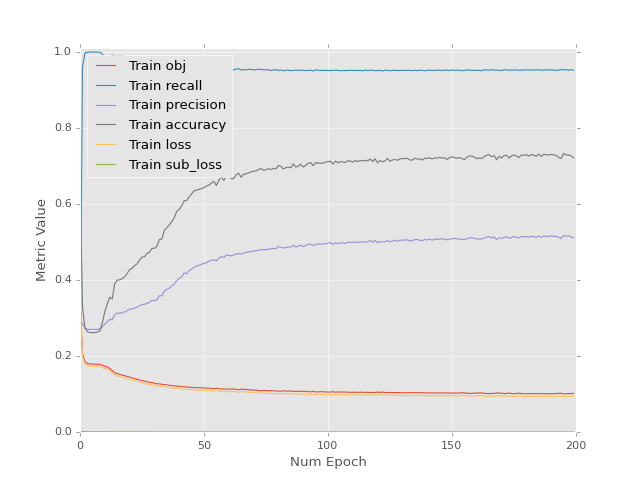

<IPython.core.display.Javascript object>


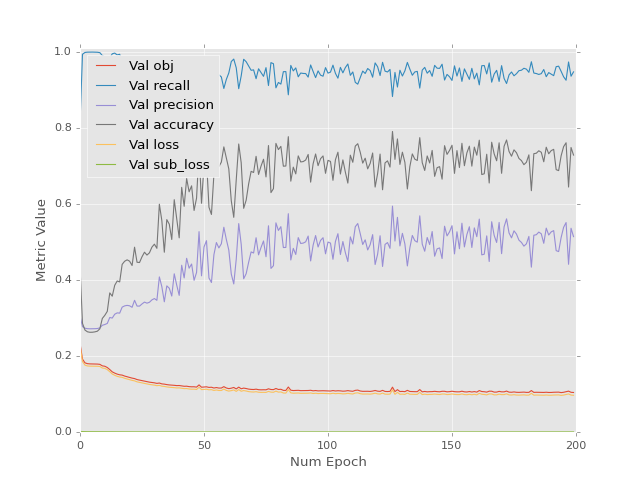

<IPython.core.display.Javascript object>


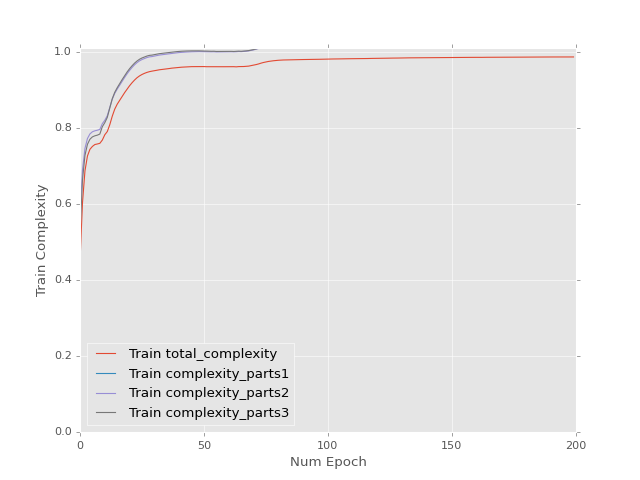

<IPython.core.display.Javascript object>


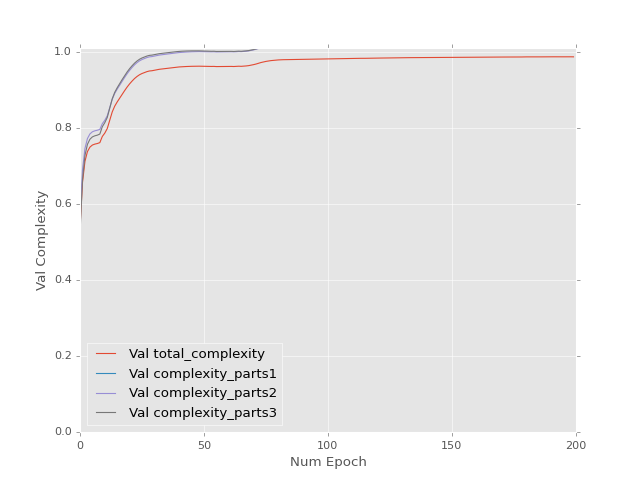

Epoch 1 of 200 took 6.876s


/home/apanin/anaconda/lib/python2.7/site-packages/matplotlib/backends/backend_webagg_core.py:210: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  buff.shape = (renderer.height, renderer.width)


Epoch 2 of 200 took 6.065s
Epoch 3 of 200 took 6.051s
Epoch 4 of 200 took 6.616s
Epoch 5 of 200 took 6.575s
Epoch 6 of 200 took 6.303s
Epoch 7 of 200 took 6.446s
Epoch 8 of 200 took 6.486s
Epoch 9 of 200 took 6.384s
Epoch 10 of 200 took 6.470s
Epoch 11 of 200 took 6.449s
Epoch 12 of 200 took 6.342s
Epoch 13 of 200 took 6.565s
Epoch 14 of 200 took 6.569s
Epoch 15 of 200 took 6.637s
Epoch 16 of 200 took 6.489s
Epoch 17 of 200 took 6.551s
Epoch 18 of 200 took 6.558s
Epoch 19 of 200 took 6.262s
Epoch 20 of 200 took 6.564s
Epoch 21 of 200 took 6.175s
Epoch 22 of 200 took 6.755s
Epoch 23 of 200 took 6.443s
Epoch 24 of 200 took 6.463s
Epoch 25 of 200 took 6.347s
Epoch 26 of 200 took 6.031s
Epoch 27 of 200 took 6.015s
Epoch 28 of 200 took 6.351s
Epoch 29 of 200 took 6.378s
Epoch 30 of 200 took 6.752s
Epoch 31 of 200 took 6.600s
Epoch 32 of 200 took 6.422s
Epoch 33 of 200 took 6.718s
Epoch 34 of 200 took 6.375s
Epoch 35 of 200 took 6.296s
Epoch 36 of 200 took 6.509s
Epoch 37 of 200 took 6.427s


In [16]:
learn(network,
      X_y,
      watches=['obj',
               'recall',
               'precision',
               'accuracy',
               'loss',
               'sub_loss',
               'total_complexity',
               'complexity_parts'],
      num_epochs=200,
      batch_size=50)

In [22]:
network.save('../weights/', 'digits_pretrained')

In [18]:
shareds = []

for shared in network.opt_shareds:
    shareds.append(shared.get_value())

In [21]:
np.savez(os.path.join('../weights/digits_params', 'shareds'), *shareds)

In [5]:
with np.load('../weights/digits_params/shareds.npz') as f:
    shareds = [f['arr_%d' % i] for i in range(len(f.files))]

<IPython.core.display.Javascript object>


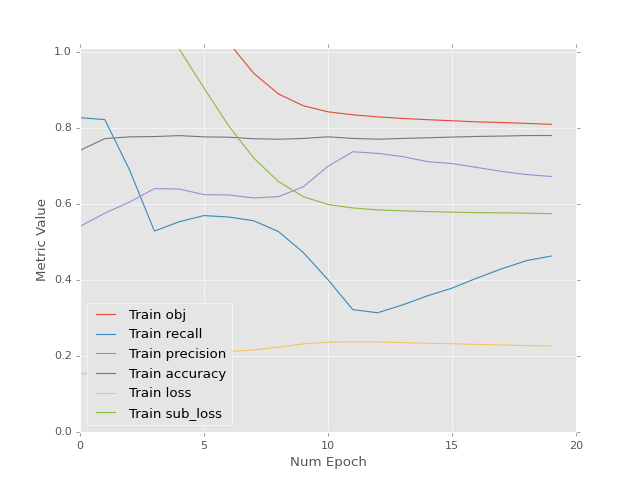

<IPython.core.display.Javascript object>


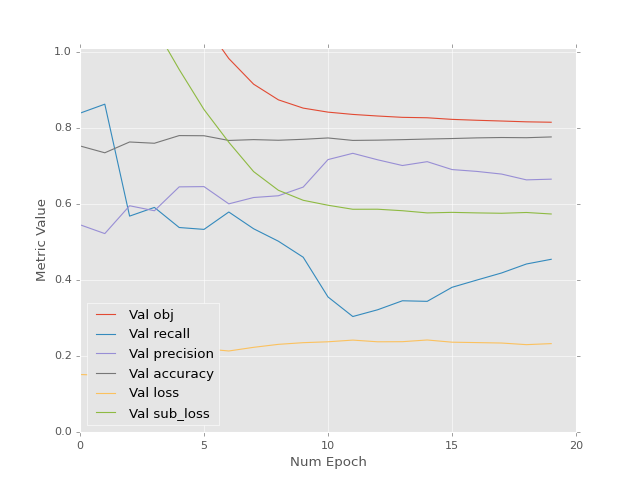

<IPython.core.display.Javascript object>


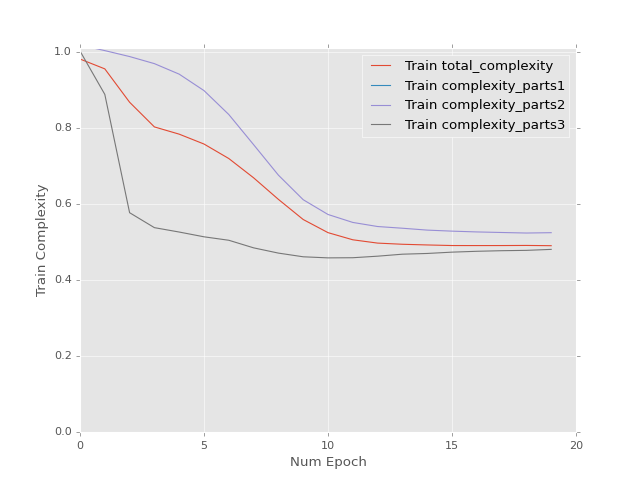

<IPython.core.display.Javascript object>


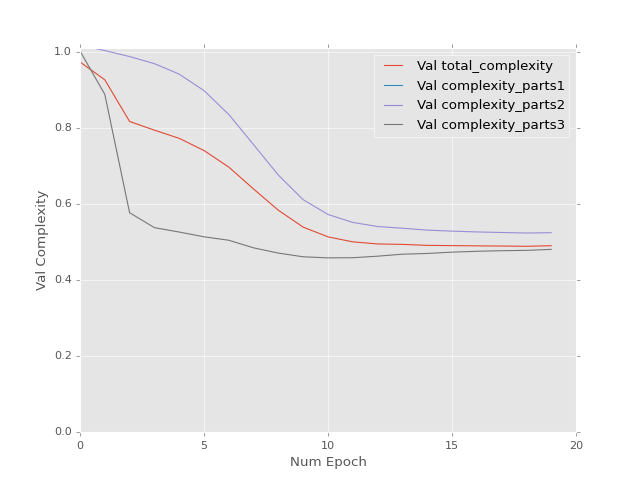

Epoch 1 of 20 took 5.611s
Epoch 2 of 20 took 6.112s
Epoch 3 of 20 took 5.996s
Epoch 4 of 20 took 6.059s
Epoch 5 of 20 took 5.919s
Epoch 6 of 20 took 5.888s
Epoch 7 of 20 took 6.043s
Epoch 8 of 20 took 6.062s
Epoch 9 of 20 took 6.095s
Epoch 10 of 20 took 5.918s
Epoch 11 of 20 took 5.898s
Epoch 12 of 20 took 6.054s
Epoch 13 of 20 took 6.085s
Epoch 14 of 20 took 5.893s
Epoch 15 of 20 took 5.720s
Epoch 16 of 20 took 5.805s
Epoch 17 of 20 took 5.982s
Epoch 18 of 20 took 5.916s
Epoch 19 of 20 took 6.006s
Epoch 20 of 20 took 6.006s


<IPython.core.display.Javascript object>


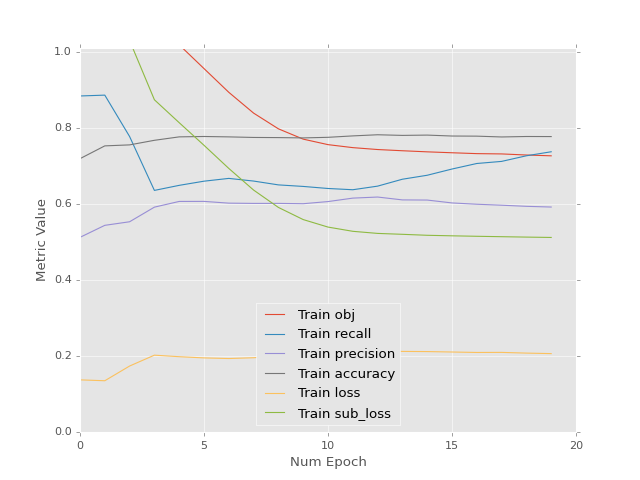

<IPython.core.display.Javascript object>


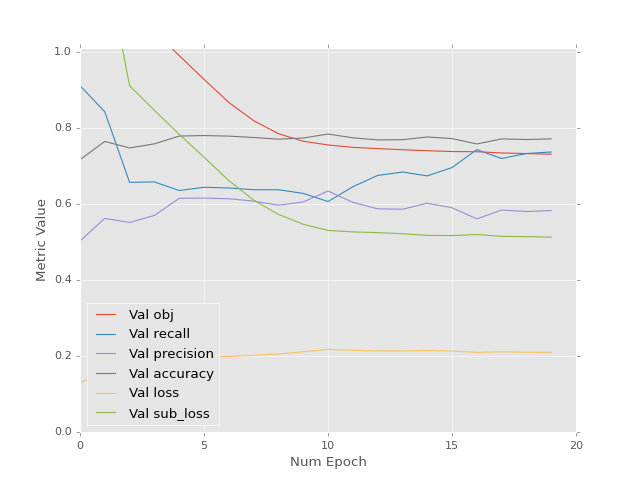

<IPython.core.display.Javascript object>


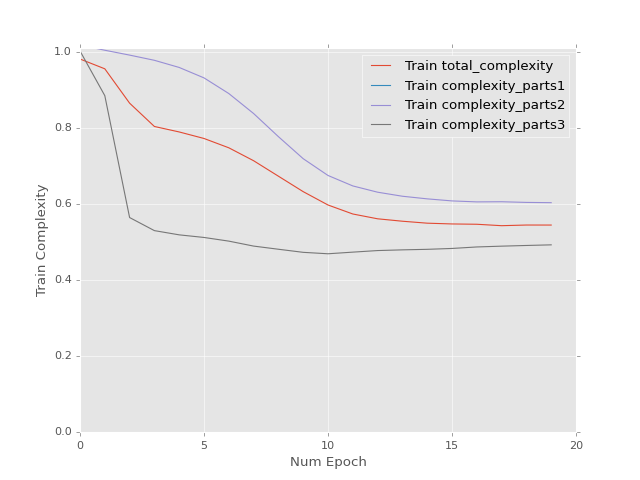

<IPython.core.display.Javascript object>


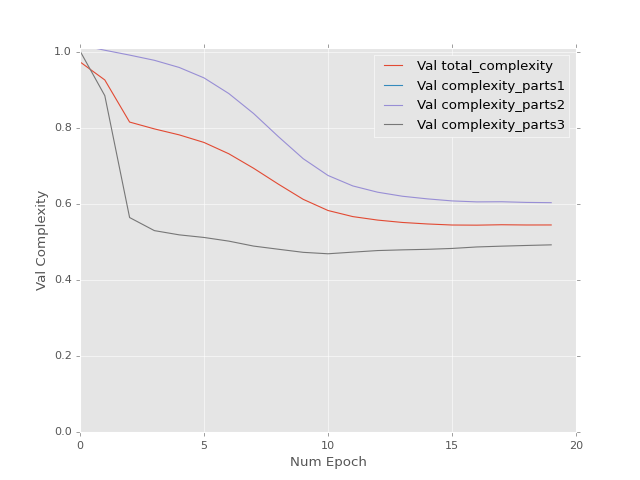

Epoch 1 of 20 took 5.824s
Epoch 2 of 20 took 5.656s
Epoch 3 of 20 took 5.931s
Epoch 4 of 20 took 6.022s
Epoch 5 of 20 took 5.695s
Epoch 6 of 20 took 5.999s
Epoch 7 of 20 took 5.885s
Epoch 8 of 20 took 5.664s
Epoch 9 of 20 took 6.141s
Epoch 10 of 20 took 6.220s
Epoch 11 of 20 took 6.332s
Epoch 12 of 20 took 5.832s
Epoch 13 of 20 took 6.050s
Epoch 14 of 20 took 6.225s
Epoch 15 of 20 took 6.104s
Epoch 16 of 20 took 5.969s
Epoch 17 of 20 took 6.166s
Epoch 18 of 20 took 6.035s
Epoch 19 of 20 took 6.075s
Epoch 20 of 20 took 6.083s


<IPython.core.display.Javascript object>


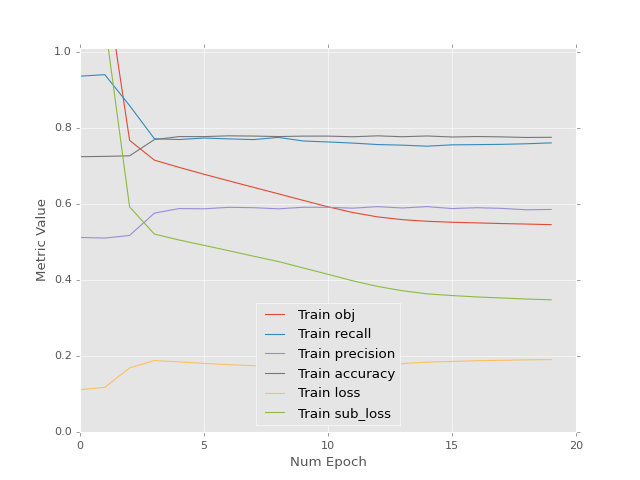

<IPython.core.display.Javascript object>


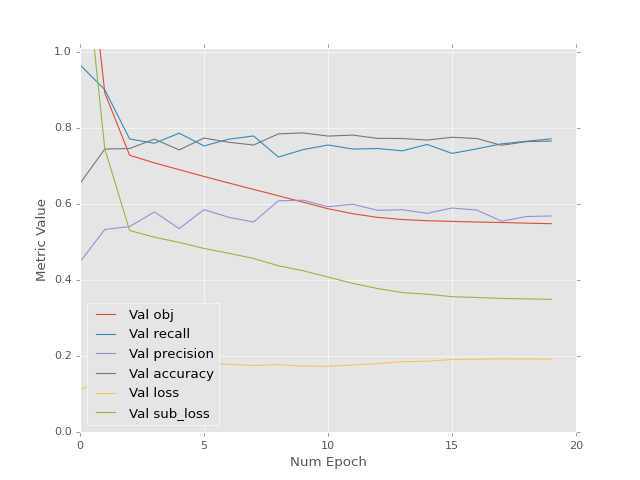

<IPython.core.display.Javascript object>


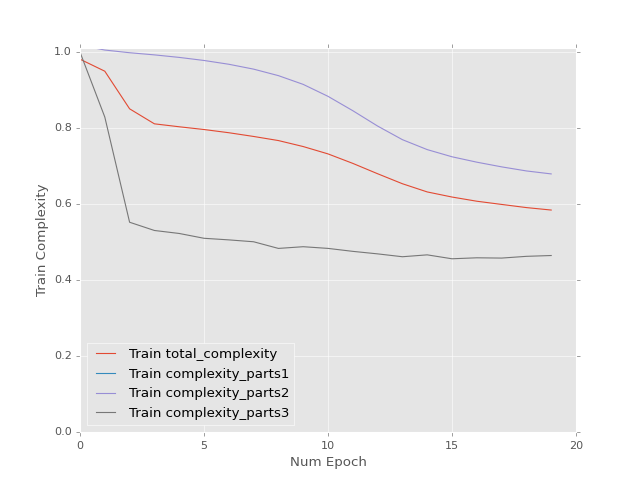

<IPython.core.display.Javascript object>


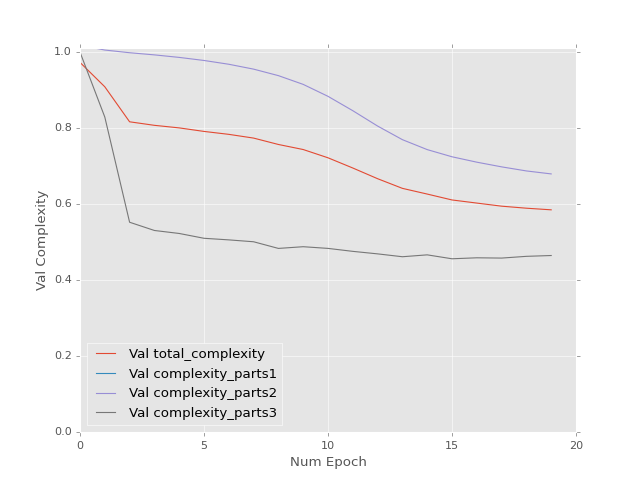

Epoch 1 of 20 took 5.862s
Epoch 2 of 20 took 6.169s
Epoch 3 of 20 took 5.992s
Epoch 4 of 20 took 5.859s
Epoch 5 of 20 took 5.999s
Epoch 6 of 20 took 5.884s
Epoch 7 of 20 took 6.090s
Epoch 8 of 20 took 6.063s
Epoch 9 of 20 took 6.091s
Epoch 10 of 20 took 6.087s
Epoch 11 of 20 took 6.103s
Epoch 12 of 20 took 6.271s
Epoch 13 of 20 took 5.853s
Epoch 14 of 20 took 5.986s
Epoch 15 of 20 took 6.199s
Epoch 16 of 20 took 6.051s
Epoch 17 of 20 took 5.995s
Epoch 18 of 20 took 6.064s
Epoch 19 of 20 took 6.188s
Epoch 20 of 20 took 6.054s


<IPython.core.display.Javascript object>


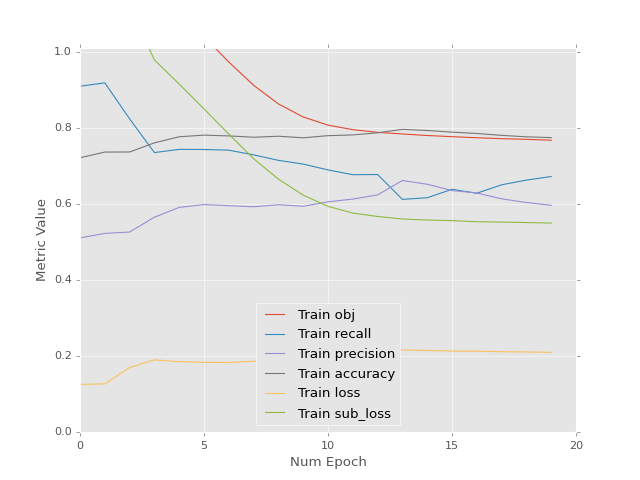

<IPython.core.display.Javascript object>


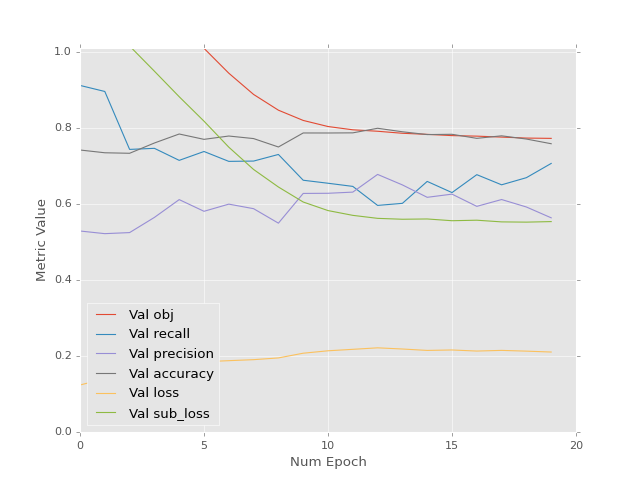

<IPython.core.display.Javascript object>


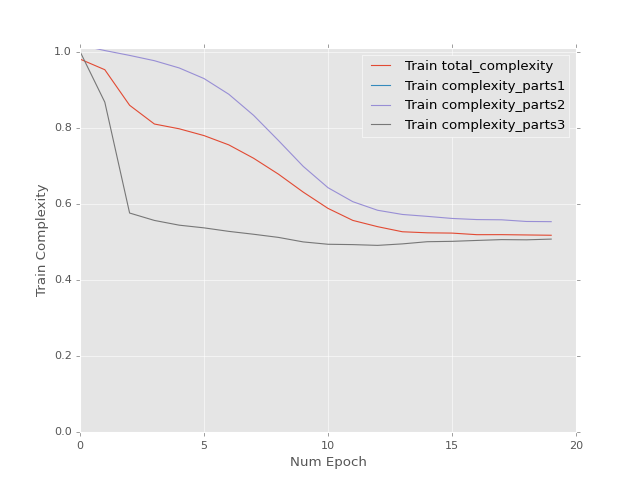

<IPython.core.display.Javascript object>


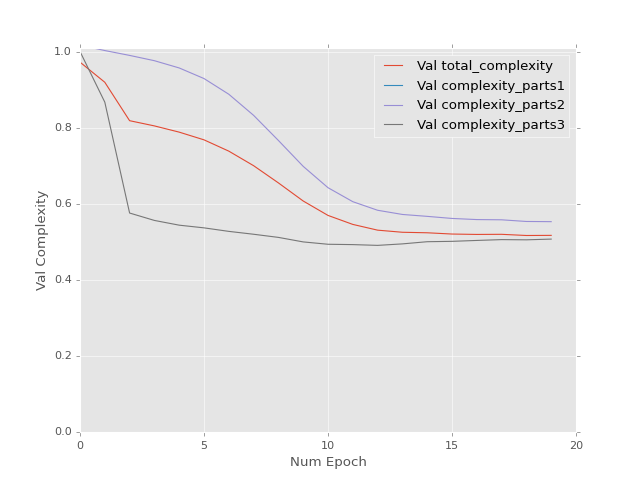

Epoch 1 of 20 took 6.011s
Epoch 2 of 20 took 6.073s
Epoch 3 of 20 took 6.192s
Epoch 4 of 20 took 6.011s
Epoch 5 of 20 took 6.093s
Epoch 6 of 20 took 5.926s
Epoch 7 of 20 took 6.063s
Epoch 8 of 20 took 5.941s
Epoch 9 of 20 took 6.135s
Epoch 10 of 20 took 5.884s
Epoch 11 of 20 took 6.319s
Epoch 12 of 20 took 5.967s
Epoch 13 of 20 took 5.908s
Epoch 14 of 20 took 5.994s
Epoch 15 of 20 took 6.150s
Epoch 16 of 20 took 6.050s
Epoch 17 of 20 took 6.029s
Epoch 18 of 20 took 6.122s
Epoch 19 of 20 took 6.015s
Epoch 20 of 20 took 5.989s


<IPython.core.display.Javascript object>


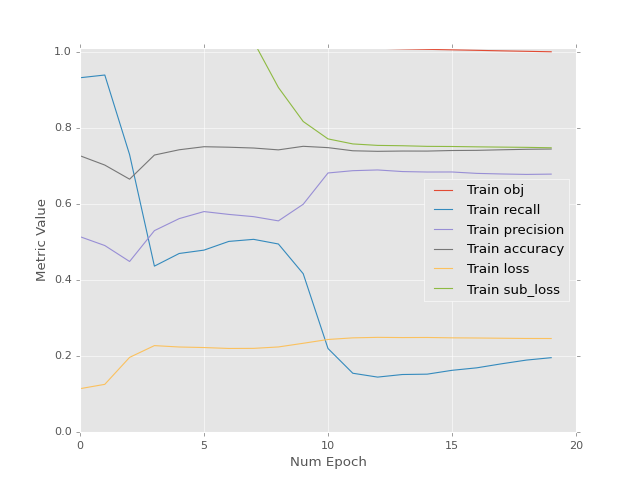

<IPython.core.display.Javascript object>


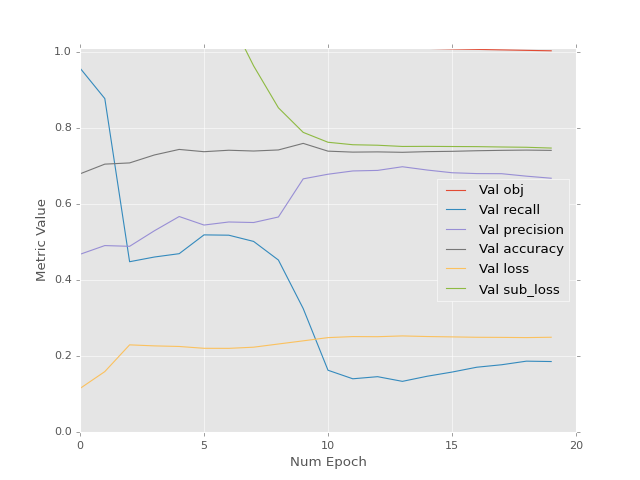

<IPython.core.display.Javascript object>


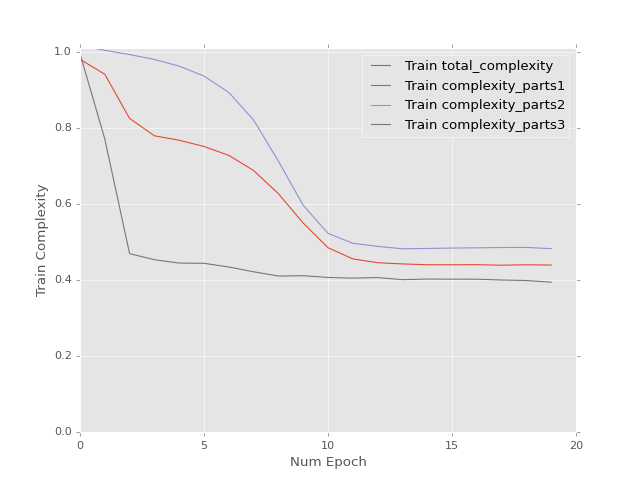

<IPython.core.display.Javascript object>


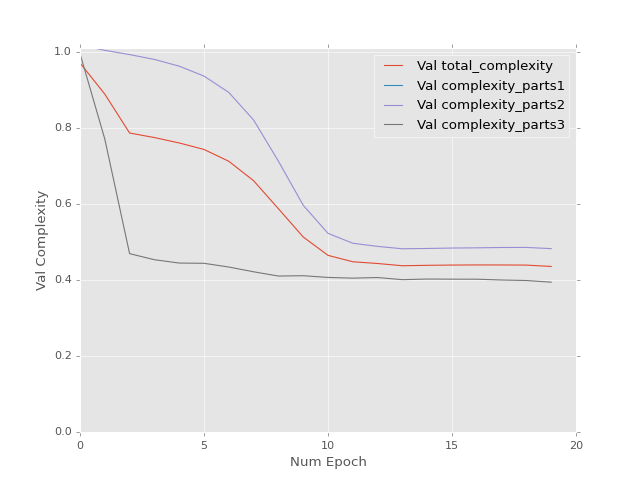

Epoch 1 of 20 took 6.083s
Epoch 2 of 20 took 5.718s
Epoch 3 of 20 took 6.036s
Epoch 4 of 20 took 5.910s
Epoch 5 of 20 took 6.260s
Epoch 6 of 20 took 6.025s
Epoch 7 of 20 took 6.343s
Epoch 8 of 20 took 5.870s
Epoch 9 of 20 took 5.944s
Epoch 10 of 20 took 6.111s
Epoch 11 of 20 took 5.910s
Epoch 12 of 20 took 5.724s
Epoch 13 of 20 took 5.875s
Epoch 14 of 20 took 6.118s
Epoch 15 of 20 took 6.050s
Epoch 16 of 20 took 5.943s
Epoch 17 of 20 took 5.919s
Epoch 18 of 20 took 5.850s
Epoch 19 of 20 took 5.990s
Epoch 20 of 20 took 5.825s


<IPython.core.display.Javascript object>


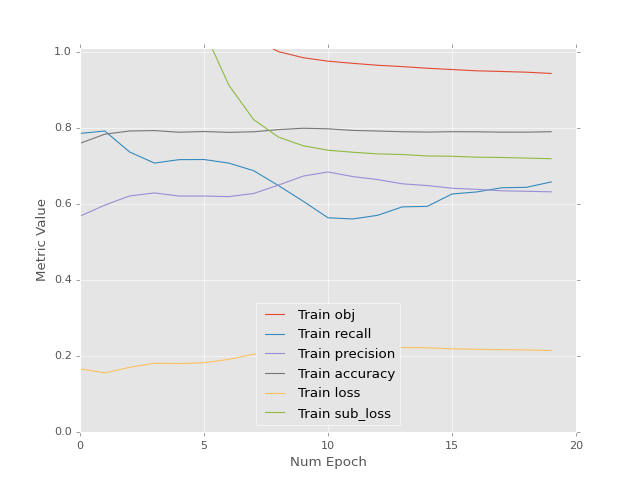

<IPython.core.display.Javascript object>


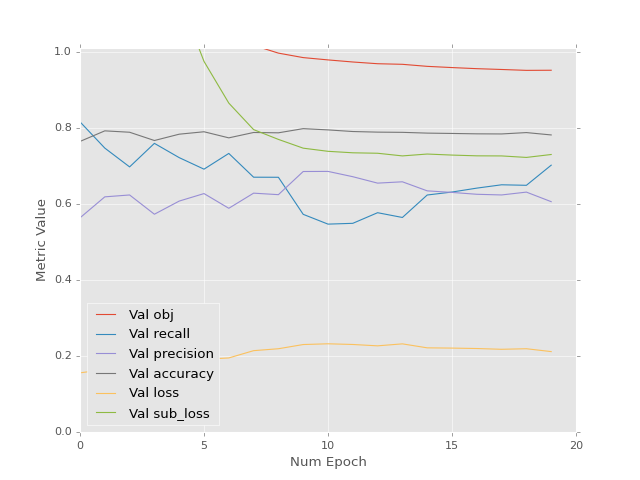

<IPython.core.display.Javascript object>


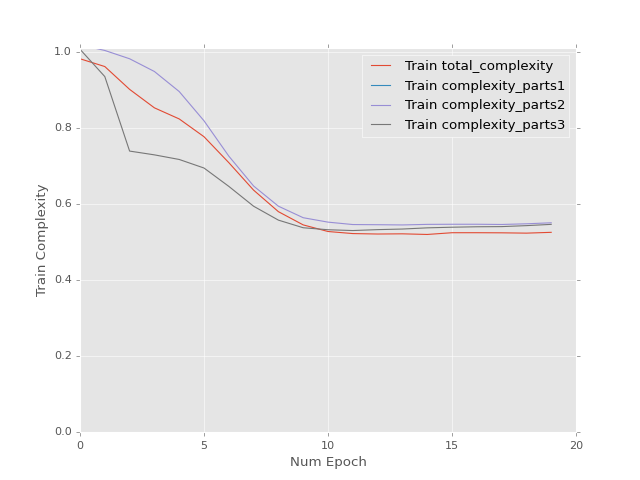

<IPython.core.display.Javascript object>


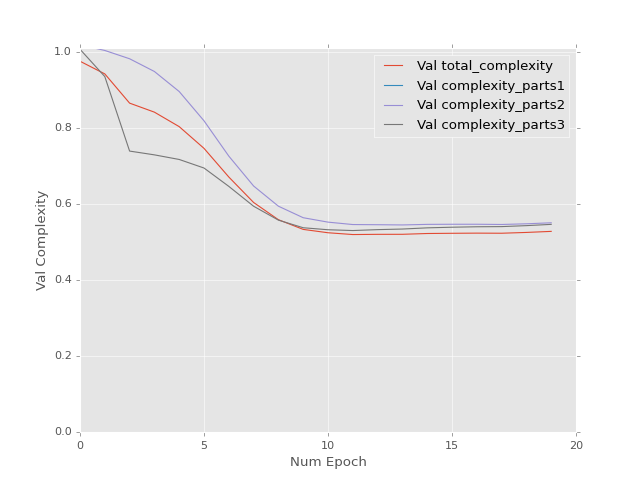

Epoch 1 of 20 took 6.287s
Epoch 2 of 20 took 5.955s
Epoch 3 of 20 took 6.000s
Epoch 4 of 20 took 5.823s
Epoch 5 of 20 took 6.062s
Epoch 6 of 20 took 6.202s
Epoch 7 of 20 took 5.963s
Epoch 8 of 20 took 6.116s
Epoch 9 of 20 took 6.101s
Epoch 10 of 20 took 5.841s
Epoch 11 of 20 took 5.819s
Epoch 12 of 20 took 5.975s
Epoch 13 of 20 took 6.136s
Epoch 14 of 20 took 6.186s
Epoch 15 of 20 took 5.974s
Epoch 16 of 20 took 5.736s
Epoch 17 of 20 took 6.113s
Epoch 18 of 20 took 6.134s
Epoch 19 of 20 took 5.831s
Epoch 20 of 20 took 6.025s


<IPython.core.display.Javascript object>


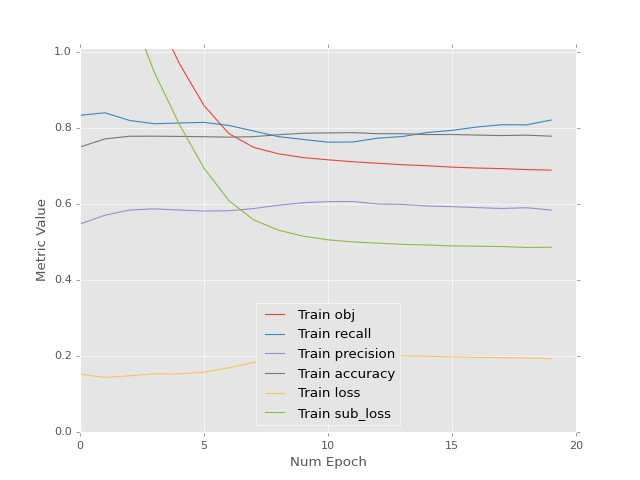

<IPython.core.display.Javascript object>


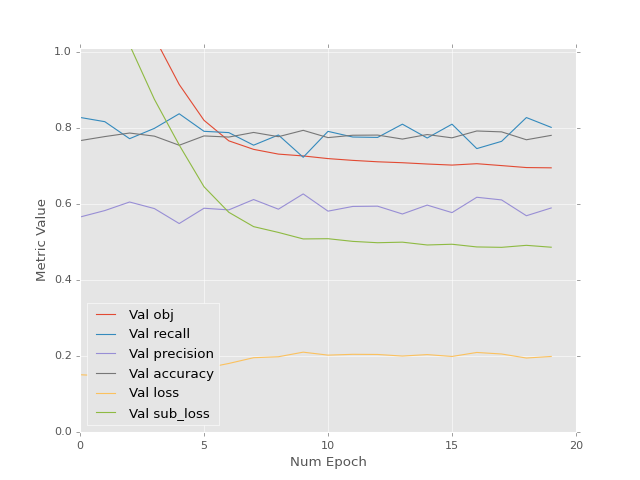

<IPython.core.display.Javascript object>


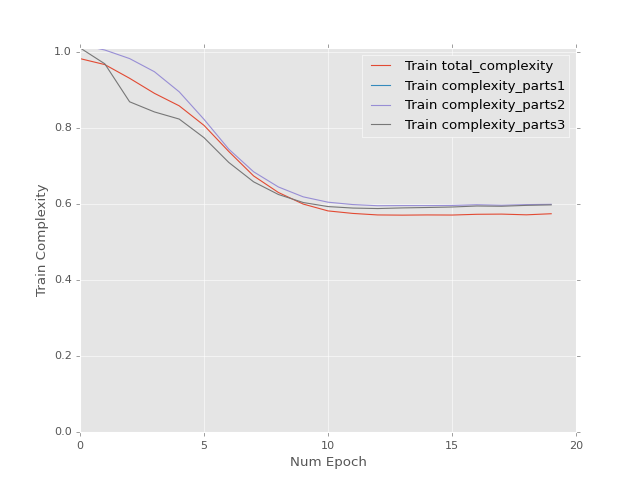

<IPython.core.display.Javascript object>


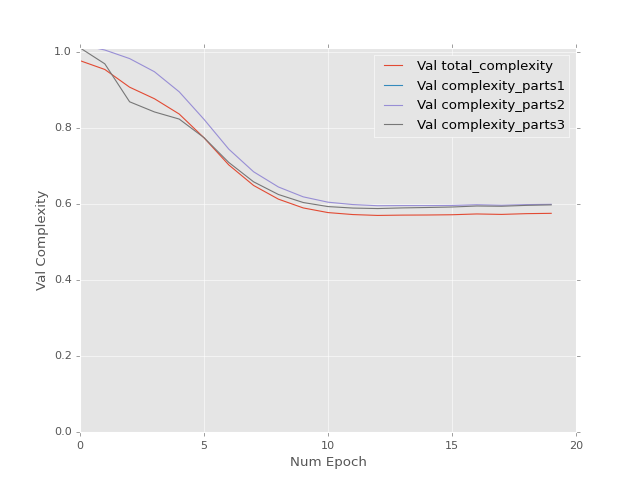

Epoch 1 of 20 took 6.078s
Epoch 2 of 20 took 5.990s
Epoch 3 of 20 took 5.852s
Epoch 4 of 20 took 6.172s
Epoch 5 of 20 took 6.161s
Epoch 6 of 20 took 6.073s
Epoch 7 of 20 took 5.901s
Epoch 8 of 20 took 6.124s
Epoch 9 of 20 took 6.122s
Epoch 10 of 20 took 5.932s
Epoch 11 of 20 took 5.947s
Epoch 12 of 20 took 5.918s
Epoch 13 of 20 took 5.782s
Epoch 14 of 20 took 5.604s
Epoch 15 of 20 took 6.016s
Epoch 16 of 20 took 5.640s
Epoch 17 of 20 took 5.821s
Epoch 18 of 20 took 5.968s
Epoch 19 of 20 took 5.736s
Epoch 20 of 20 took 6.160s


<IPython.core.display.Javascript object>


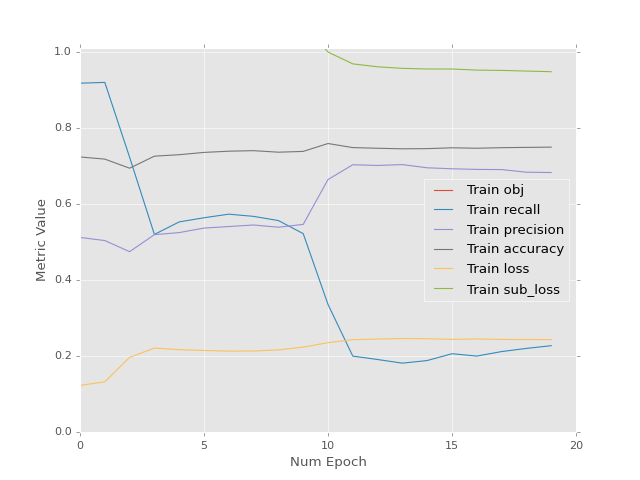

<IPython.core.display.Javascript object>


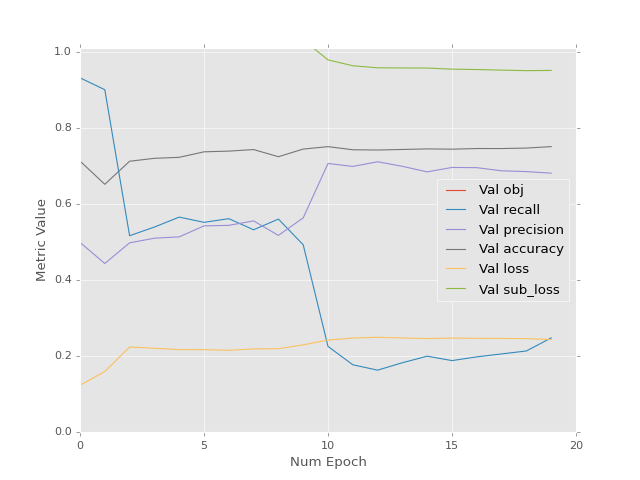

<IPython.core.display.Javascript object>


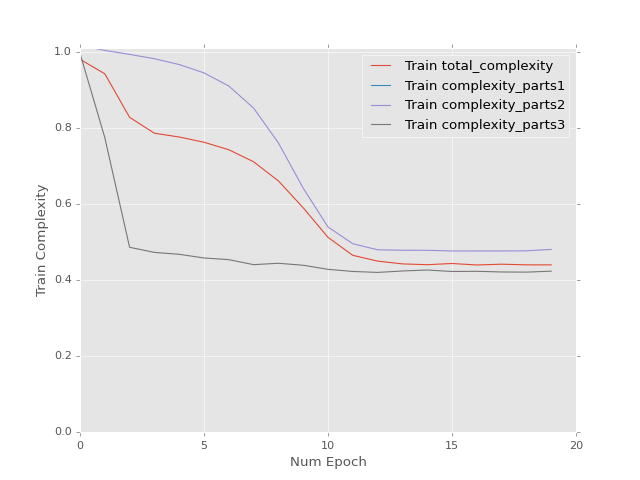

<IPython.core.display.Javascript object>


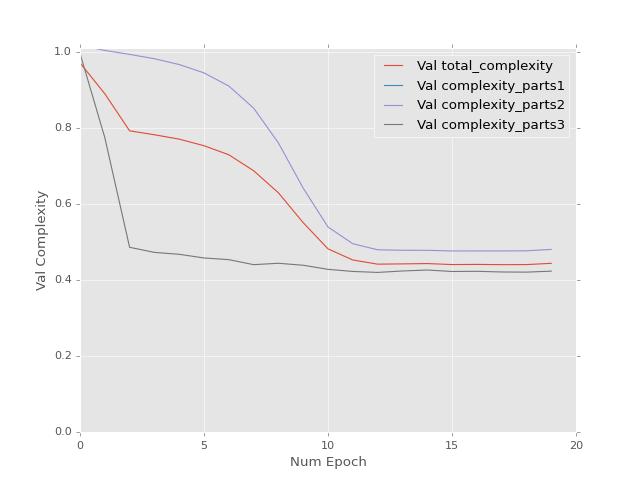

Epoch 1 of 20 took 6.075s
Epoch 2 of 20 took 6.058s
Epoch 3 of 20 took 6.094s
Epoch 4 of 20 took 5.765s
Epoch 5 of 20 took 5.922s
Epoch 6 of 20 took 5.991s
Epoch 7 of 20 took 5.794s
Epoch 8 of 20 took 5.995s
Epoch 9 of 20 took 5.951s
Epoch 10 of 20 took 6.275s
Epoch 11 of 20 took 6.188s
Epoch 12 of 20 took 5.800s
Epoch 13 of 20 took 6.157s
Epoch 14 of 20 took 5.823s
Epoch 15 of 20 took 6.098s
Epoch 16 of 20 took 6.196s
Epoch 17 of 20 took 5.998s
Epoch 18 of 20 took 6.205s
Epoch 19 of 20 took 5.758s
Epoch 20 of 20 took 6.121s


<IPython.core.display.Javascript object>


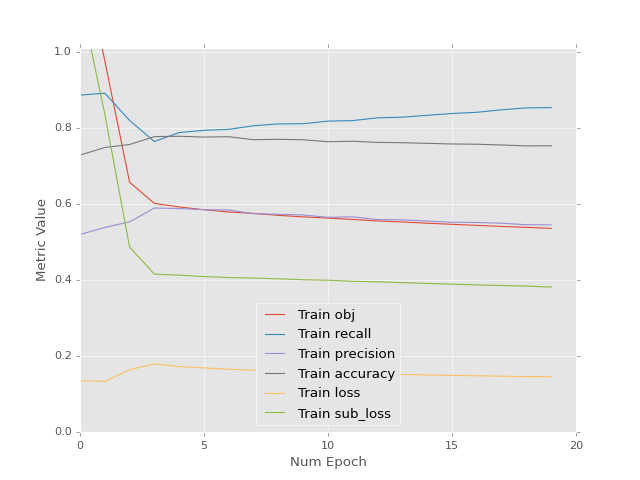

<IPython.core.display.Javascript object>


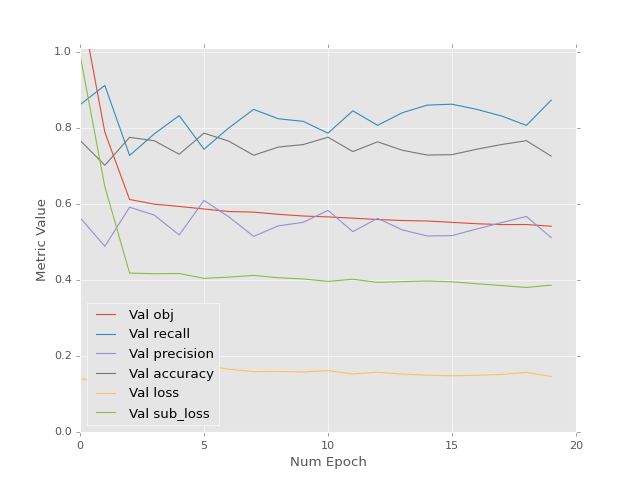

<IPython.core.display.Javascript object>


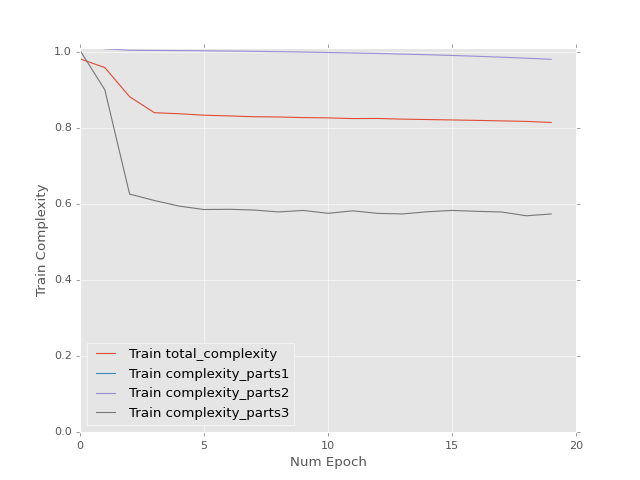

<IPython.core.display.Javascript object>


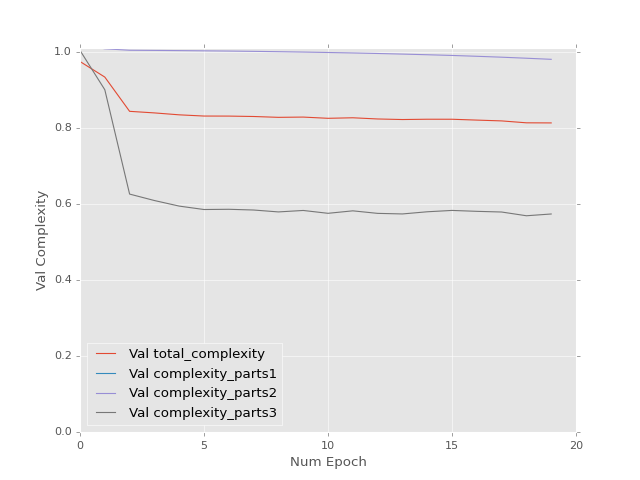

Epoch 1 of 20 took 5.765s
Epoch 2 of 20 took 5.995s
Epoch 3 of 20 took 6.246s
Epoch 4 of 20 took 5.906s
Epoch 5 of 20 took 5.604s
Epoch 6 of 20 took 5.867s
Epoch 7 of 20 took 6.115s
Epoch 8 of 20 took 5.639s
Epoch 9 of 20 took 5.955s
Epoch 10 of 20 took 6.008s
Epoch 11 of 20 took 5.760s
Epoch 12 of 20 took 5.588s
Epoch 13 of 20 took 6.042s
Epoch 14 of 20 took 6.036s
Epoch 15 of 20 took 5.585s
Epoch 16 of 20 took 5.966s
Epoch 17 of 20 took 5.908s
Epoch 18 of 20 took 5.570s
Epoch 19 of 20 took 5.908s
Epoch 20 of 20 took 5.884s


<IPython.core.display.Javascript object>


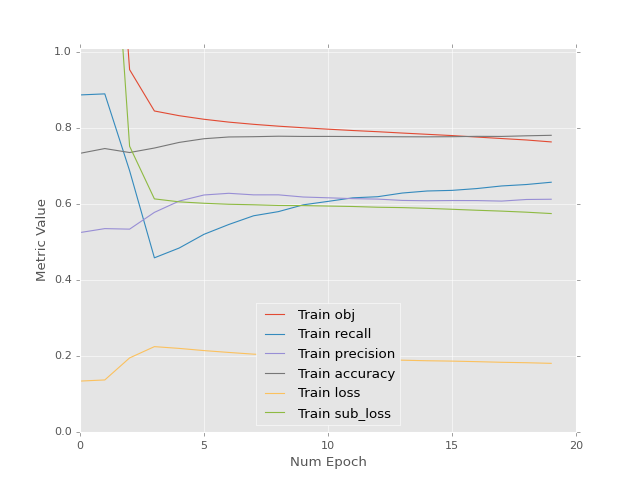

<IPython.core.display.Javascript object>


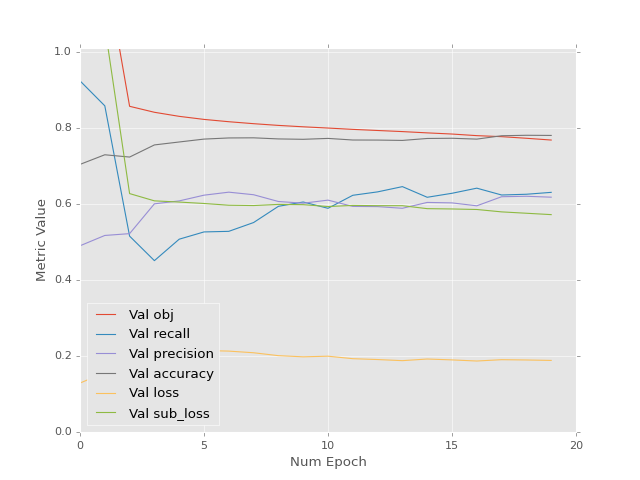

<IPython.core.display.Javascript object>


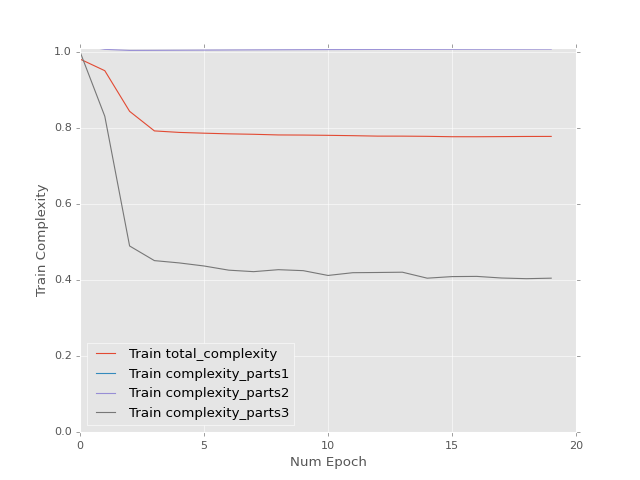

<IPython.core.display.Javascript object>


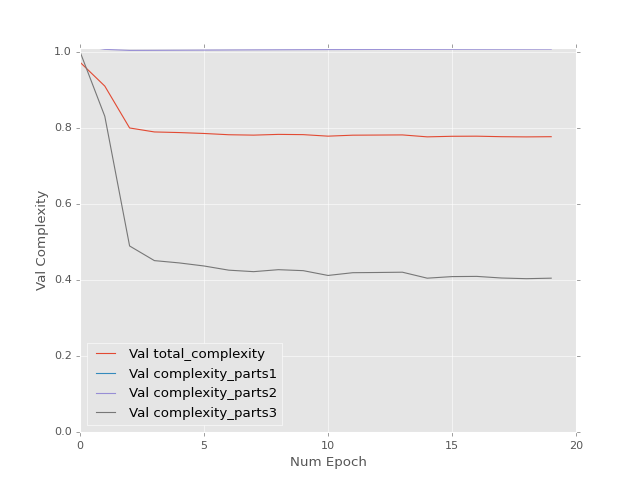

Epoch 1 of 20 took 6.120s
Epoch 2 of 20 took 5.761s
Epoch 3 of 20 took 6.099s
Epoch 4 of 20 took 6.005s
Epoch 5 of 20 took 5.974s
Epoch 6 of 20 took 5.797s
Epoch 7 of 20 took 5.848s
Epoch 8 of 20 took 5.944s
Epoch 9 of 20 took 6.042s
Epoch 10 of 20 took 5.790s
Epoch 11 of 20 took 6.378s
Epoch 12 of 20 took 5.837s
Epoch 13 of 20 took 5.818s
Epoch 14 of 20 took 6.078s
Epoch 15 of 20 took 5.808s
Epoch 16 of 20 took 6.141s
Epoch 17 of 20 took 6.081s
Epoch 18 of 20 took 6.059s
Epoch 19 of 20 took 6.063s
Epoch 20 of 20 took 6.162s


<IPython.core.display.Javascript object>


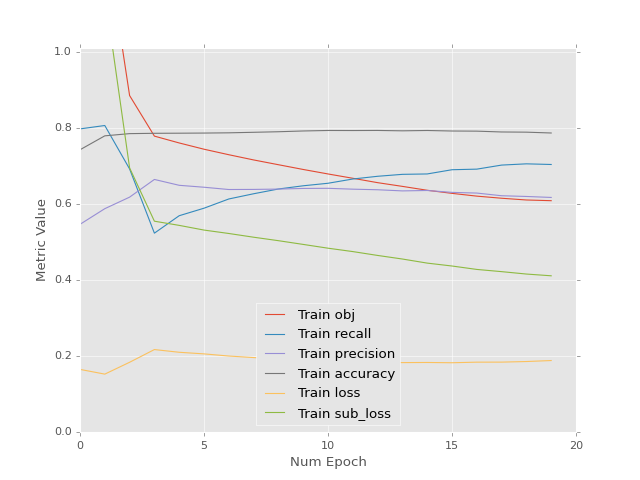

<IPython.core.display.Javascript object>


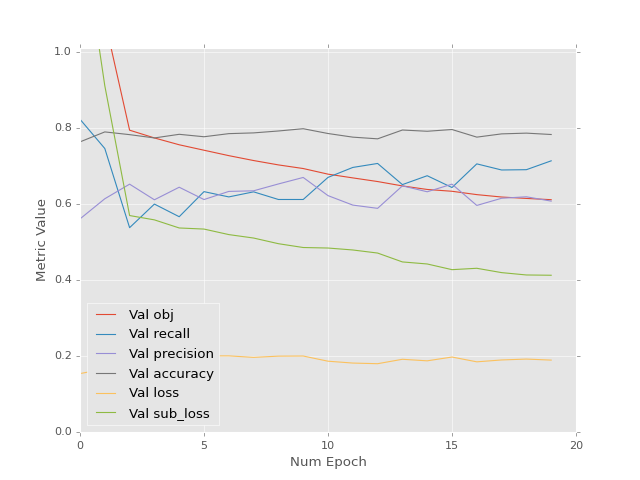

<IPython.core.display.Javascript object>


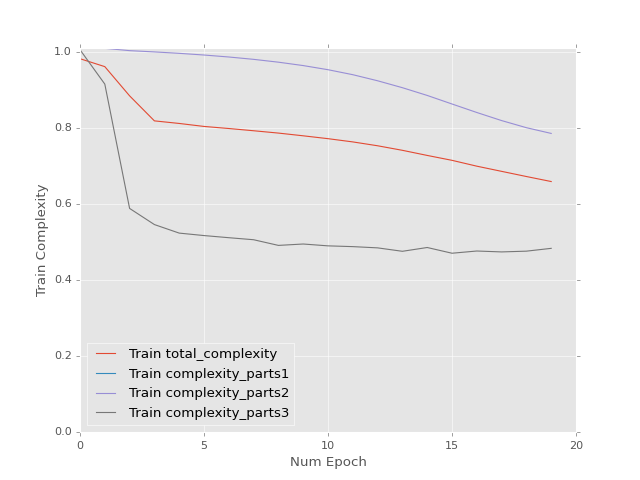

<IPython.core.display.Javascript object>


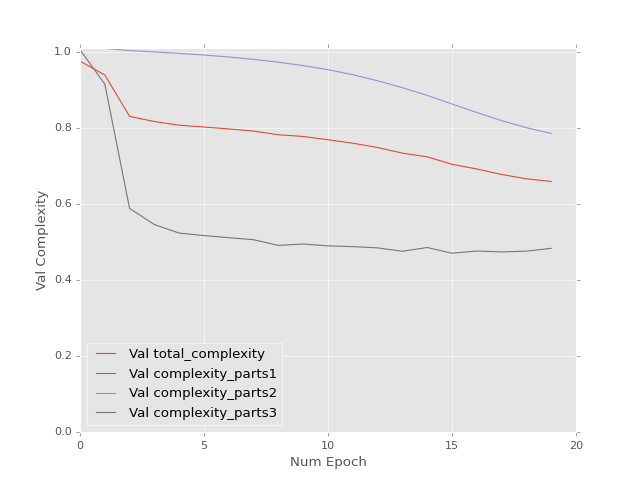

Epoch 1 of 20 took 6.187s
Epoch 2 of 20 took 6.159s
Epoch 3 of 20 took 5.905s
Epoch 4 of 20 took 6.115s
Epoch 5 of 20 took 6.050s
Epoch 6 of 20 took 6.055s
Epoch 7 of 20 took 6.171s
Epoch 8 of 20 took 5.901s
Epoch 9 of 20 took 5.969s
Epoch 10 of 20 took 6.010s
Epoch 11 of 20 took 6.230s
Epoch 12 of 20 took 6.049s
Epoch 13 of 20 took 5.945s
Epoch 14 of 20 took 6.069s
Epoch 15 of 20 took 6.068s
Epoch 16 of 20 took 6.059s
Epoch 17 of 20 took 6.079s
Epoch 18 of 20 took 5.998s
Epoch 19 of 20 took 5.790s
Epoch 20 of 20 took 5.782s


<IPython.core.display.Javascript object>


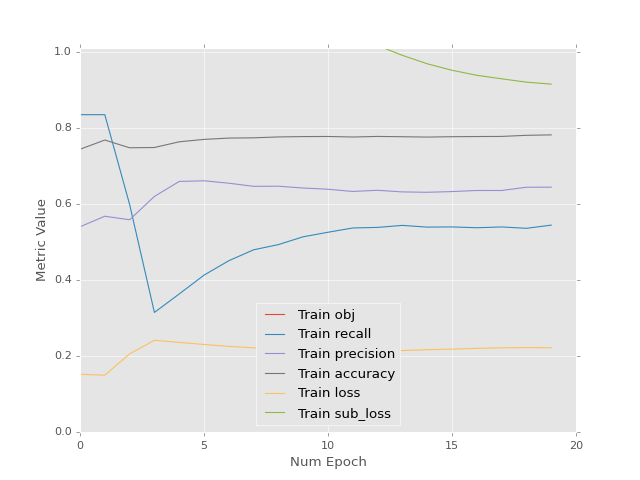

<IPython.core.display.Javascript object>


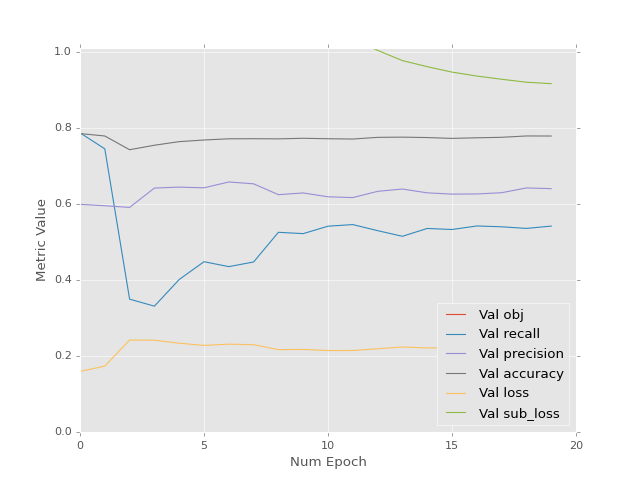

<IPython.core.display.Javascript object>


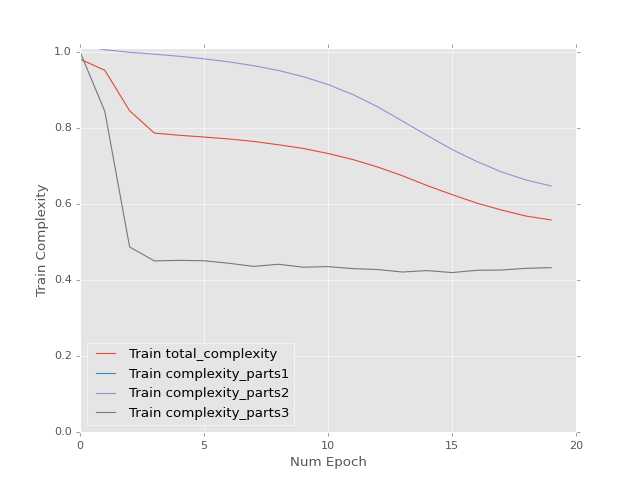

<IPython.core.display.Javascript object>


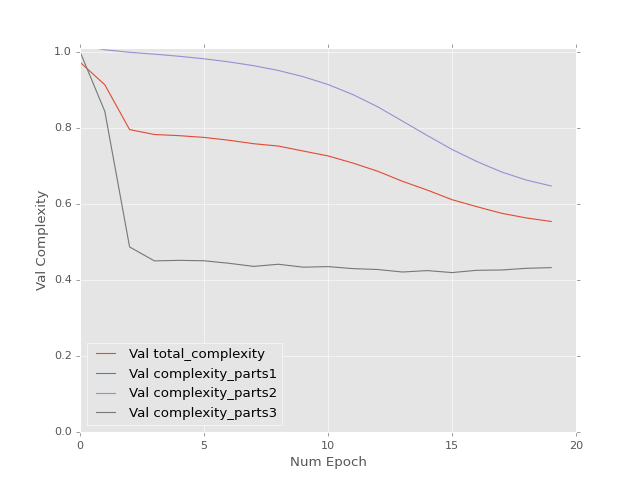

Epoch 1 of 20 took 5.797s
Epoch 2 of 20 took 5.857s
Epoch 3 of 20 took 6.058s
Epoch 4 of 20 took 5.833s
Epoch 5 of 20 took 5.965s
Epoch 6 of 20 took 5.700s
Epoch 7 of 20 took 6.172s
Epoch 8 of 20 took 6.093s
Epoch 9 of 20 took 6.090s
Epoch 10 of 20 took 6.411s
Epoch 11 of 20 took 5.858s
Epoch 12 of 20 took 5.766s
Epoch 13 of 20 took 6.181s
Epoch 14 of 20 took 6.198s
Epoch 15 of 20 took 6.139s
Epoch 16 of 20 took 5.619s
Epoch 17 of 20 took 6.132s
Epoch 18 of 20 took 6.048s
Epoch 19 of 20 took 5.620s
Epoch 20 of 20 took 6.072s


<IPython.core.display.Javascript object>


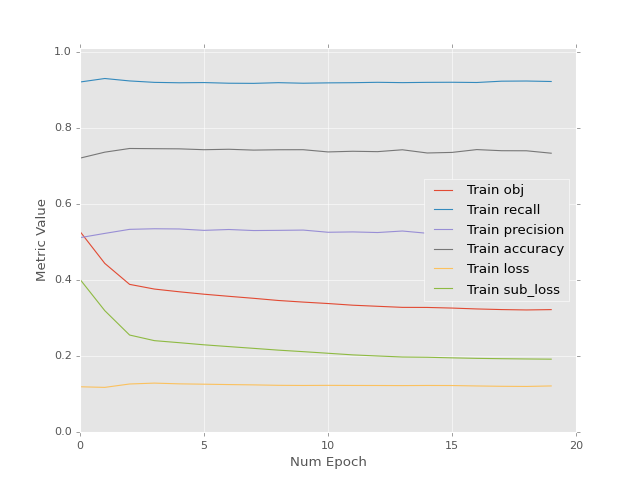

<IPython.core.display.Javascript object>


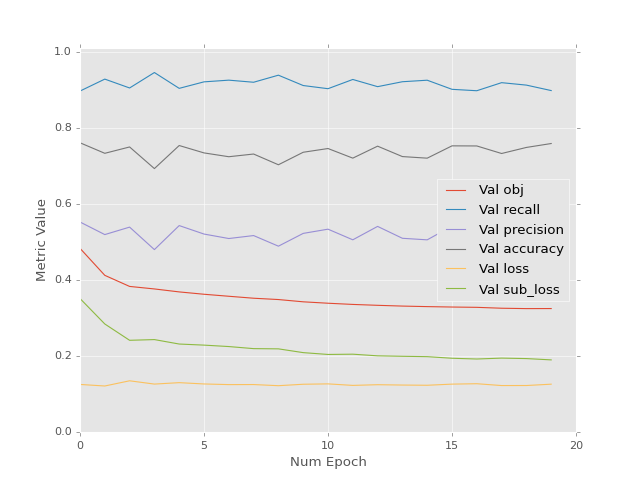

<IPython.core.display.Javascript object>


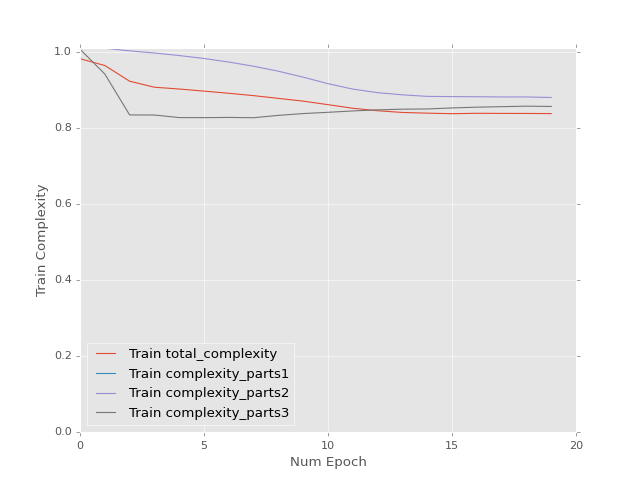

<IPython.core.display.Javascript object>


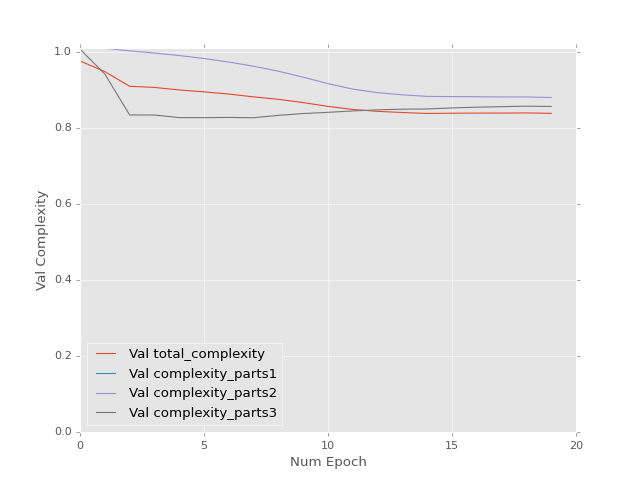

Epoch 1 of 20 took 6.154s
Epoch 2 of 20 took 5.880s
Epoch 3 of 20 took 5.805s
Epoch 4 of 20 took 5.859s
Epoch 5 of 20 took 6.089s
Epoch 6 of 20 took 6.168s
Epoch 7 of 20 took 6.004s
Epoch 8 of 20 took 5.893s
Epoch 9 of 20 took 6.113s
Epoch 10 of 20 took 5.696s
Epoch 11 of 20 took 5.837s
Epoch 12 of 20 took 5.948s
Epoch 13 of 20 took 5.700s
Epoch 14 of 20 took 5.597s
Epoch 15 of 20 took 5.736s
Epoch 16 of 20 took 5.995s
Epoch 17 of 20 took 6.200s
Epoch 18 of 20 took 6.012s
Epoch 19 of 20 took 5.858s
Epoch 20 of 20 took 6.040s


<IPython.core.display.Javascript object>


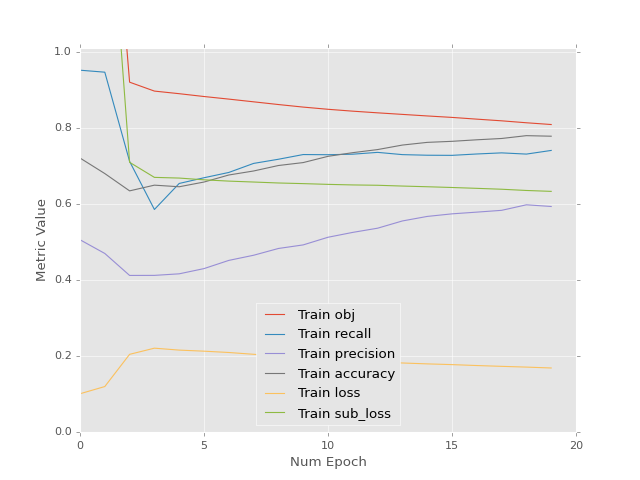

<IPython.core.display.Javascript object>


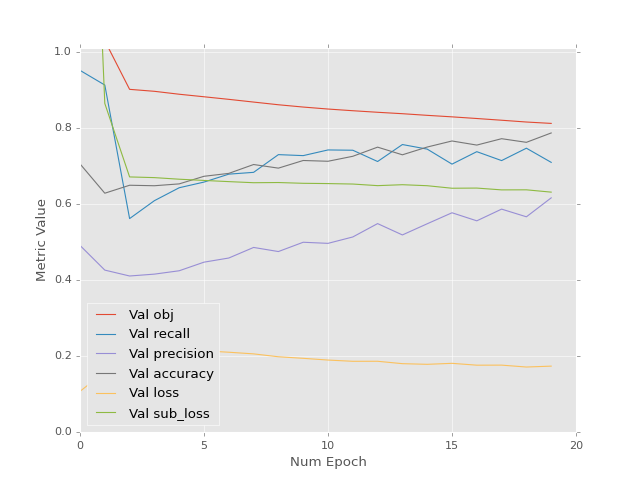

<IPython.core.display.Javascript object>


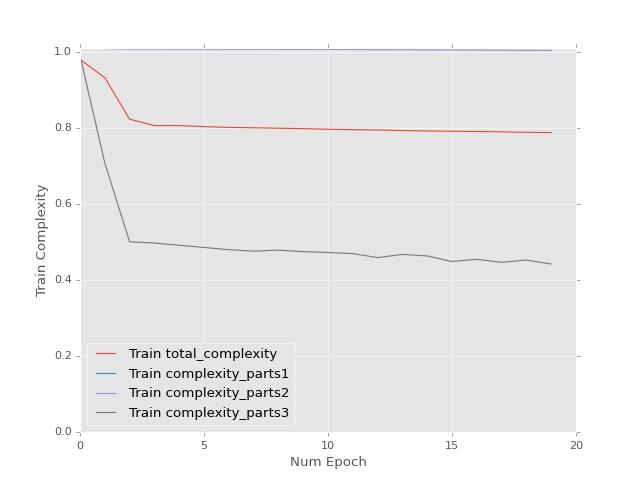

<IPython.core.display.Javascript object>


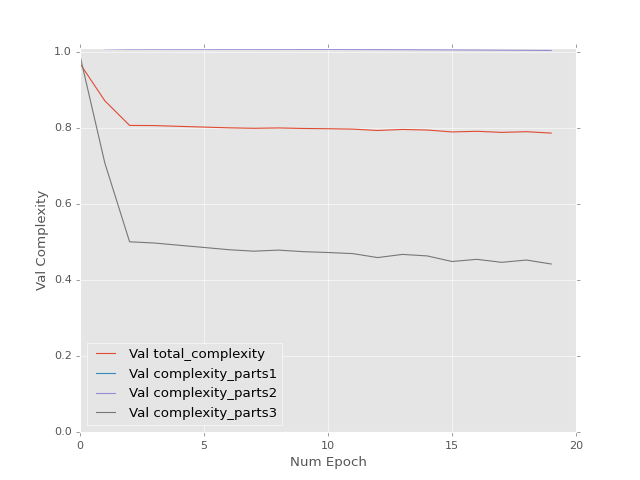

Epoch 1 of 20 took 5.673s
Epoch 2 of 20 took 5.803s
Epoch 3 of 20 took 5.666s
Epoch 4 of 20 took 5.850s
Epoch 5 of 20 took 5.937s
Epoch 6 of 20 took 6.013s
Epoch 7 of 20 took 6.121s
Epoch 8 of 20 took 6.212s
Epoch 9 of 20 took 5.890s
Epoch 10 of 20 took 5.790s
Epoch 11 of 20 took 5.984s
Epoch 12 of 20 took 5.685s
Epoch 13 of 20 took 6.041s
Epoch 14 of 20 took 5.883s
Epoch 15 of 20 took 5.913s
Epoch 16 of 20 took 6.126s
Epoch 17 of 20 took 5.887s
Epoch 18 of 20 took 6.188s
Epoch 19 of 20 took 6.573s
Epoch 20 of 20 took 5.910s


<IPython.core.display.Javascript object>


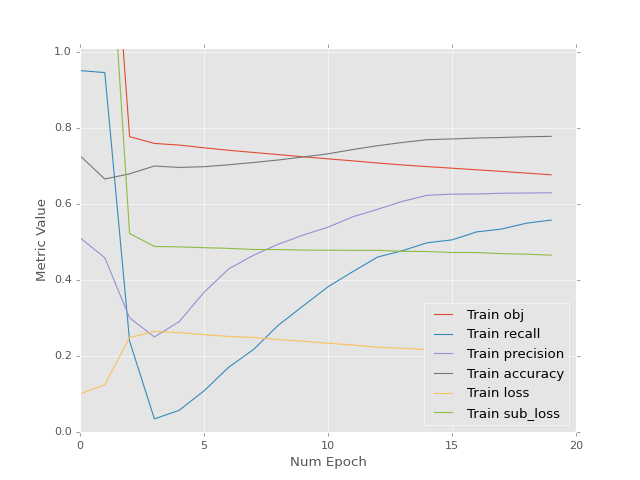

<IPython.core.display.Javascript object>


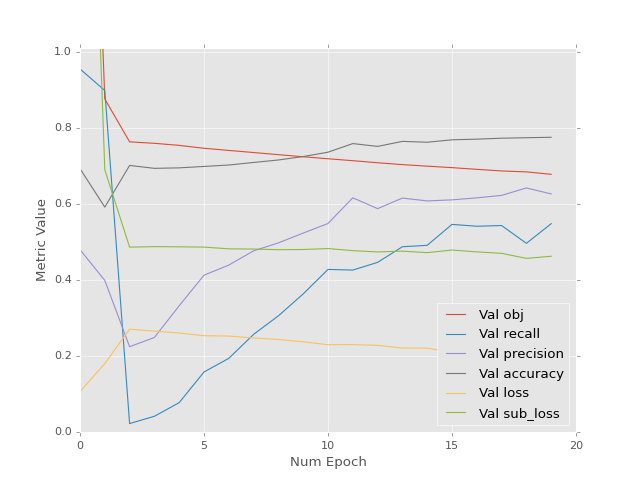

<IPython.core.display.Javascript object>


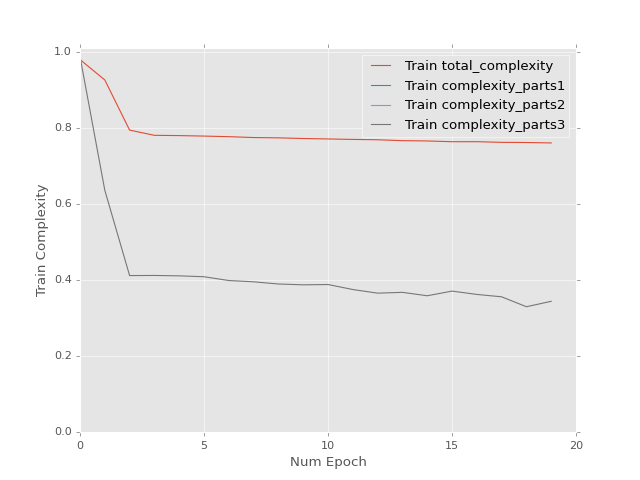

<IPython.core.display.Javascript object>


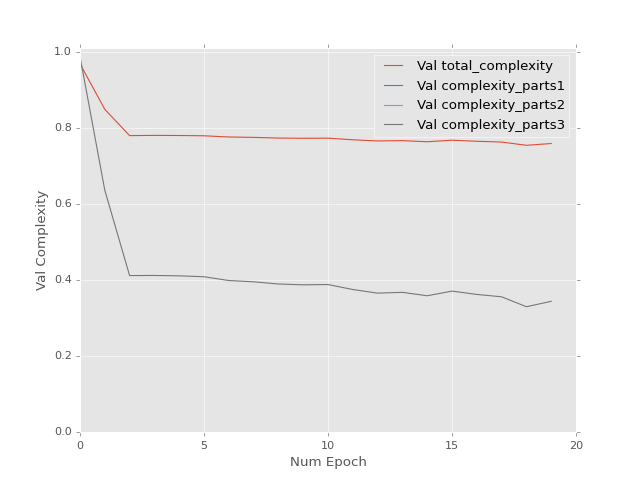

Epoch 1 of 20 took 6.134s
Epoch 2 of 20 took 5.634s
Epoch 3 of 20 took 6.037s
Epoch 4 of 20 took 5.608s
Epoch 5 of 20 took 5.830s
Epoch 6 of 20 took 6.038s
Epoch 7 of 20 took 5.677s
Epoch 8 of 20 took 5.593s
Epoch 9 of 20 took 5.593s
Epoch 10 of 20 took 5.854s
Epoch 11 of 20 took 5.717s
Epoch 12 of 20 took 5.872s
Epoch 13 of 20 took 5.962s
Epoch 14 of 20 took 6.048s
Epoch 15 of 20 took 6.444s
Epoch 16 of 20 took 5.826s
Epoch 17 of 20 took 5.808s
Epoch 18 of 20 took 5.597s
Epoch 19 of 20 took 5.665s
Epoch 20 of 20 took 6.237s


<IPython.core.display.Javascript object>


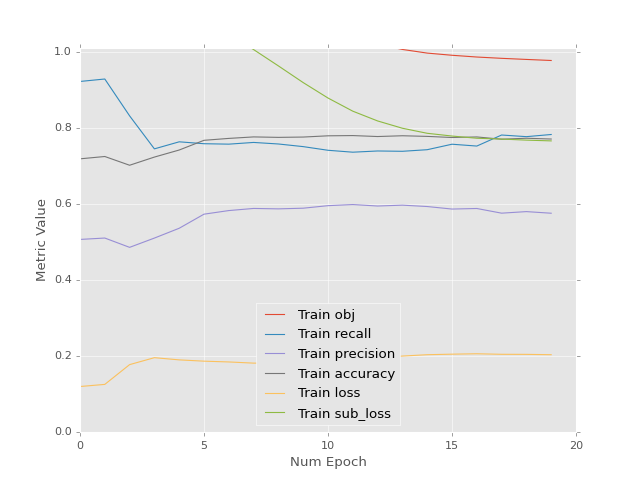

<IPython.core.display.Javascript object>


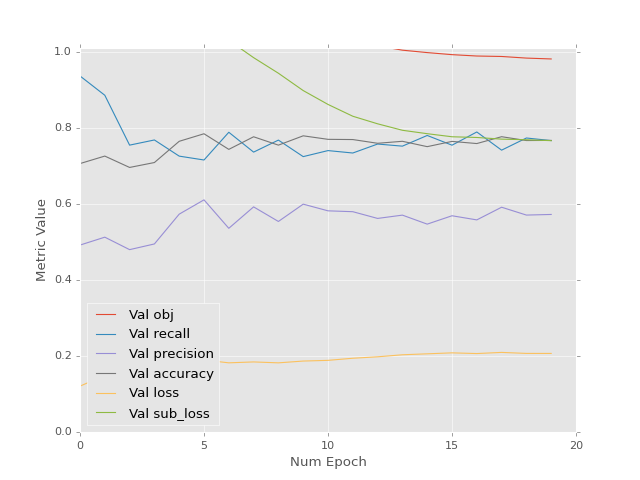

<IPython.core.display.Javascript object>


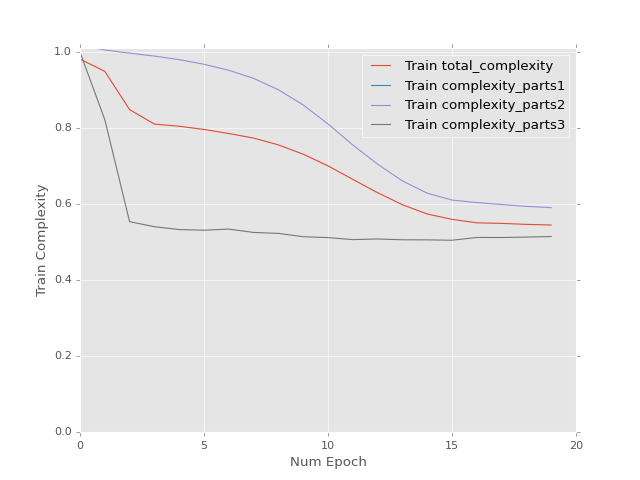

<IPython.core.display.Javascript object>


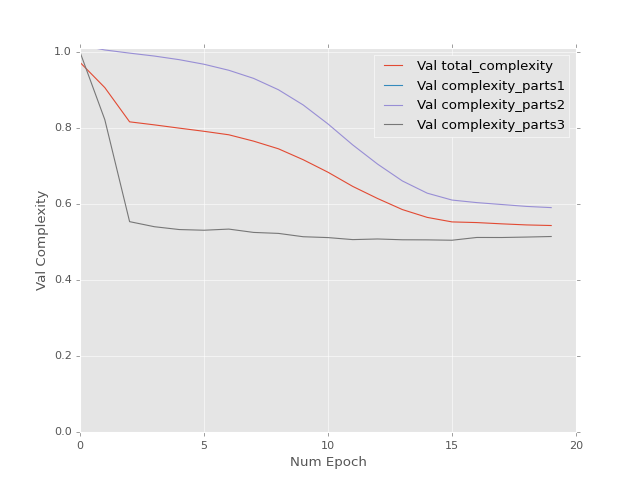

Epoch 1 of 20 took 6.113s
Epoch 2 of 20 took 5.779s
Epoch 3 of 20 took 5.762s
Epoch 4 of 20 took 5.852s
Epoch 5 of 20 took 5.832s
Epoch 6 of 20 took 6.121s
Epoch 7 of 20 took 6.053s
Epoch 8 of 20 took 6.069s
Epoch 9 of 20 took 6.038s
Epoch 10 of 20 took 5.919s
Epoch 11 of 20 took 6.016s
Epoch 12 of 20 took 5.887s
Epoch 13 of 20 took 5.910s
Epoch 14 of 20 took 5.868s
Epoch 15 of 20 took 6.047s
Epoch 16 of 20 took 5.972s
Epoch 17 of 20 took 6.262s
Epoch 18 of 20 took 5.820s
Epoch 19 of 20 took 6.065s
Epoch 20 of 20 took 5.616s


<IPython.core.display.Javascript object>


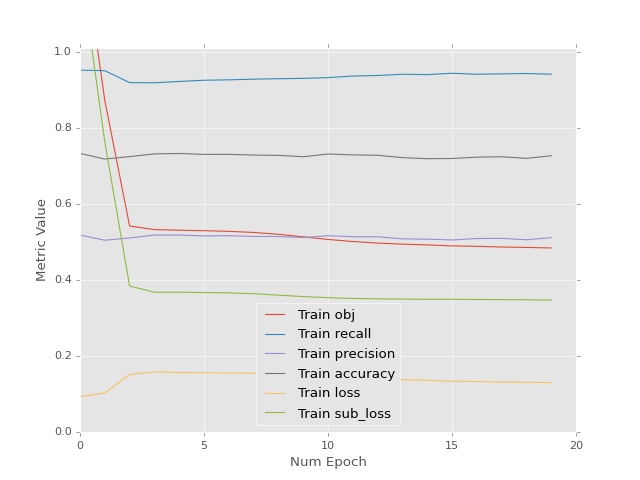

<IPython.core.display.Javascript object>


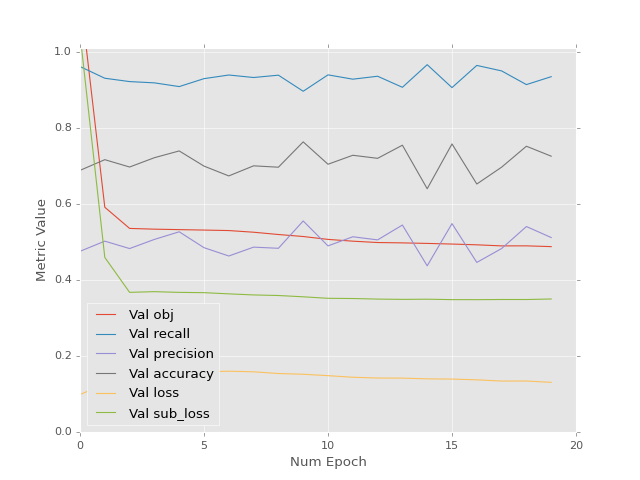

<IPython.core.display.Javascript object>


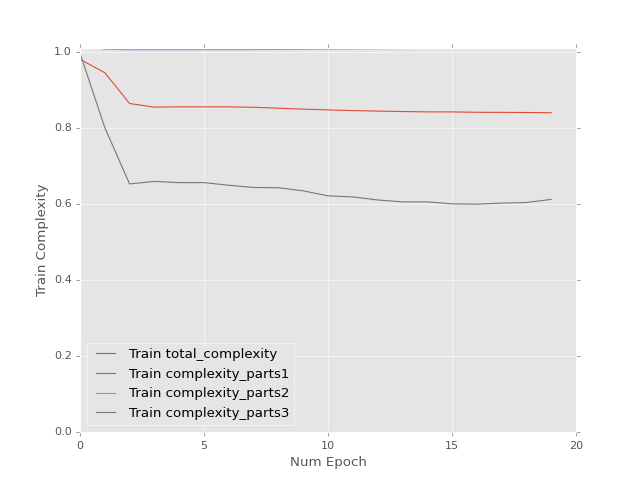

<IPython.core.display.Javascript object>


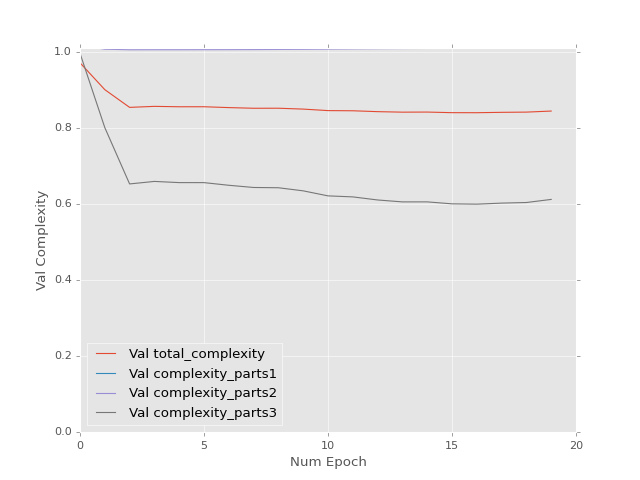

Epoch 1 of 20 took 5.885s
Epoch 2 of 20 took 6.212s
Epoch 3 of 20 took 5.999s
Epoch 4 of 20 took 5.940s
Epoch 5 of 20 took 5.956s
Epoch 6 of 20 took 5.665s
Epoch 7 of 20 took 5.861s
Epoch 8 of 20 took 5.868s
Epoch 9 of 20 took 5.655s
Epoch 10 of 20 took 5.686s
Epoch 11 of 20 took 5.651s
Epoch 12 of 20 took 5.696s
Epoch 13 of 20 took 5.931s
Epoch 14 of 20 took 5.629s
Epoch 15 of 20 took 5.858s
Epoch 16 of 20 took 6.289s
Epoch 17 of 20 took 5.845s
Epoch 18 of 20 took 5.917s
Epoch 19 of 20 took 6.149s
Epoch 20 of 20 took 6.045s


<IPython.core.display.Javascript object>


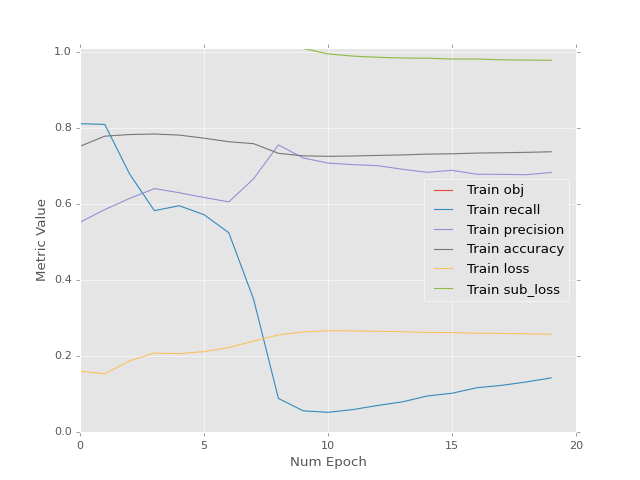

<IPython.core.display.Javascript object>


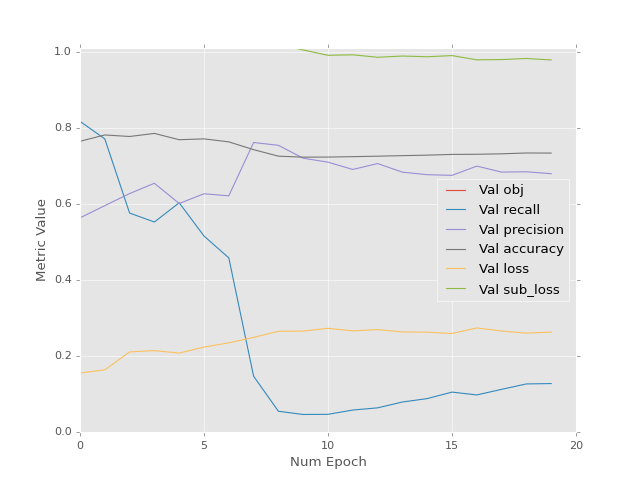

<IPython.core.display.Javascript object>


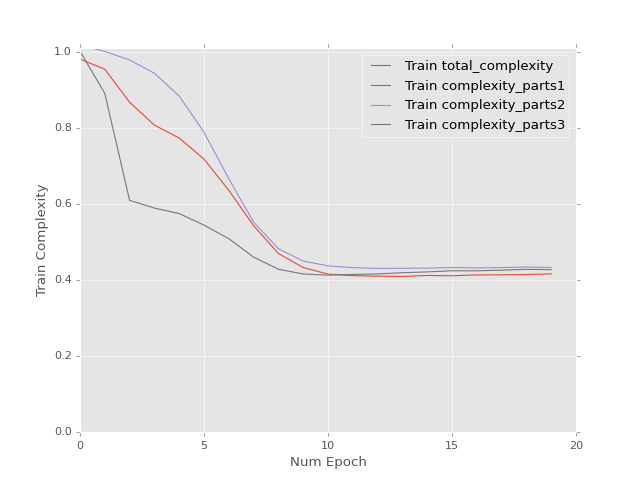

<IPython.core.display.Javascript object>


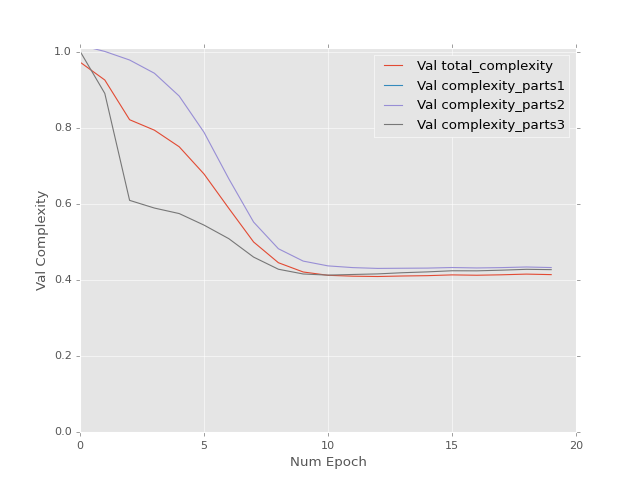

Epoch 1 of 20 took 5.674s
Epoch 2 of 20 took 5.788s
Epoch 3 of 20 took 6.194s
Epoch 4 of 20 took 6.113s
Epoch 5 of 20 took 6.025s
Epoch 6 of 20 took 6.265s
Epoch 7 of 20 took 6.138s
Epoch 8 of 20 took 5.760s
Epoch 9 of 20 took 6.019s
Epoch 10 of 20 took 6.178s
Epoch 11 of 20 took 6.217s
Epoch 12 of 20 took 6.273s
Epoch 13 of 20 took 6.099s
Epoch 14 of 20 took 5.914s
Epoch 15 of 20 took 5.928s
Epoch 16 of 20 took 5.892s
Epoch 17 of 20 took 6.002s
Epoch 18 of 20 took 6.086s
Epoch 19 of 20 took 5.977s
Epoch 20 of 20 took 6.237s


<IPython.core.display.Javascript object>


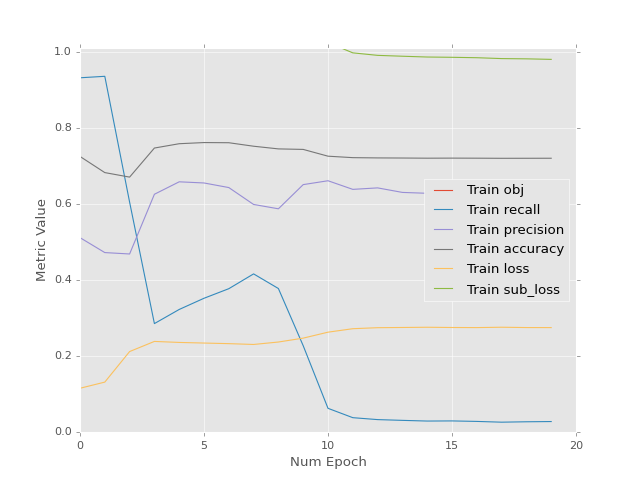

<IPython.core.display.Javascript object>


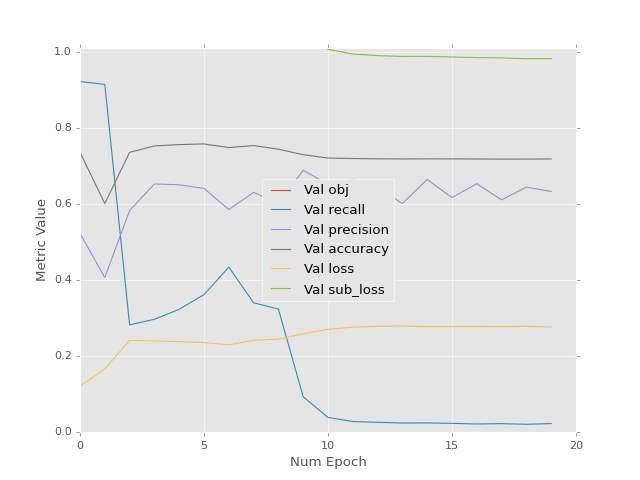

<IPython.core.display.Javascript object>


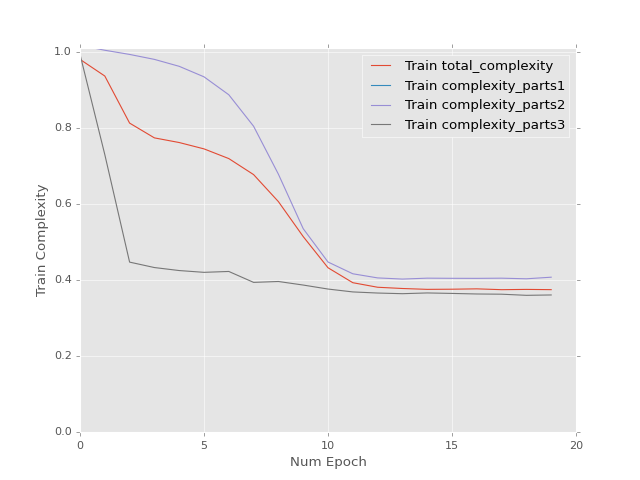

<IPython.core.display.Javascript object>


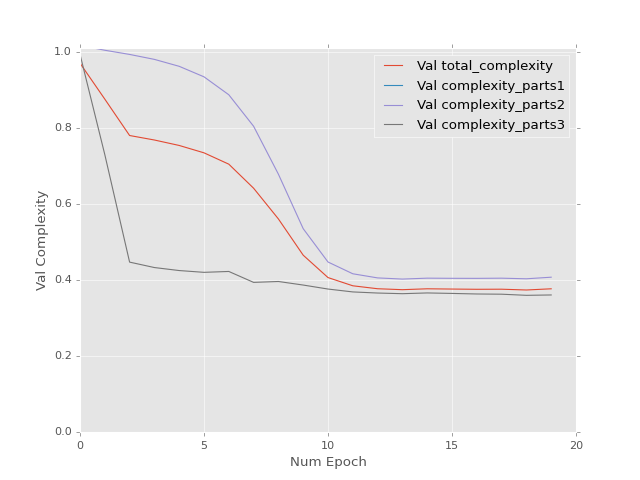

Epoch 1 of 20 took 6.061s
Epoch 2 of 20 took 6.219s
Epoch 3 of 20 took 6.032s
Epoch 4 of 20 took 5.897s
Epoch 5 of 20 took 6.081s
Epoch 6 of 20 took 6.226s
Epoch 7 of 20 took 5.720s
Epoch 8 of 20 took 5.930s
Epoch 9 of 20 took 5.968s
Epoch 10 of 20 took 6.214s
Epoch 11 of 20 took 6.118s
Epoch 12 of 20 took 6.034s
Epoch 13 of 20 took 6.136s
Epoch 14 of 20 took 5.879s
Epoch 15 of 20 took 5.809s
Epoch 16 of 20 took 5.929s
Epoch 17 of 20 took 6.041s
Epoch 18 of 20 took 6.028s
Epoch 19 of 20 took 5.979s
Epoch 20 of 20 took 5.845s


<IPython.core.display.Javascript object>


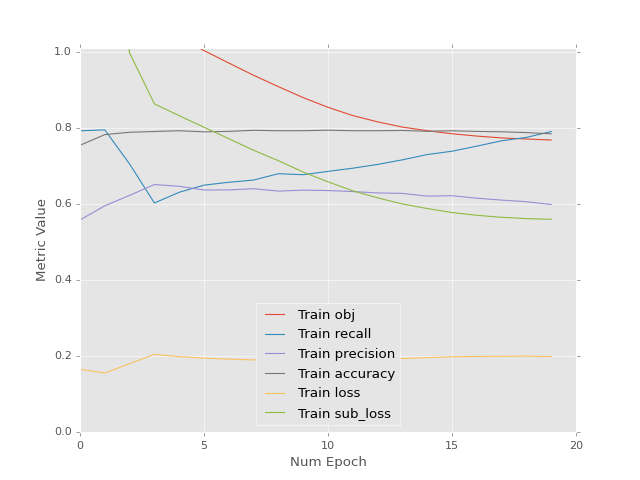

<IPython.core.display.Javascript object>


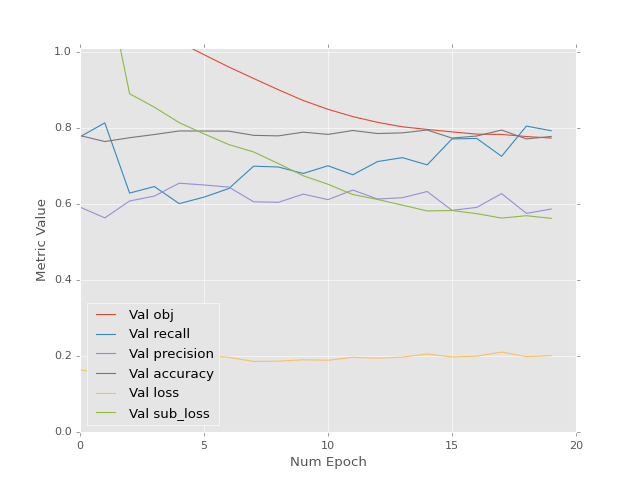

<IPython.core.display.Javascript object>


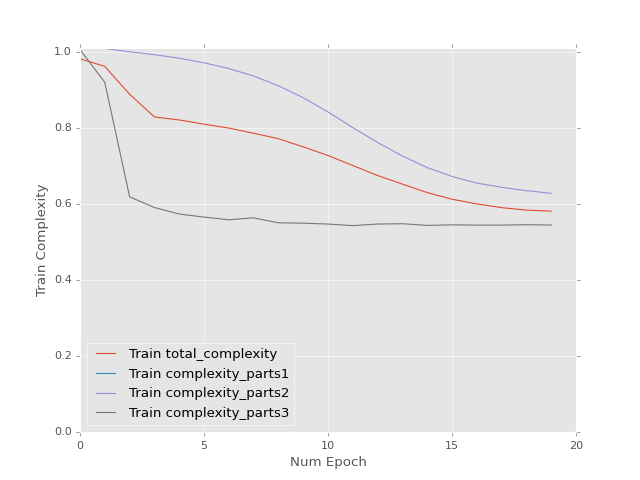

<IPython.core.display.Javascript object>


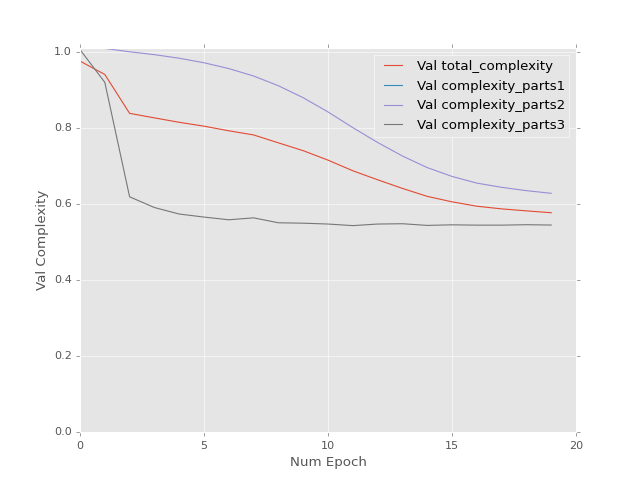

Epoch 1 of 20 took 5.597s
Epoch 2 of 20 took 6.065s
Epoch 3 of 20 took 6.163s
Epoch 4 of 20 took 5.747s
Epoch 5 of 20 took 5.670s
Epoch 6 of 20 took 5.709s
Epoch 7 of 20 took 5.636s
Epoch 8 of 20 took 5.848s
Epoch 9 of 20 took 6.402s
Epoch 10 of 20 took 6.347s
Epoch 11 of 20 took 6.096s
Epoch 12 of 20 took 5.618s
Epoch 13 of 20 took 5.907s
Epoch 14 of 20 took 6.179s
Epoch 15 of 20 took 5.942s
Epoch 16 of 20 took 5.828s
Epoch 17 of 20 took 5.947s
Epoch 18 of 20 took 6.201s
Epoch 19 of 20 took 5.831s
Epoch 20 of 20 took 5.975s


<IPython.core.display.Javascript object>


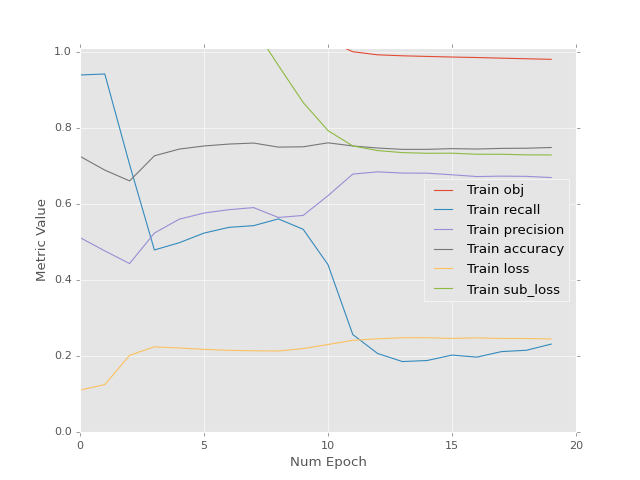

<IPython.core.display.Javascript object>


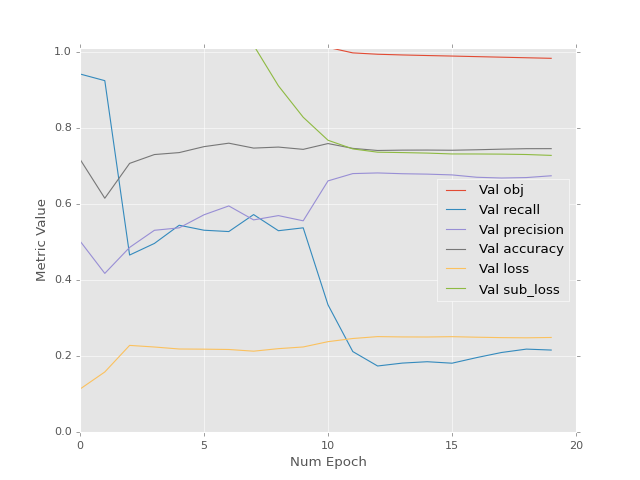

<IPython.core.display.Javascript object>


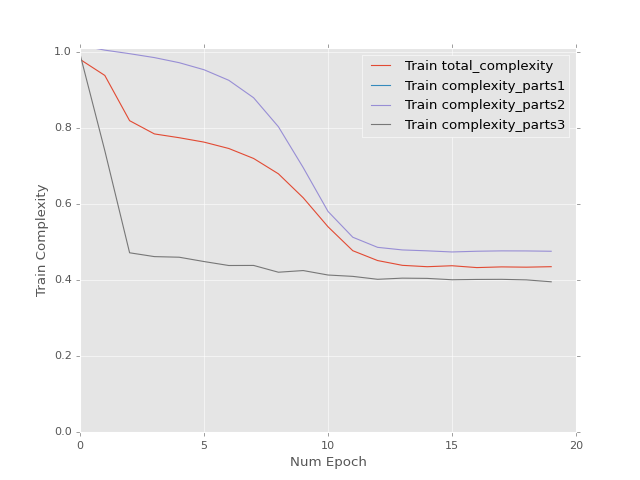

<IPython.core.display.Javascript object>


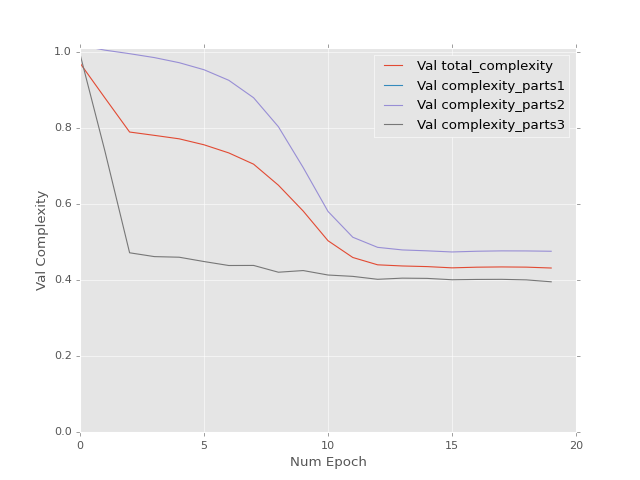

Epoch 1 of 20 took 5.660s
Epoch 2 of 20 took 5.928s
Epoch 3 of 20 took 6.112s
Epoch 4 of 20 took 5.731s
Epoch 5 of 20 took 5.859s
Epoch 6 of 20 took 6.070s
Epoch 7 of 20 took 5.594s
Epoch 8 of 20 took 6.064s
Epoch 9 of 20 took 5.800s
Epoch 10 of 20 took 5.898s
Epoch 11 of 20 took 5.679s
Epoch 12 of 20 took 6.106s
Epoch 13 of 20 took 5.768s
Epoch 14 of 20 took 6.061s
Epoch 15 of 20 took 5.840s
Epoch 16 of 20 took 5.763s
Epoch 17 of 20 took 6.061s
Epoch 18 of 20 took 6.106s
Epoch 19 of 20 took 5.818s
Epoch 20 of 20 took 6.389s


<IPython.core.display.Javascript object>


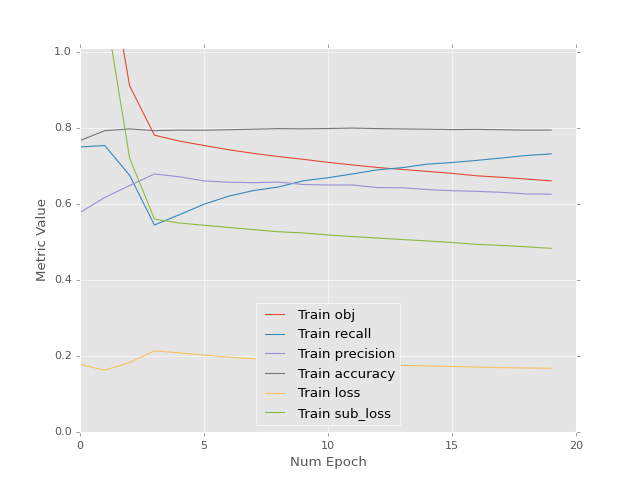

<IPython.core.display.Javascript object>


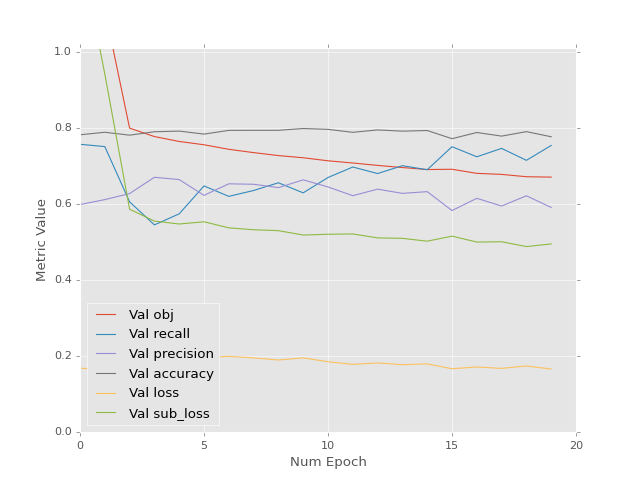

<IPython.core.display.Javascript object>


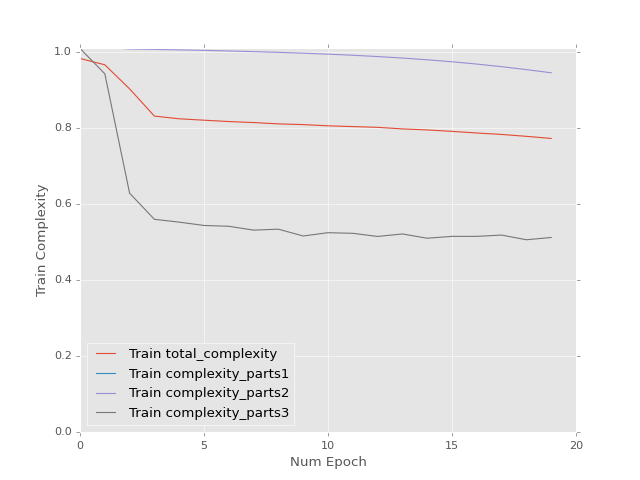

<IPython.core.display.Javascript object>


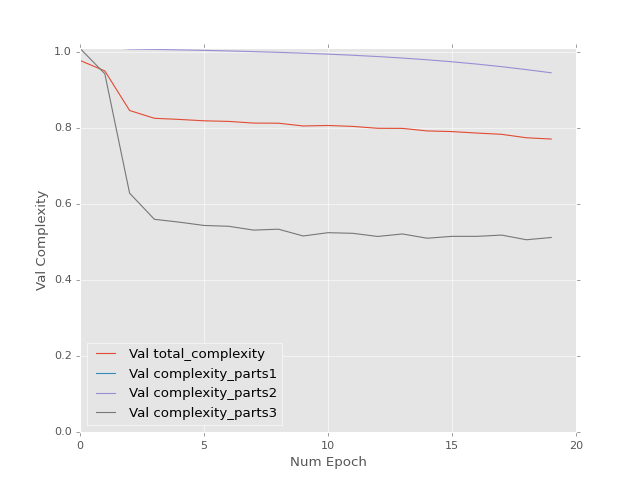

Epoch 1 of 20 took 6.049s
Epoch 2 of 20 took 5.789s
Epoch 3 of 20 took 5.934s
Epoch 4 of 20 took 5.853s
Epoch 5 of 20 took 6.067s
Epoch 6 of 20 took 6.047s
Epoch 7 of 20 took 6.166s
Epoch 8 of 20 took 6.275s
Epoch 9 of 20 took 6.010s
Epoch 10 of 20 took 6.100s
Epoch 11 of 20 took 6.163s
Epoch 12 of 20 took 6.311s
Epoch 13 of 20 took 6.157s
Epoch 14 of 20 took 6.177s
Epoch 15 of 20 took 5.937s
Epoch 16 of 20 took 5.956s
Epoch 17 of 20 took 6.002s
Epoch 18 of 20 took 5.883s
Epoch 19 of 20 took 6.061s
Epoch 20 of 20 took 5.909s


<IPython.core.display.Javascript object>


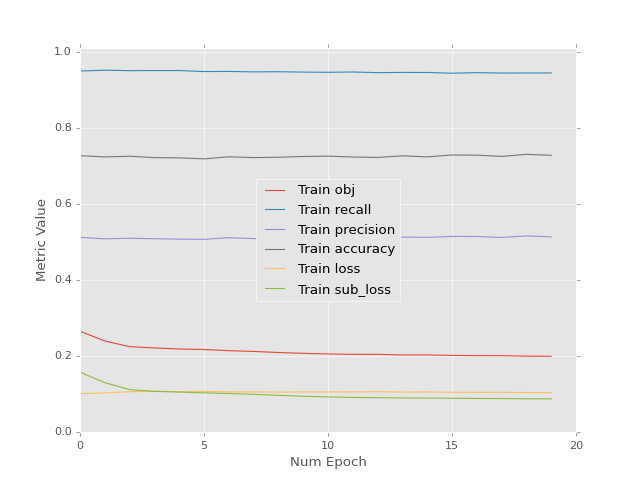

<IPython.core.display.Javascript object>


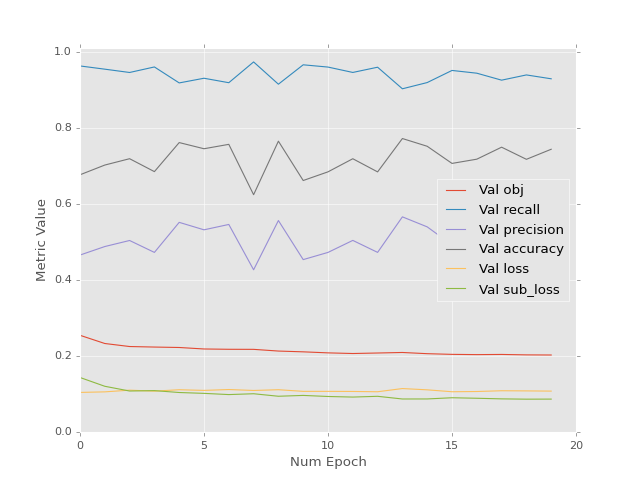

<IPython.core.display.Javascript object>


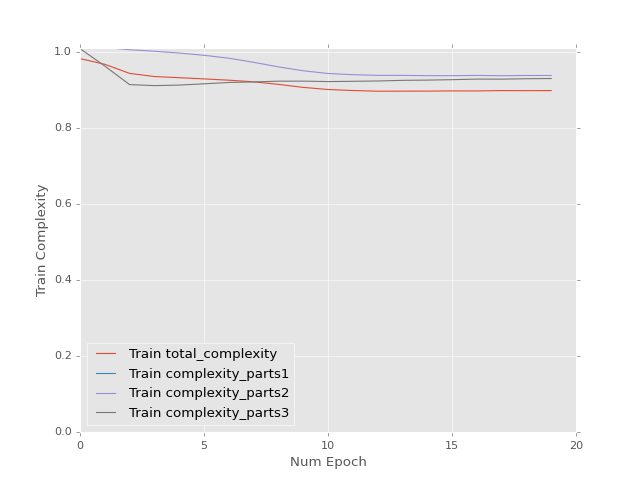

<IPython.core.display.Javascript object>


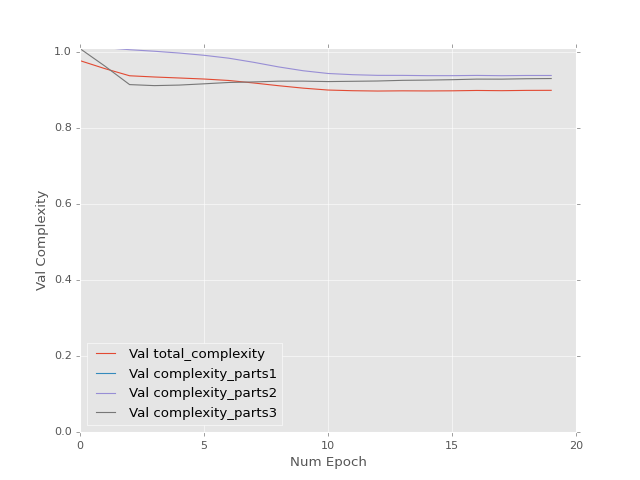

Epoch 1 of 20 took 6.077s
Epoch 2 of 20 took 5.876s
Epoch 3 of 20 took 5.691s
Epoch 4 of 20 took 6.332s
Epoch 5 of 20 took 6.048s
Epoch 6 of 20 took 6.257s
Epoch 7 of 20 took 6.171s
Epoch 8 of 20 took 5.675s
Epoch 9 of 20 took 6.009s
Epoch 10 of 20 took 6.015s
Epoch 11 of 20 took 6.014s
Epoch 12 of 20 took 5.704s
Epoch 13 of 20 took 5.950s
Epoch 14 of 20 took 5.760s
Epoch 15 of 20 took 6.172s
Epoch 16 of 20 took 6.010s
Epoch 17 of 20 took 6.061s
Epoch 18 of 20 took 6.174s
Epoch 19 of 20 took 5.657s
Epoch 20 of 20 took 5.608s


<IPython.core.display.Javascript object>


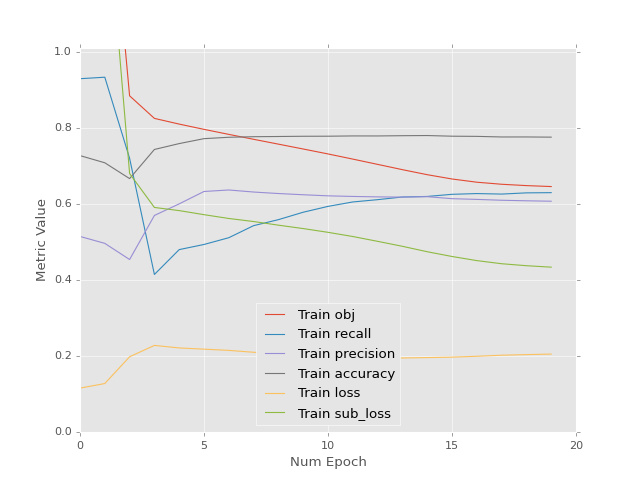

<IPython.core.display.Javascript object>


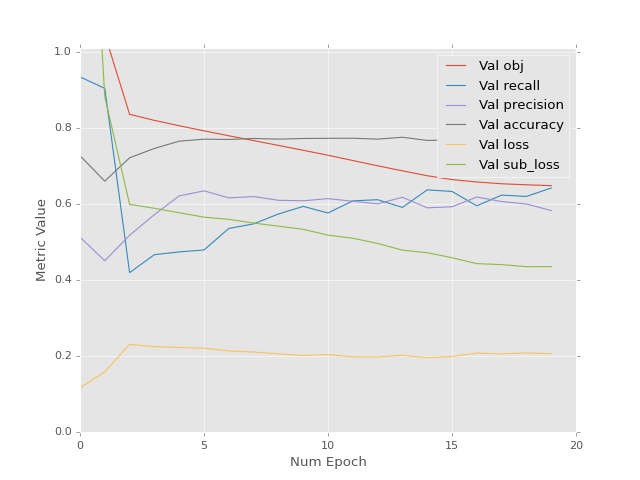

<IPython.core.display.Javascript object>


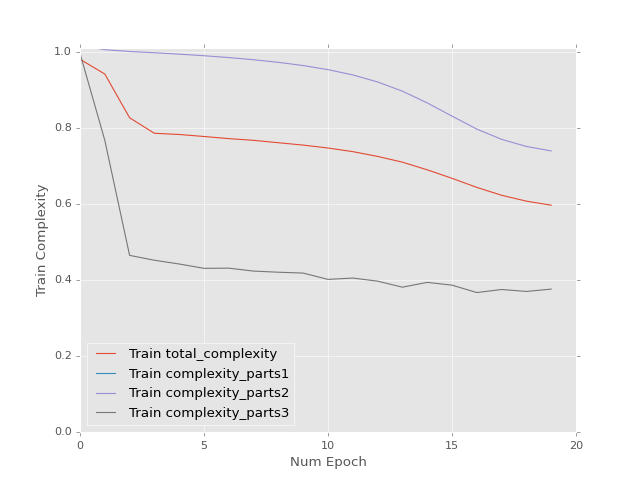

<IPython.core.display.Javascript object>


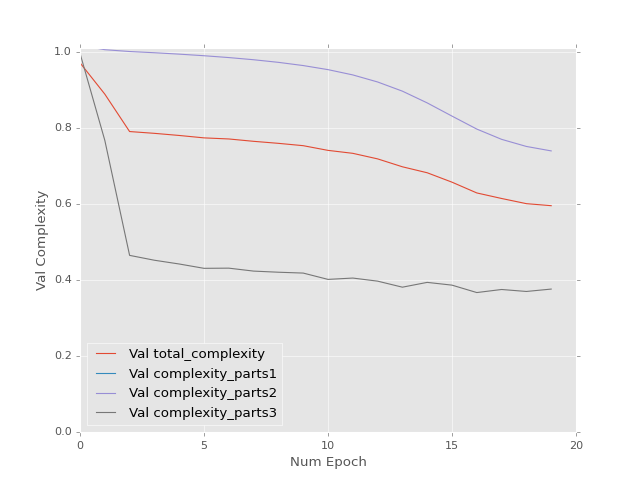

Epoch 1 of 20 took 5.882s
Epoch 2 of 20 took 6.134s
Epoch 3 of 20 took 5.729s
Epoch 4 of 20 took 6.000s
Epoch 5 of 20 took 5.667s
Epoch 6 of 20 took 5.648s
Epoch 7 of 20 took 6.037s
Epoch 8 of 20 took 6.146s
Epoch 9 of 20 took 5.591s
Epoch 10 of 20 took 5.857s
Epoch 11 of 20 took 5.635s
Epoch 12 of 20 took 5.983s
Epoch 13 of 20 took 6.437s
Epoch 14 of 20 took 6.318s
Epoch 15 of 20 took 6.179s
Epoch 16 of 20 took 6.045s
Epoch 17 of 20 took 5.585s
Epoch 18 of 20 took 5.847s
Epoch 19 of 20 took 5.773s
Epoch 20 of 20 took 6.062s


<IPython.core.display.Javascript object>


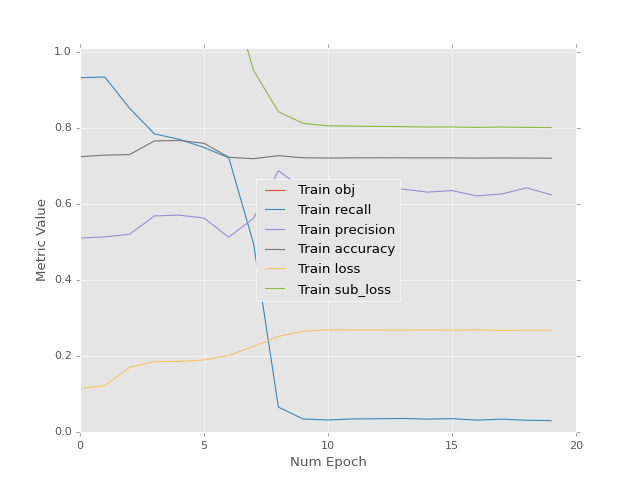

<IPython.core.display.Javascript object>


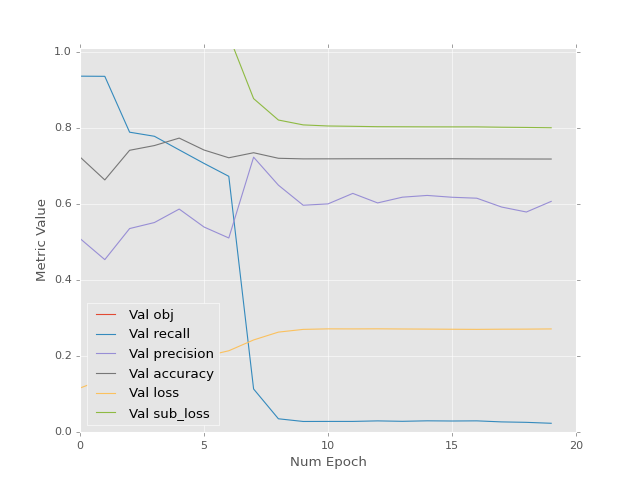

<IPython.core.display.Javascript object>


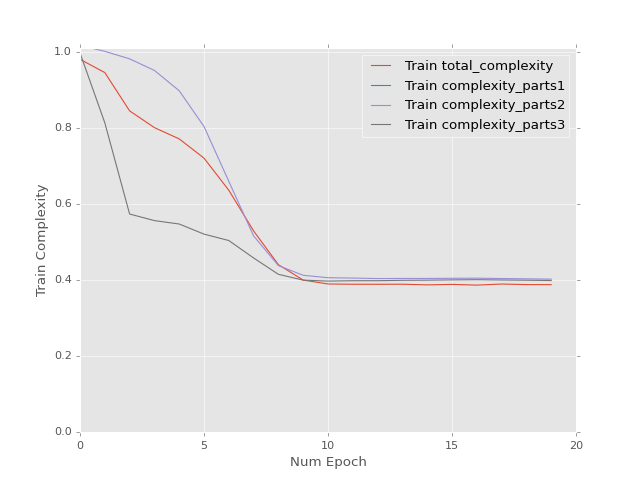

<IPython.core.display.Javascript object>


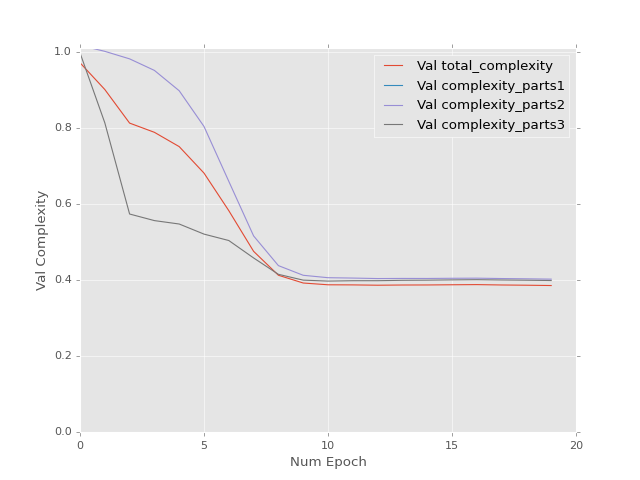

Epoch 1 of 20 took 5.995s
Epoch 2 of 20 took 5.861s
Epoch 3 of 20 took 6.007s
Epoch 4 of 20 took 5.972s
Epoch 5 of 20 took 5.743s
Epoch 6 of 20 took 6.143s
Epoch 7 of 20 took 6.100s
Epoch 8 of 20 took 5.996s
Epoch 9 of 20 took 6.287s
Epoch 10 of 20 took 5.899s
Epoch 11 of 20 took 5.938s
Epoch 12 of 20 took 6.083s
Epoch 13 of 20 took 5.934s
Epoch 14 of 20 took 5.606s
Epoch 15 of 20 took 6.059s
Epoch 16 of 20 took 6.016s
Epoch 17 of 20 took 5.946s
Epoch 18 of 20 took 5.993s
Epoch 19 of 20 took 5.814s
Epoch 20 of 20 took 6.360s


<IPython.core.display.Javascript object>


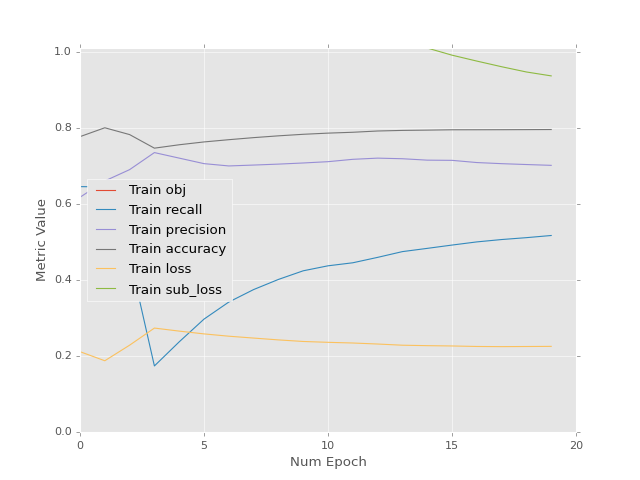

<IPython.core.display.Javascript object>


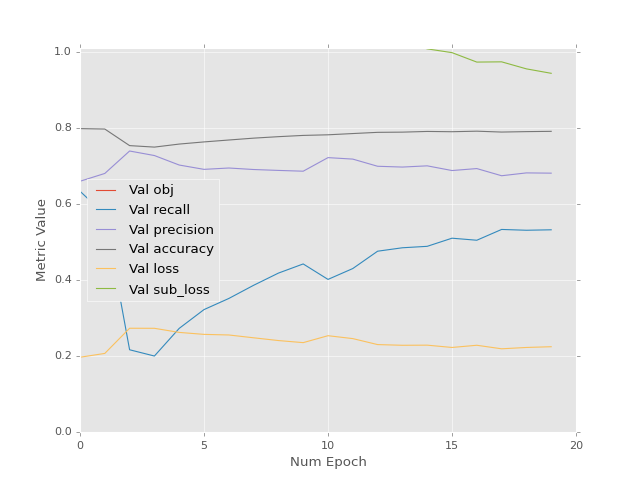

<IPython.core.display.Javascript object>


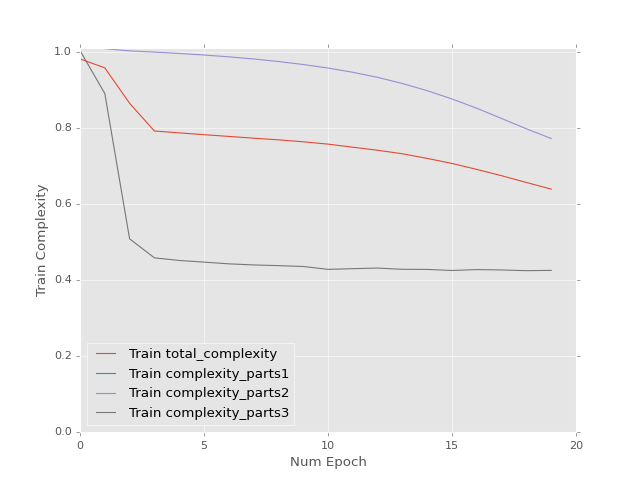

<IPython.core.display.Javascript object>


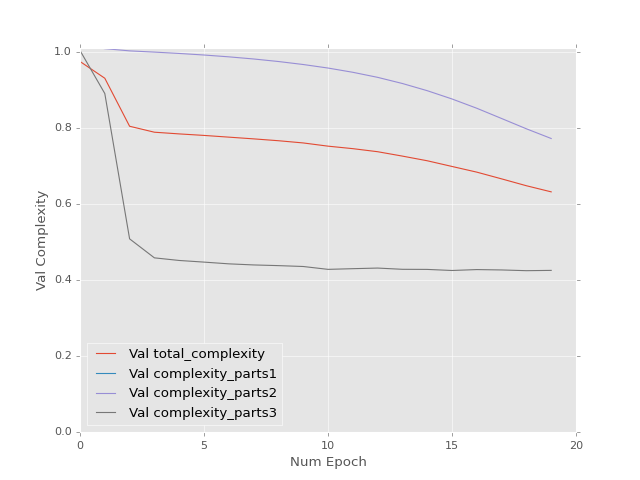

Epoch 1 of 20 took 5.809s
Epoch 2 of 20 took 6.145s
Epoch 3 of 20 took 6.121s
Epoch 4 of 20 took 5.979s
Epoch 5 of 20 took 5.978s
Epoch 6 of 20 took 5.624s
Epoch 7 of 20 took 5.698s
Epoch 8 of 20 took 5.806s
Epoch 9 of 20 took 5.815s
Epoch 10 of 20 took 5.804s
Epoch 11 of 20 took 5.858s
Epoch 12 of 20 took 5.909s
Epoch 13 of 20 took 6.097s
Epoch 14 of 20 took 5.598s
Epoch 15 of 20 took 6.153s
Epoch 16 of 20 took 5.802s
Epoch 17 of 20 took 6.089s
Epoch 18 of 20 took 5.587s
Epoch 19 of 20 took 6.162s
Epoch 20 of 20 took 5.976s


<IPython.core.display.Javascript object>


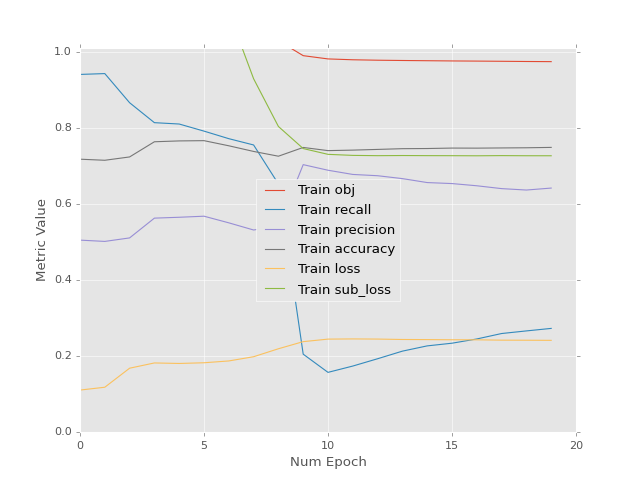

<IPython.core.display.Javascript object>


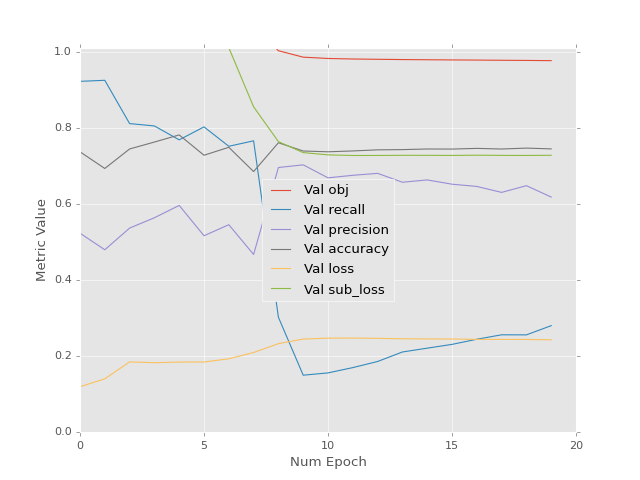

<IPython.core.display.Javascript object>


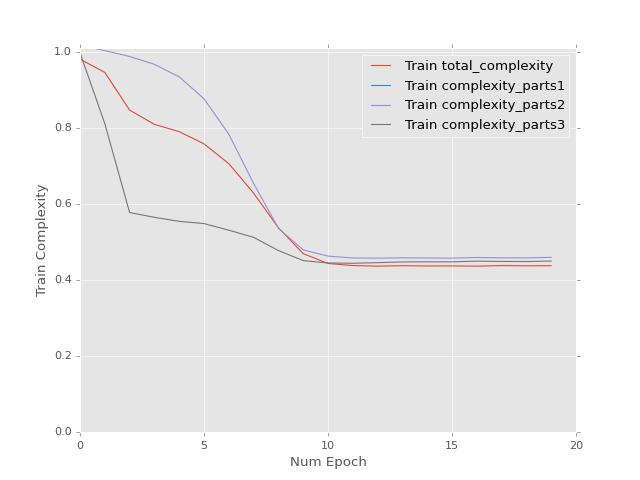

<IPython.core.display.Javascript object>


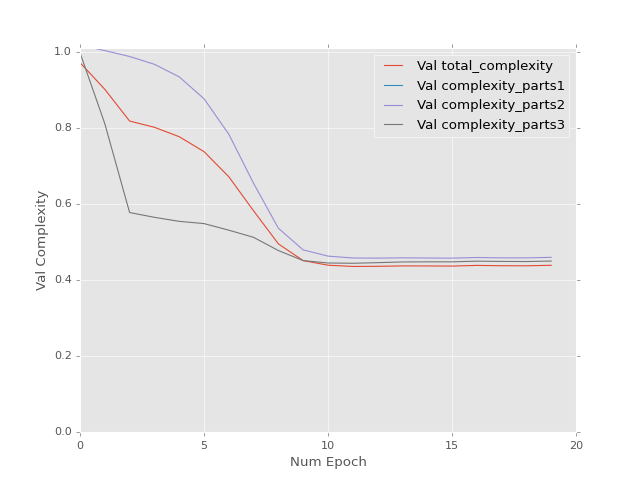

Epoch 1 of 20 took 5.677s
Epoch 2 of 20 took 5.883s
Epoch 3 of 20 took 6.069s
Epoch 4 of 20 took 5.989s
Epoch 5 of 20 took 6.037s
Epoch 6 of 20 took 5.890s
Epoch 7 of 20 took 5.962s
Epoch 8 of 20 took 6.051s
Epoch 9 of 20 took 5.588s
Epoch 10 of 20 took 5.912s
Epoch 11 of 20 took 6.124s
Epoch 12 of 20 took 6.097s
Epoch 13 of 20 took 6.227s
Epoch 14 of 20 took 5.745s
Epoch 15 of 20 took 6.069s
Epoch 16 of 20 took 5.871s
Epoch 17 of 20 took 6.009s
Epoch 18 of 20 took 6.289s
Epoch 19 of 20 took 5.958s
Epoch 20 of 20 took 6.031s


<IPython.core.display.Javascript object>


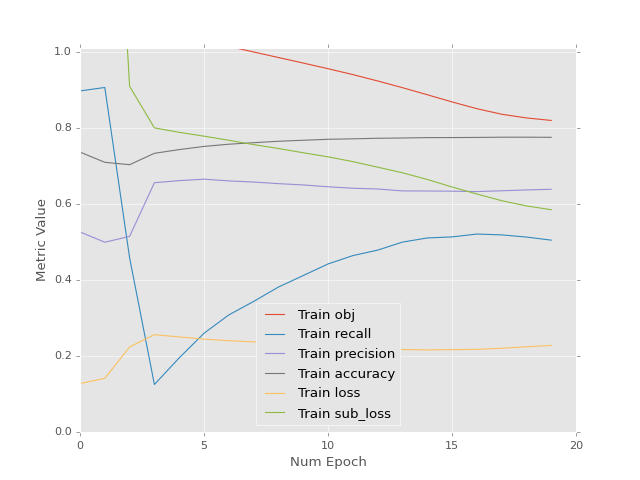

<IPython.core.display.Javascript object>


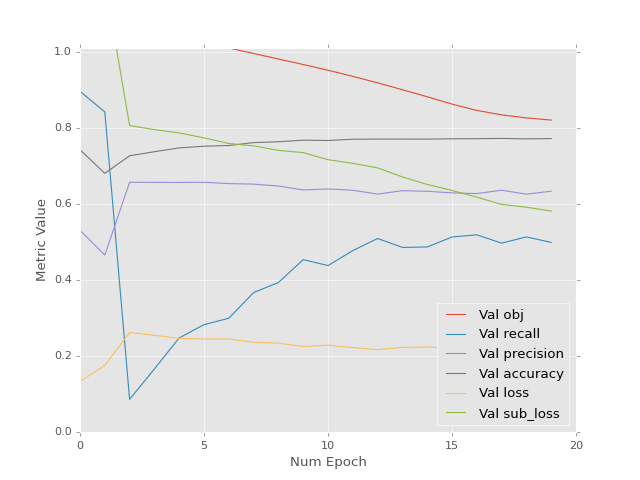

<IPython.core.display.Javascript object>


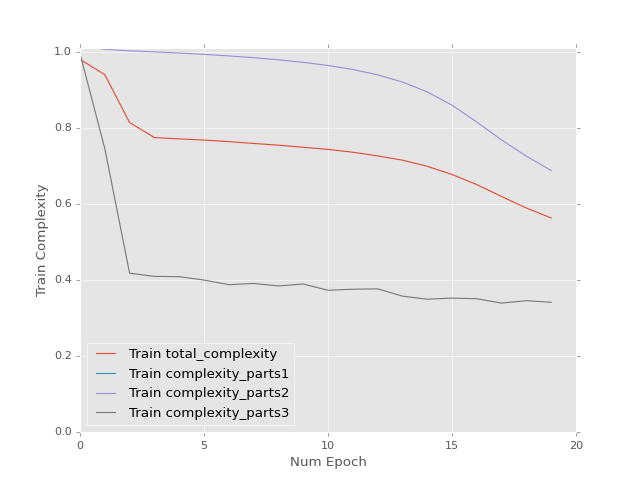

<IPython.core.display.Javascript object>


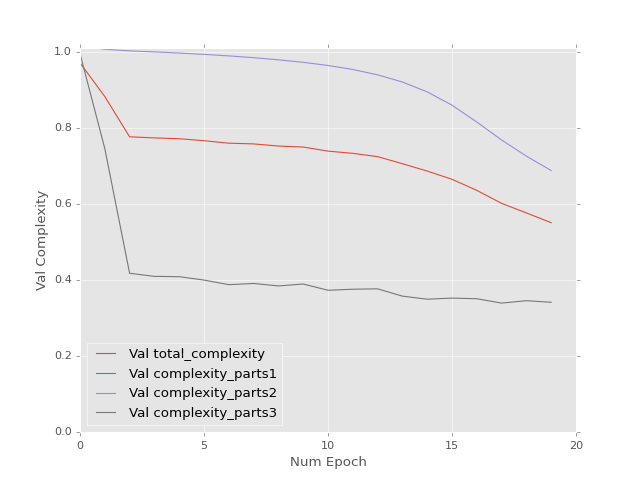

Epoch 1 of 20 took 5.811s
Epoch 2 of 20 took 6.082s
Epoch 3 of 20 took 6.148s
Epoch 4 of 20 took 5.935s
Epoch 5 of 20 took 5.793s
Epoch 6 of 20 took 5.594s
Epoch 7 of 20 took 5.852s
Epoch 8 of 20 took 6.086s
Epoch 9 of 20 took 5.972s
Epoch 10 of 20 took 5.911s
Epoch 11 of 20 took 6.081s
Epoch 12 of 20 took 5.993s
Epoch 13 of 20 took 5.834s
Epoch 14 of 20 took 5.769s
Epoch 15 of 20 took 5.593s
Epoch 16 of 20 took 5.598s
Epoch 17 of 20 took 6.084s
Epoch 18 of 20 took 5.943s
Epoch 19 of 20 took 6.018s
Epoch 20 of 20 took 5.592s


<IPython.core.display.Javascript object>


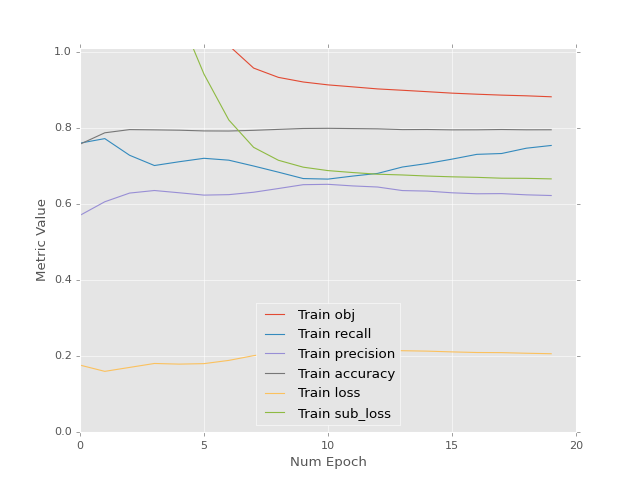

<IPython.core.display.Javascript object>


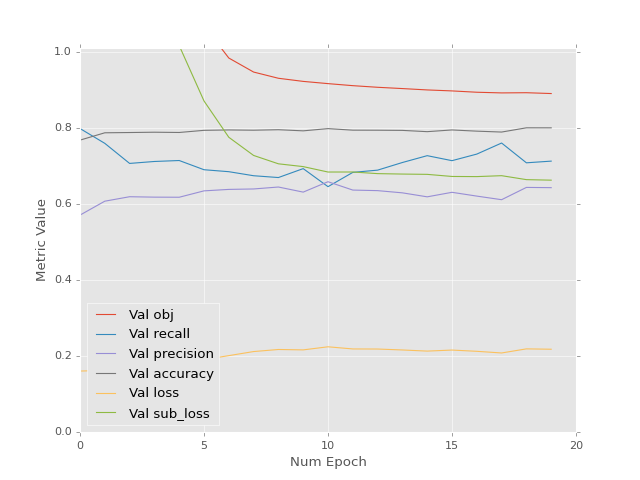

<IPython.core.display.Javascript object>


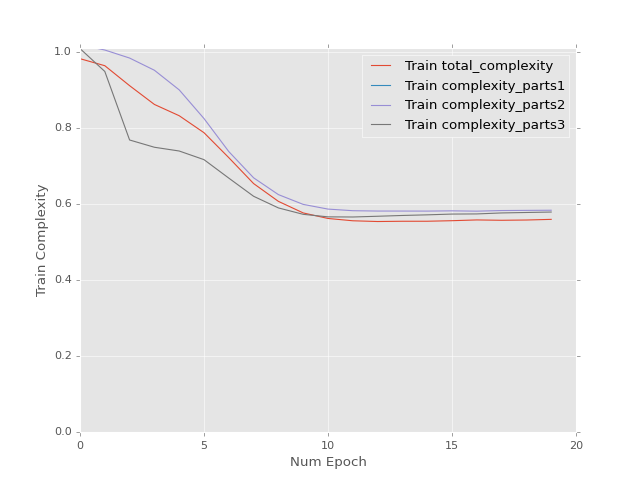

<IPython.core.display.Javascript object>


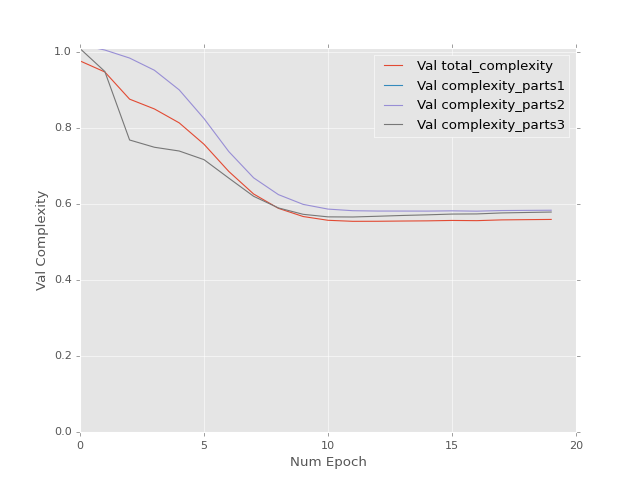

Epoch 1 of 20 took 6.202s
Epoch 2 of 20 took 5.925s
Epoch 3 of 20 took 5.822s
Epoch 4 of 20 took 6.264s
Epoch 5 of 20 took 5.592s
Epoch 6 of 20 took 5.668s
Epoch 7 of 20 took 6.104s
Epoch 8 of 20 took 6.273s
Epoch 9 of 20 took 5.918s
Epoch 10 of 20 took 6.050s
Epoch 11 of 20 took 6.202s
Epoch 12 of 20 took 6.050s
Epoch 13 of 20 took 5.908s
Epoch 14 of 20 took 6.165s
Epoch 15 of 20 took 6.000s
Epoch 16 of 20 took 5.713s
Epoch 17 of 20 took 5.990s
Epoch 18 of 20 took 5.976s
Epoch 19 of 20 took 6.144s
Epoch 20 of 20 took 5.912s


<IPython.core.display.Javascript object>


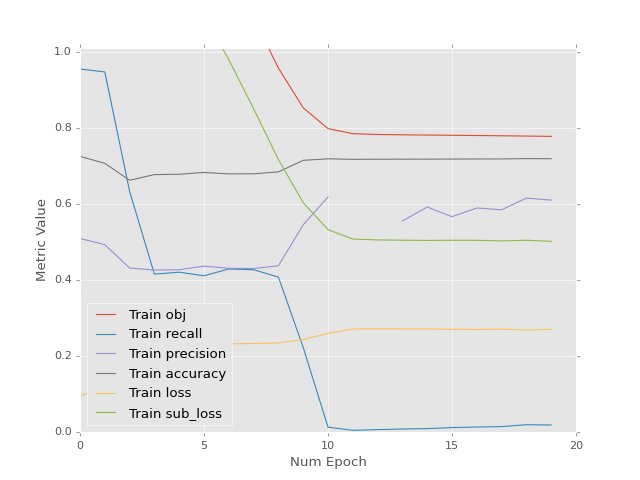

<IPython.core.display.Javascript object>


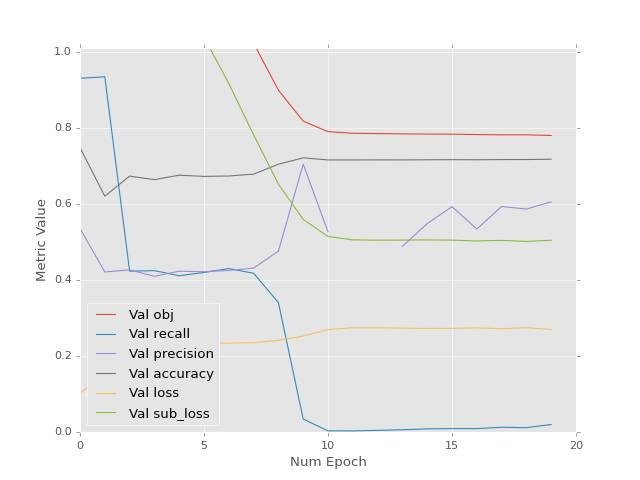

<IPython.core.display.Javascript object>


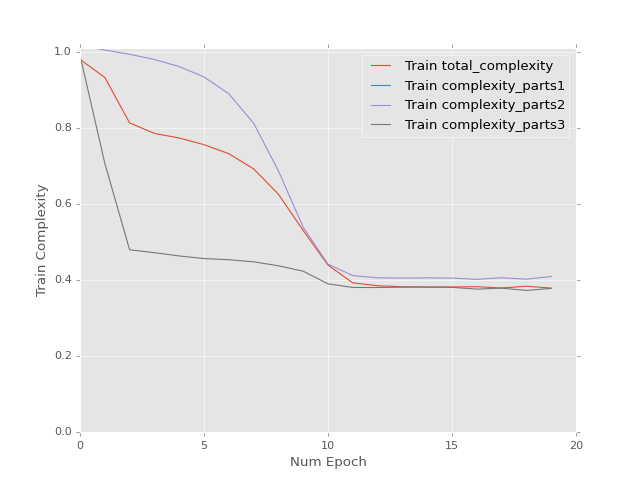

<IPython.core.display.Javascript object>


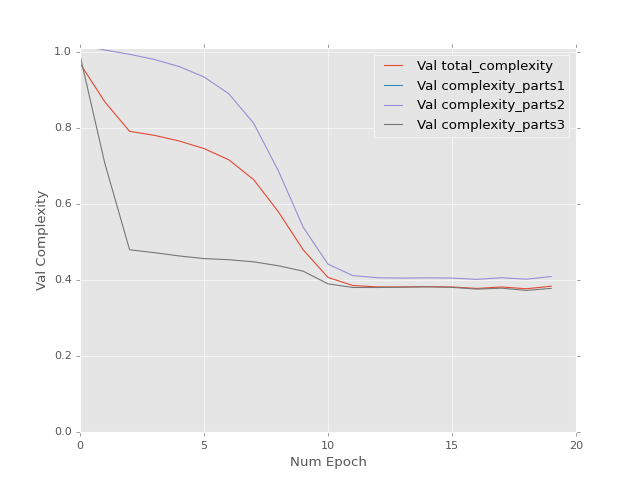

Epoch 1 of 20 took 5.953s
Epoch 2 of 20 took 6.236s
Epoch 3 of 20 took 6.151s
Epoch 4 of 20 took 5.850s
Epoch 5 of 20 took 5.824s
Epoch 6 of 20 took 6.054s
Epoch 7 of 20 took 6.182s
Epoch 8 of 20 took 5.969s
Epoch 9 of 20 took 5.821s
Epoch 10 of 20 took 6.153s
Epoch 11 of 20 took 6.401s
Epoch 12 of 20 took 5.784s
Epoch 13 of 20 took 6.247s
Epoch 14 of 20 took 6.181s
Epoch 15 of 20 took 6.335s
Epoch 16 of 20 took 5.894s
Epoch 17 of 20 took 5.667s
Epoch 18 of 20 took 5.690s
Epoch 19 of 20 took 5.982s
Epoch 20 of 20 took 5.818s


<IPython.core.display.Javascript object>


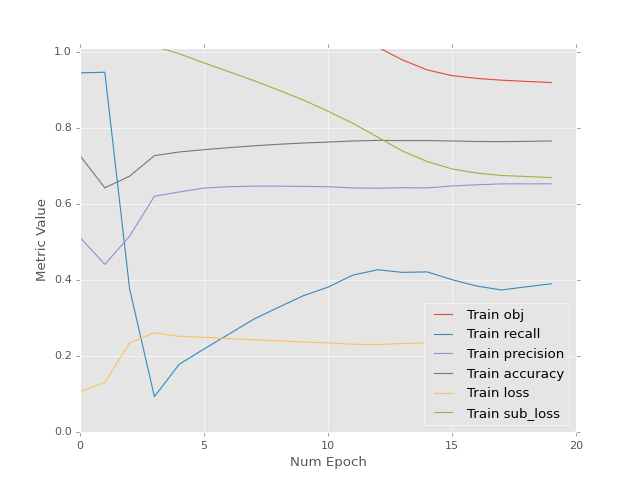

<IPython.core.display.Javascript object>


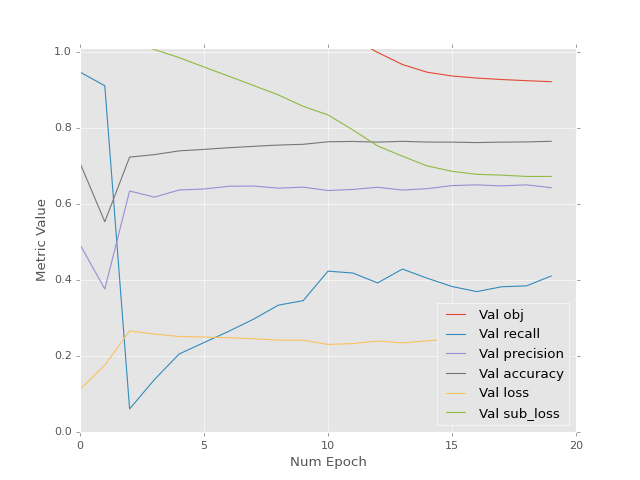

<IPython.core.display.Javascript object>


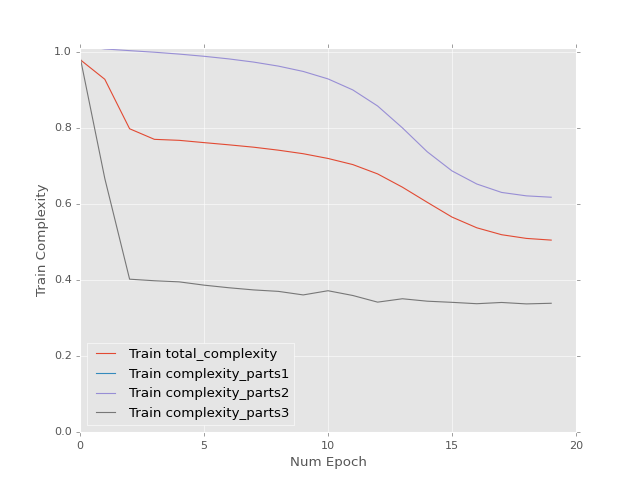

<IPython.core.display.Javascript object>


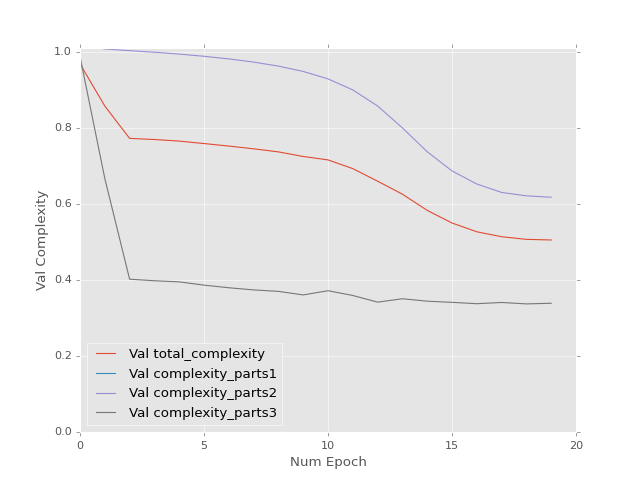

Epoch 1 of 20 took 6.013s
Epoch 2 of 20 took 5.806s
Epoch 3 of 20 took 6.070s
Epoch 4 of 20 took 5.881s
Epoch 5 of 20 took 5.837s
Epoch 6 of 20 took 5.595s
Epoch 7 of 20 took 5.597s
Epoch 8 of 20 took 5.596s
Epoch 9 of 20 took 5.895s
Epoch 10 of 20 took 6.128s
Epoch 11 of 20 took 6.070s
Epoch 12 of 20 took 5.969s
Epoch 13 of 20 took 5.822s
Epoch 14 of 20 took 5.850s
Epoch 15 of 20 took 5.933s
Epoch 16 of 20 took 5.675s
Epoch 17 of 20 took 6.109s
Epoch 18 of 20 took 5.700s
Epoch 19 of 20 took 6.053s
Epoch 20 of 20 took 5.811s


<IPython.core.display.Javascript object>


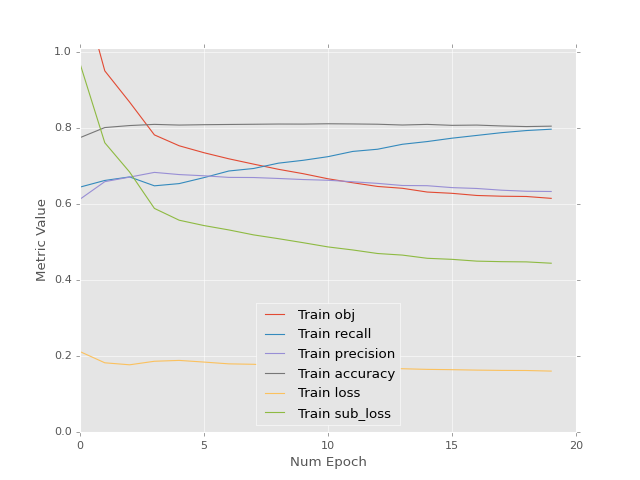

<IPython.core.display.Javascript object>


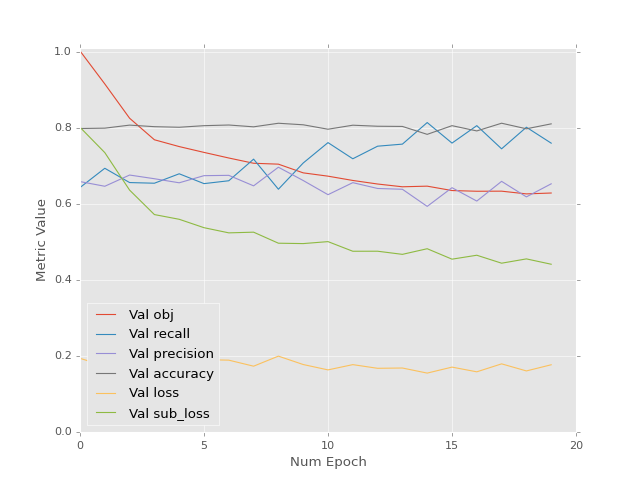

<IPython.core.display.Javascript object>


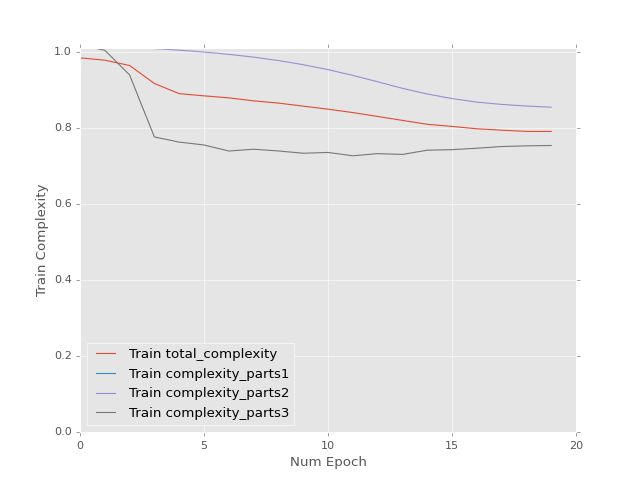

<IPython.core.display.Javascript object>


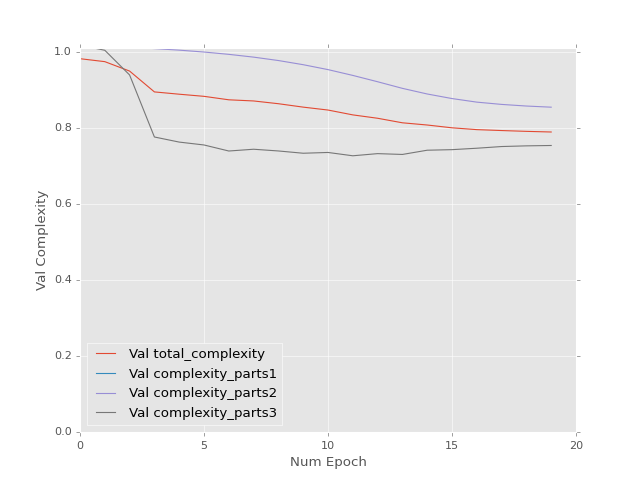

Epoch 1 of 20 took 5.986s
Epoch 2 of 20 took 5.843s
Epoch 3 of 20 took 5.933s
Epoch 4 of 20 took 6.092s
Epoch 5 of 20 took 6.009s
Epoch 6 of 20 took 5.933s
Epoch 7 of 20 took 5.997s
Epoch 8 of 20 took 5.849s
Epoch 9 of 20 took 6.078s
Epoch 10 of 20 took 5.859s
Epoch 11 of 20 took 5.985s
Epoch 12 of 20 took 5.874s
Epoch 13 of 20 took 6.047s
Epoch 14 of 20 took 6.157s
Epoch 15 of 20 took 6.088s
Epoch 16 of 20 took 5.976s
Epoch 17 of 20 took 5.908s
Epoch 18 of 20 took 6.049s
Epoch 19 of 20 took 6.107s
Epoch 20 of 20 took 5.970s


<IPython.core.display.Javascript object>


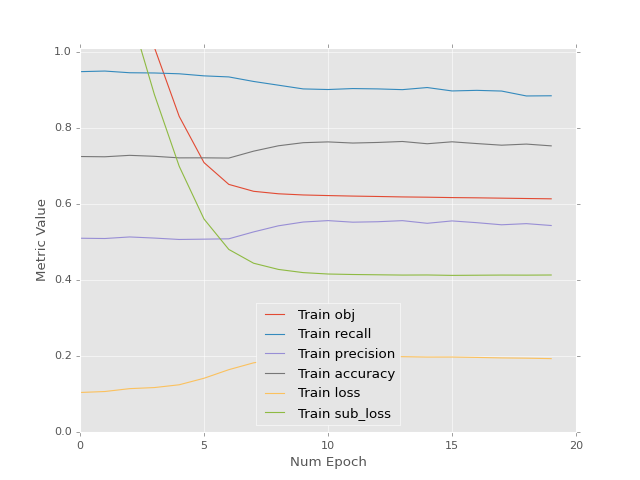

<IPython.core.display.Javascript object>


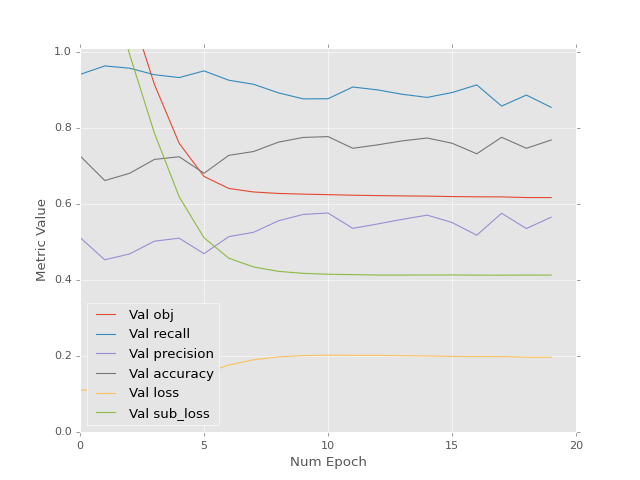

<IPython.core.display.Javascript object>


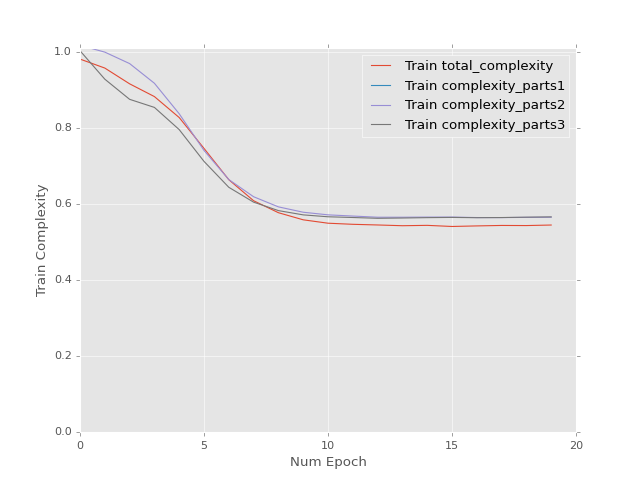

<IPython.core.display.Javascript object>


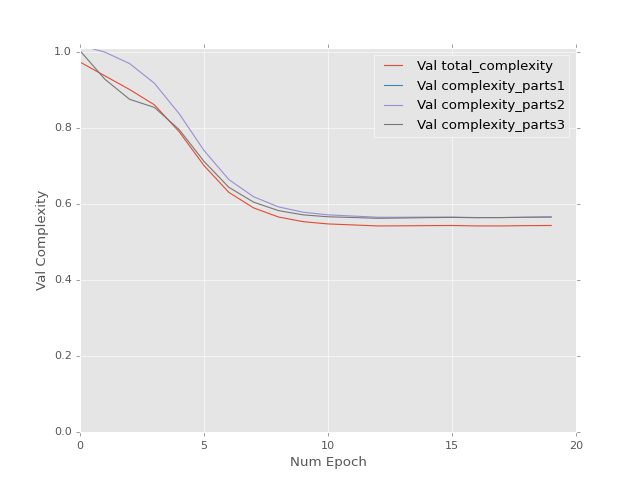

Epoch 1 of 20 took 6.062s
Epoch 2 of 20 took 6.036s
Epoch 3 of 20 took 6.144s
Epoch 4 of 20 took 5.907s
Epoch 5 of 20 took 5.930s
Epoch 6 of 20 took 5.764s
Epoch 7 of 20 took 5.616s
Epoch 8 of 20 took 5.840s
Epoch 9 of 20 took 6.089s
Epoch 10 of 20 took 5.822s
Epoch 11 of 20 took 5.609s
Epoch 12 of 20 took 6.182s
Epoch 13 of 20 took 6.111s
Epoch 14 of 20 took 6.066s
Epoch 15 of 20 took 5.956s
Epoch 16 of 20 took 5.650s
Epoch 17 of 20 took 6.133s
Epoch 18 of 20 took 5.587s
Epoch 19 of 20 took 5.825s
Epoch 20 of 20 took 5.820s


<IPython.core.display.Javascript object>


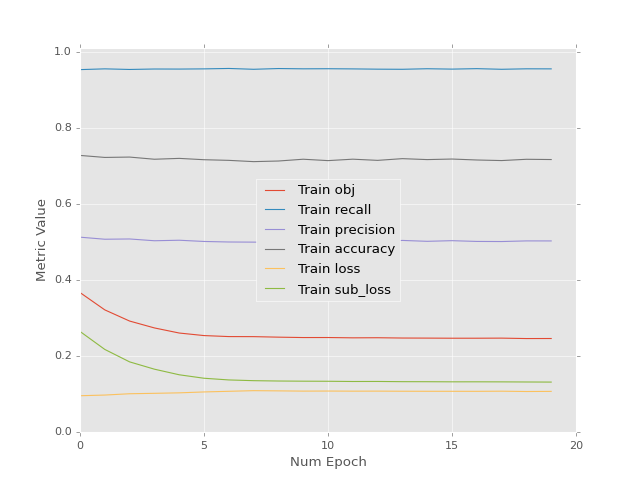

<IPython.core.display.Javascript object>


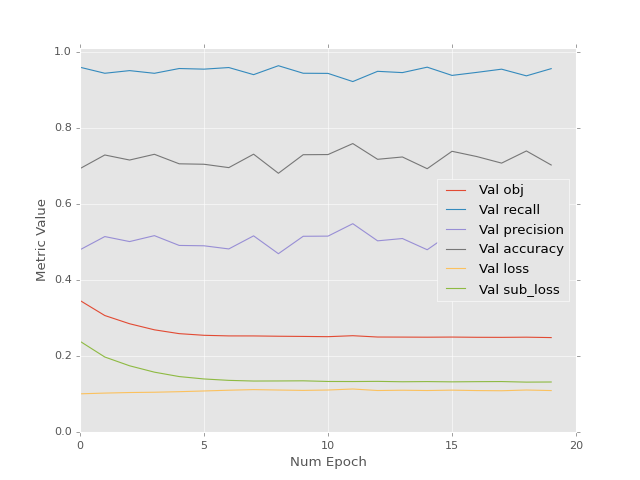

<IPython.core.display.Javascript object>


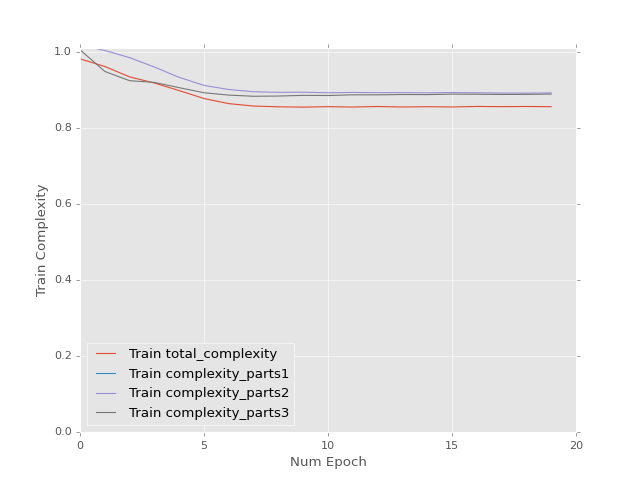

<IPython.core.display.Javascript object>


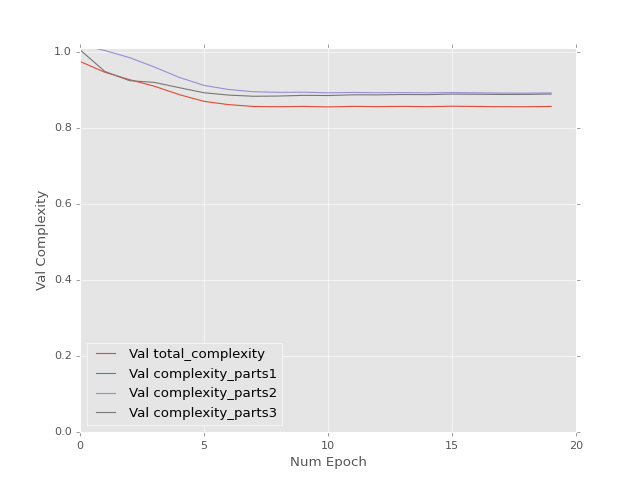

Epoch 1 of 20 took 6.141s
Epoch 2 of 20 took 6.094s
Epoch 3 of 20 took 6.291s
Epoch 4 of 20 took 6.042s
Epoch 5 of 20 took 5.895s
Epoch 6 of 20 took 6.057s
Epoch 7 of 20 took 5.855s
Epoch 8 of 20 took 5.991s
Epoch 9 of 20 took 5.855s
Epoch 10 of 20 took 5.847s
Epoch 11 of 20 took 6.000s
Epoch 12 of 20 took 5.948s
Epoch 13 of 20 took 5.834s
Epoch 14 of 20 took 5.848s
Epoch 15 of 20 took 5.994s
Epoch 16 of 20 took 5.889s
Epoch 17 of 20 took 5.989s
Epoch 18 of 20 took 5.860s
Epoch 19 of 20 took 5.958s
Epoch 20 of 20 took 6.093s


<IPython.core.display.Javascript object>


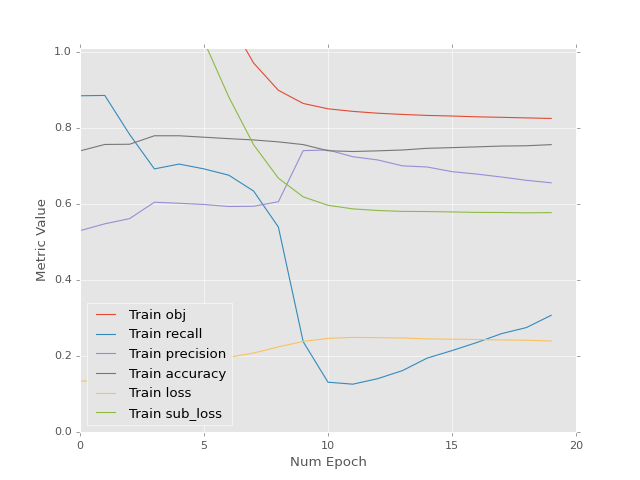

<IPython.core.display.Javascript object>


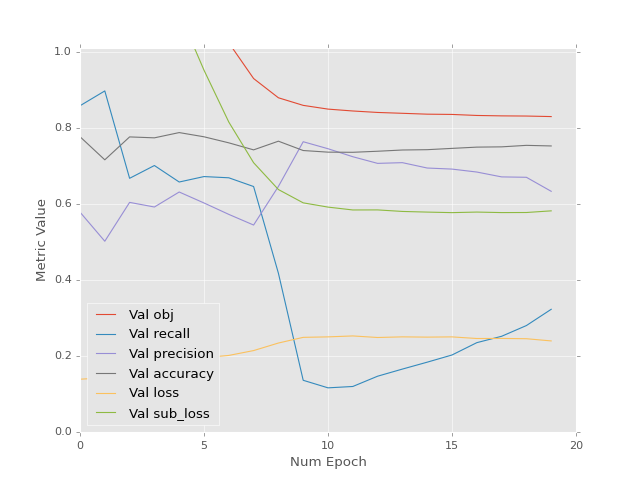

<IPython.core.display.Javascript object>


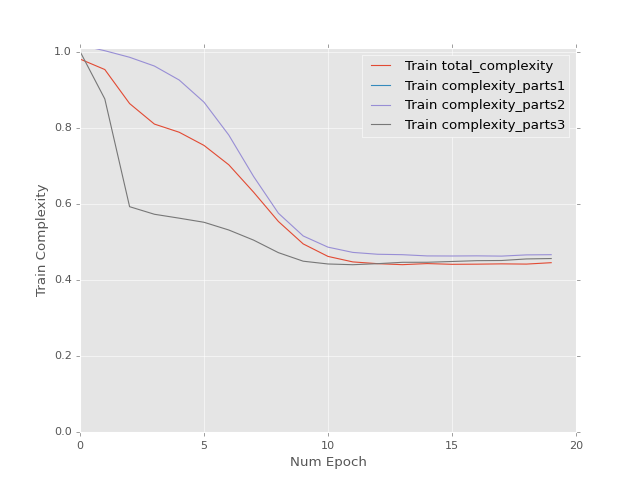

<IPython.core.display.Javascript object>


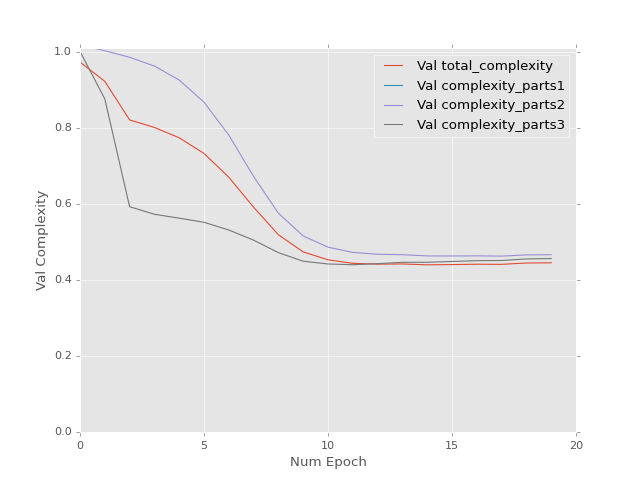

Epoch 1 of 20 took 5.976s
Epoch 2 of 20 took 6.070s
Epoch 3 of 20 took 5.921s
Epoch 4 of 20 took 5.935s
Epoch 5 of 20 took 5.885s
Epoch 6 of 20 took 6.006s
Epoch 7 of 20 took 5.849s
Epoch 8 of 20 took 5.967s
Epoch 9 of 20 took 5.982s
Epoch 10 of 20 took 5.950s
Epoch 11 of 20 took 5.864s
Epoch 12 of 20 took 5.949s
Epoch 13 of 20 took 5.948s
Epoch 14 of 20 took 5.927s
Epoch 15 of 20 took 6.002s
Epoch 16 of 20 took 5.956s
Epoch 17 of 20 took 6.045s
Epoch 18 of 20 took 5.992s
Epoch 19 of 20 took 5.890s
Epoch 20 of 20 took 5.979s


<IPython.core.display.Javascript object>


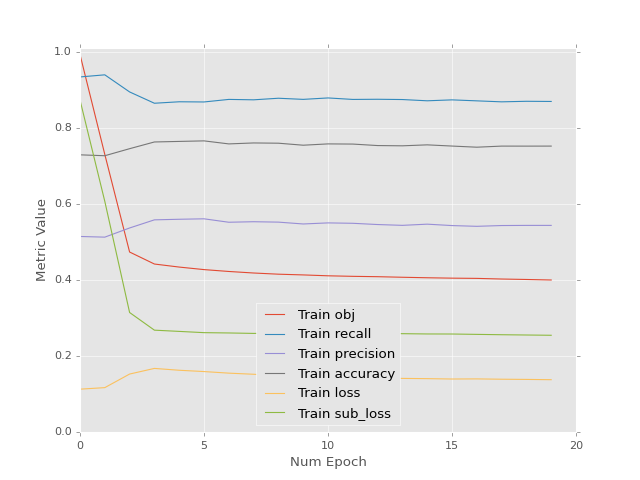

<IPython.core.display.Javascript object>


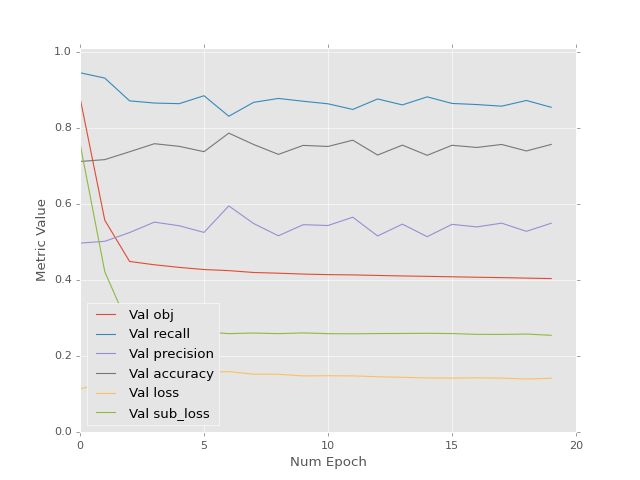

<IPython.core.display.Javascript object>


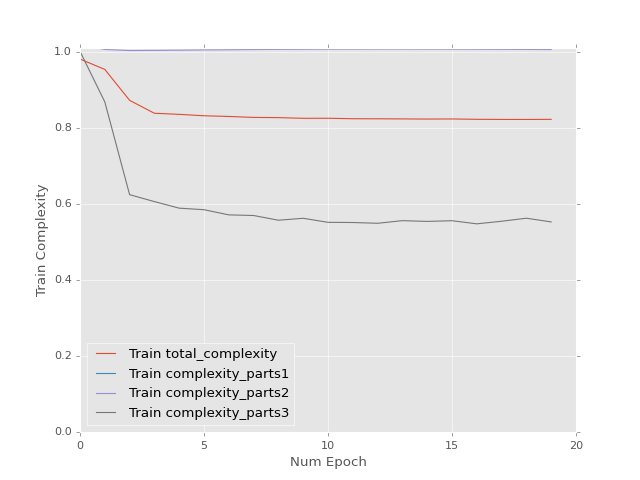

<IPython.core.display.Javascript object>


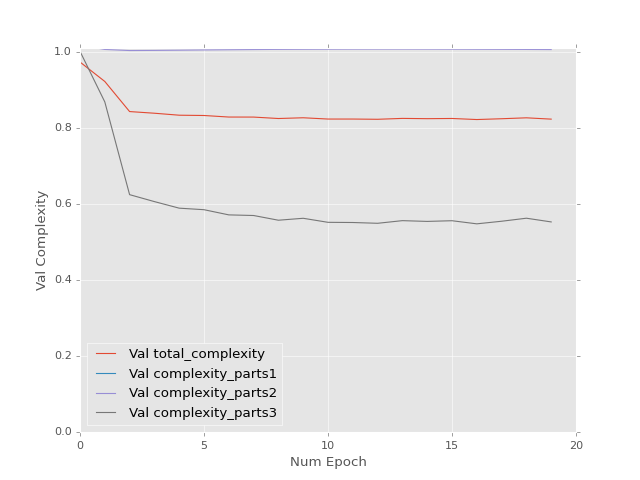

Epoch 1 of 20 took 5.953s
Epoch 2 of 20 took 6.025s
Epoch 3 of 20 took 6.246s
Epoch 4 of 20 took 6.294s
Epoch 5 of 20 took 6.227s
Epoch 6 of 20 took 6.021s
Epoch 7 of 20 took 6.013s
Epoch 8 of 20 took 6.025s
Epoch 9 of 20 took 6.030s
Epoch 10 of 20 took 6.017s
Epoch 11 of 20 took 6.067s
Epoch 12 of 20 took 6.059s
Epoch 13 of 20 took 6.199s
Epoch 14 of 20 took 6.215s
Epoch 15 of 20 took 6.065s
Epoch 16 of 20 took 6.172s
Epoch 17 of 20 took 5.987s
Epoch 18 of 20 took 6.034s
Epoch 19 of 20 took 6.016s
Epoch 20 of 20 took 5.854s


<IPython.core.display.Javascript object>


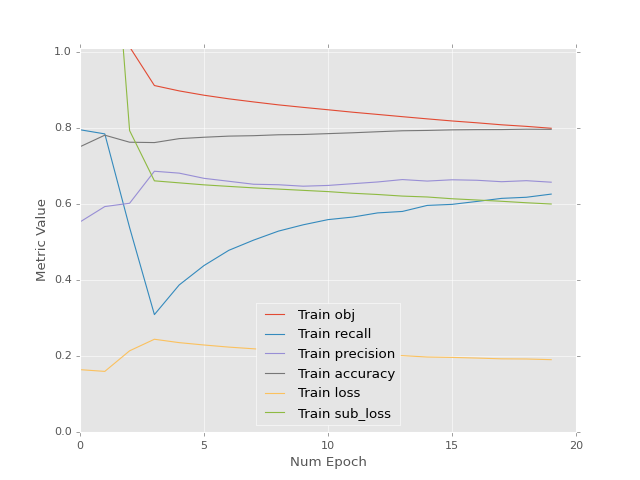

<IPython.core.display.Javascript object>


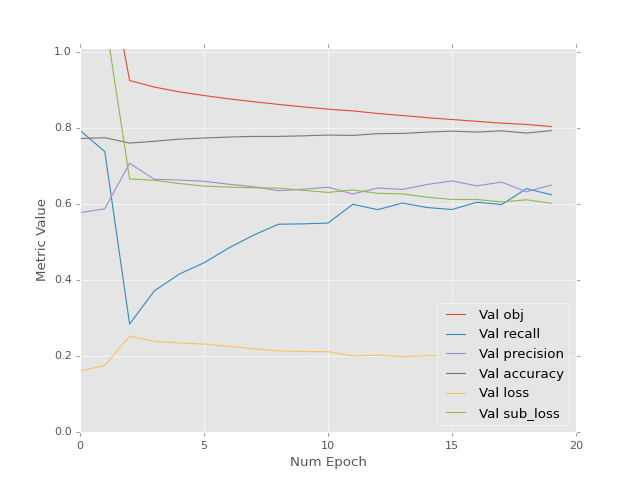

<IPython.core.display.Javascript object>


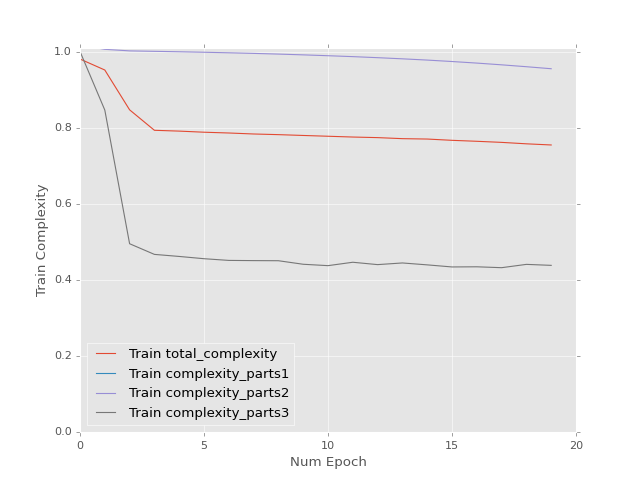

<IPython.core.display.Javascript object>


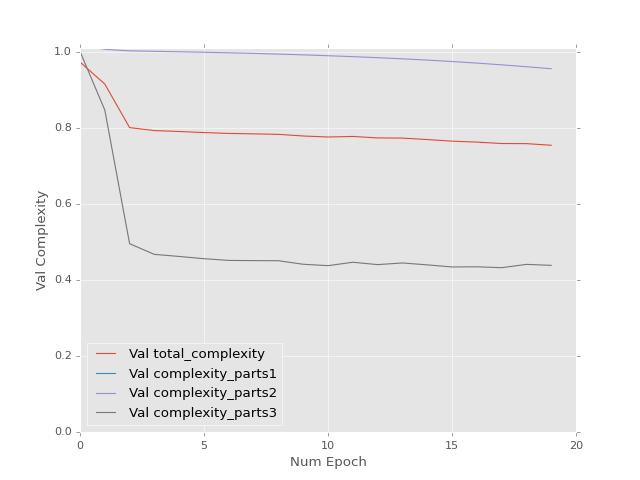

Epoch 1 of 20 took 5.918s
Epoch 2 of 20 took 6.091s
Epoch 3 of 20 took 5.989s
Epoch 4 of 20 took 6.149s
Epoch 5 of 20 took 5.965s
Epoch 6 of 20 took 5.886s
Epoch 7 of 20 took 6.225s
Epoch 8 of 20 took 5.980s
Epoch 9 of 20 took 6.336s
Epoch 10 of 20 took 5.982s
Epoch 11 of 20 took 5.954s
Epoch 12 of 20 took 6.080s
Epoch 13 of 20 took 5.947s
Epoch 14 of 20 took 6.071s
Epoch 15 of 20 took 5.990s
Epoch 16 of 20 took 5.986s
Epoch 17 of 20 took 6.017s
Epoch 18 of 20 took 5.994s
Epoch 19 of 20 took 5.950s
Epoch 20 of 20 took 5.858s


<IPython.core.display.Javascript object>


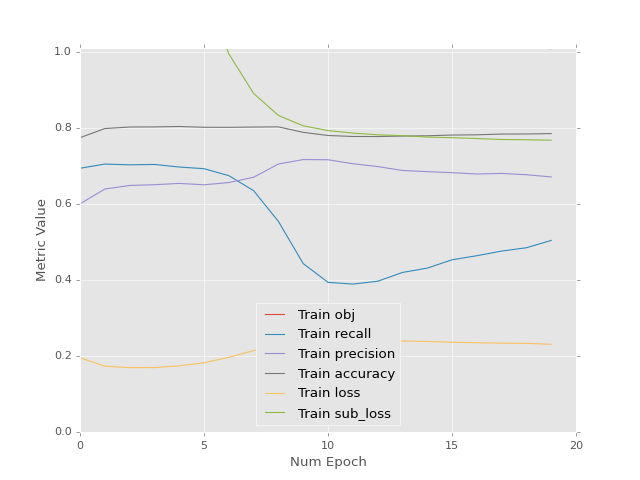

<IPython.core.display.Javascript object>


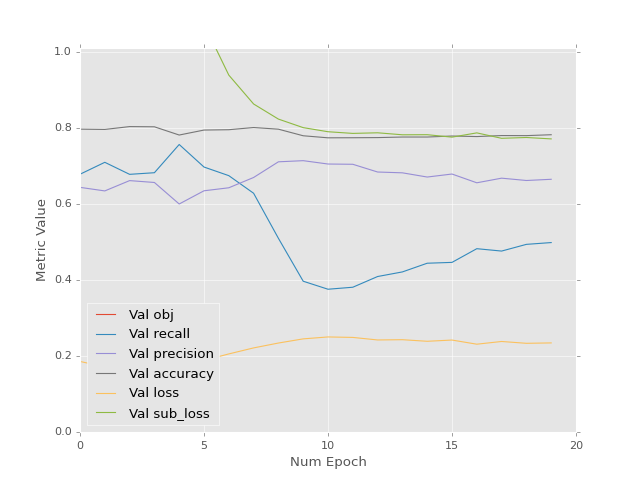

<IPython.core.display.Javascript object>


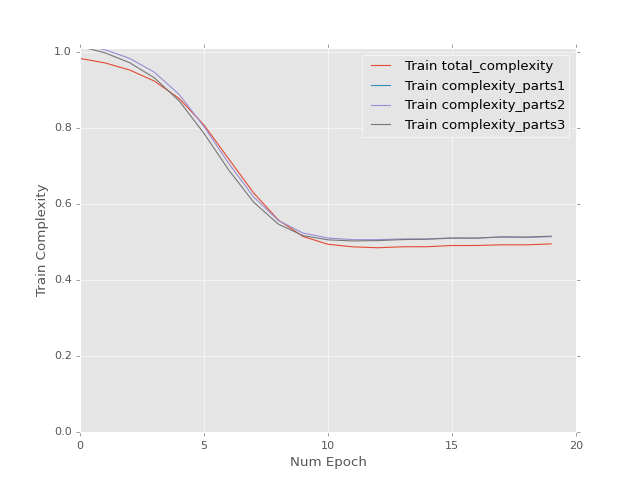

<IPython.core.display.Javascript object>


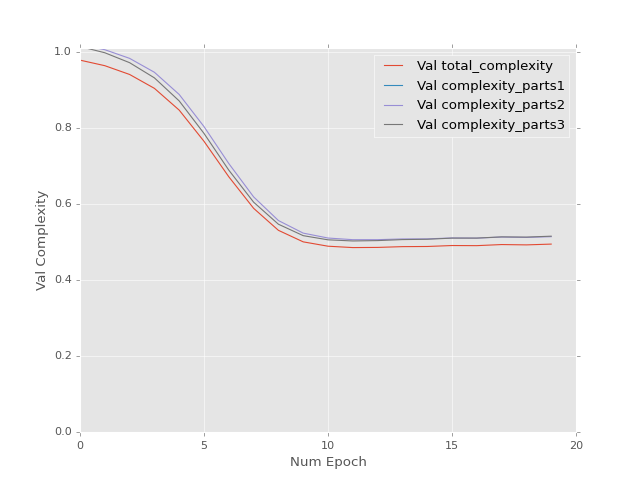

Epoch 1 of 20 took 5.974s
Epoch 2 of 20 took 5.958s
Epoch 3 of 20 took 5.940s
Epoch 4 of 20 took 6.086s
Epoch 5 of 20 took 6.105s
Epoch 6 of 20 took 6.027s
Epoch 7 of 20 took 6.133s
Epoch 8 of 20 took 6.008s
Epoch 9 of 20 took 6.041s
Epoch 10 of 20 took 6.187s
Epoch 11 of 20 took 6.008s
Epoch 12 of 20 took 6.108s
Epoch 13 of 20 took 6.425s
Epoch 14 of 20 took 6.060s
Epoch 15 of 20 took 5.850s
Epoch 16 of 20 took 6.014s
Epoch 17 of 20 took 6.136s
Epoch 18 of 20 took 6.128s
Epoch 19 of 20 took 6.120s
Epoch 20 of 20 took 6.011s


<IPython.core.display.Javascript object>


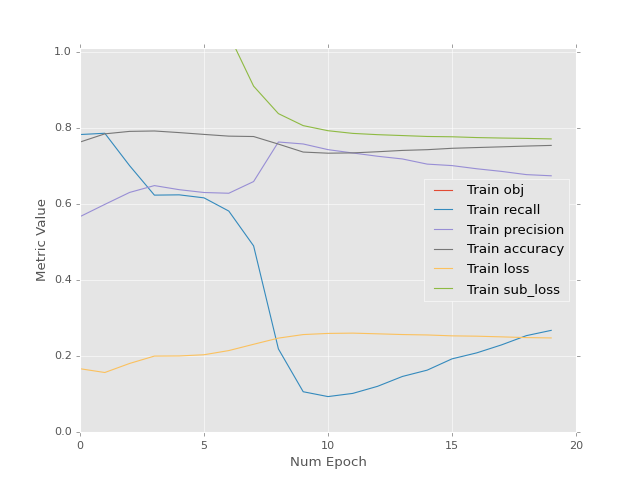

<IPython.core.display.Javascript object>


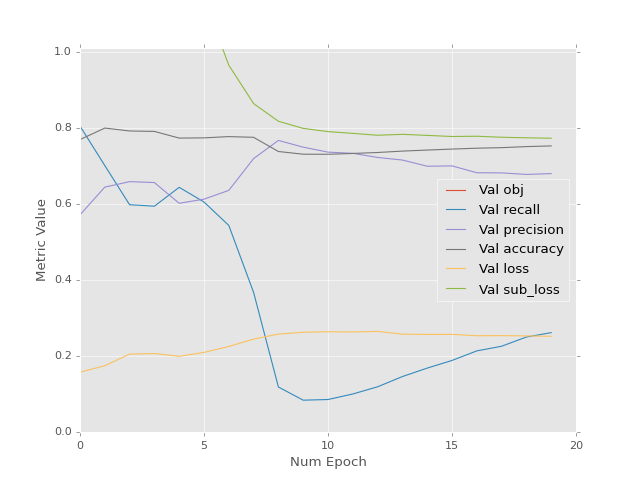

<IPython.core.display.Javascript object>


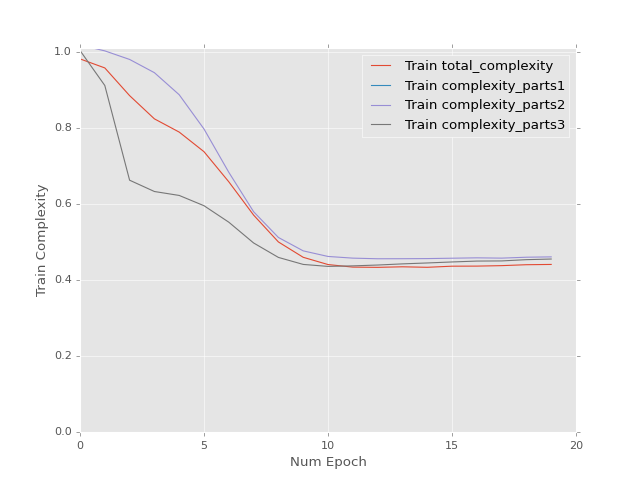

<IPython.core.display.Javascript object>


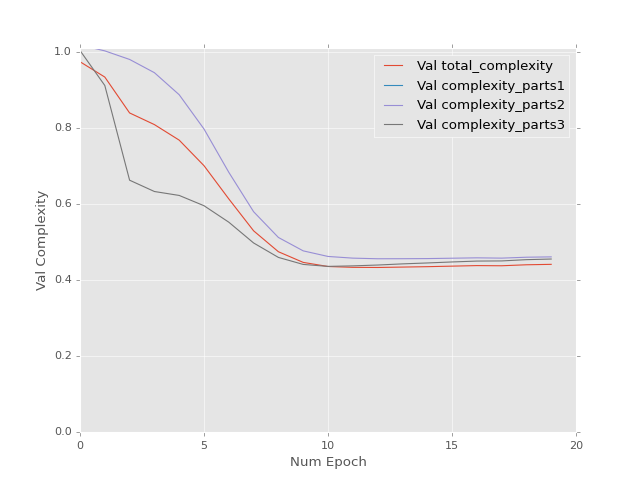

Epoch 1 of 20 took 6.090s
Epoch 2 of 20 took 6.125s
Epoch 3 of 20 took 6.141s
Epoch 4 of 20 took 5.732s
Epoch 5 of 20 took 6.033s
Epoch 6 of 20 took 6.023s
Epoch 7 of 20 took 5.967s
Epoch 8 of 20 took 6.003s
Epoch 9 of 20 took 6.073s
Epoch 10 of 20 took 6.110s
Epoch 11 of 20 took 6.015s
Epoch 12 of 20 took 6.027s
Epoch 13 of 20 took 6.022s
Epoch 14 of 20 took 6.112s
Epoch 15 of 20 took 5.985s
Epoch 16 of 20 took 5.957s
Epoch 17 of 20 took 5.960s
Epoch 18 of 20 took 5.977s
Epoch 19 of 20 took 6.153s
Epoch 20 of 20 took 5.847s


<IPython.core.display.Javascript object>


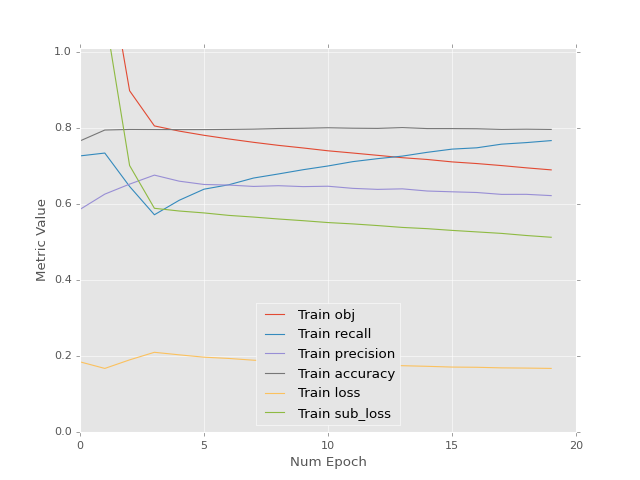

<IPython.core.display.Javascript object>


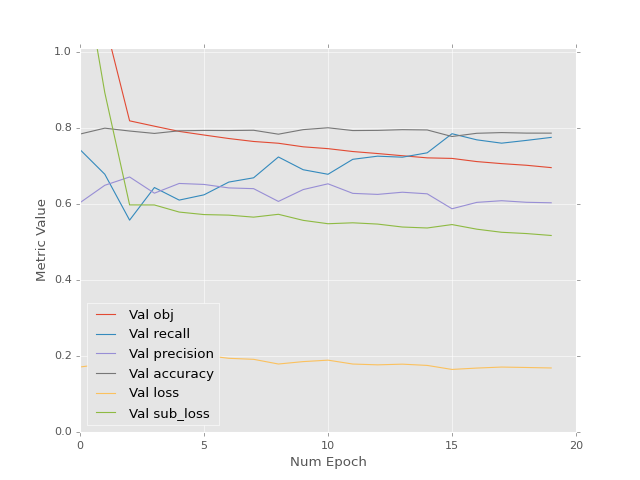

<IPython.core.display.Javascript object>


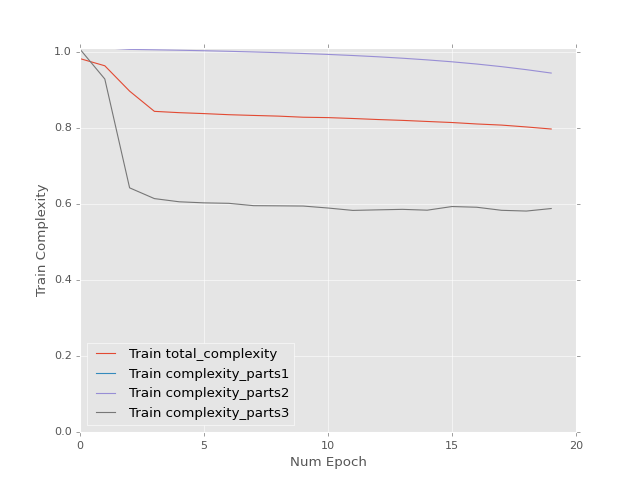

<IPython.core.display.Javascript object>


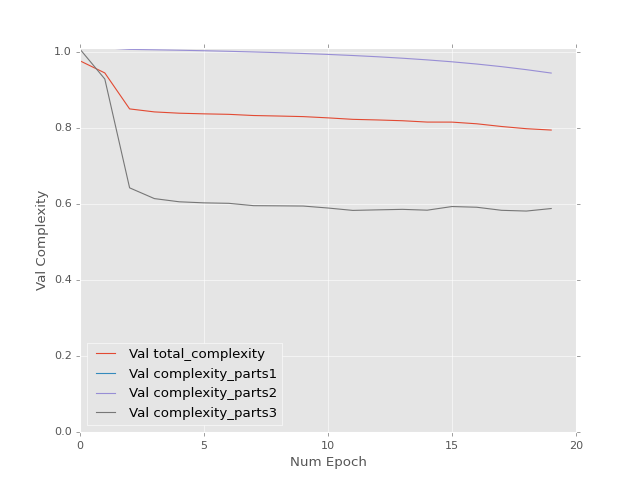

Epoch 1 of 20 took 6.031s
Epoch 2 of 20 took 5.862s
Epoch 3 of 20 took 6.069s
Epoch 4 of 20 took 5.944s
Epoch 5 of 20 took 6.005s
Epoch 6 of 20 took 6.162s
Epoch 7 of 20 took 6.017s
Epoch 8 of 20 took 6.107s
Epoch 9 of 20 took 6.008s
Epoch 10 of 20 took 6.021s
Epoch 11 of 20 took 5.988s
Epoch 12 of 20 took 5.909s
Epoch 13 of 20 took 5.908s
Epoch 14 of 20 took 5.945s
Epoch 15 of 20 took 5.853s
Epoch 16 of 20 took 5.855s
Epoch 17 of 20 took 5.858s
Epoch 18 of 20 took 5.997s
Epoch 19 of 20 took 6.089s
Epoch 20 of 20 took 6.003s


<IPython.core.display.Javascript object>


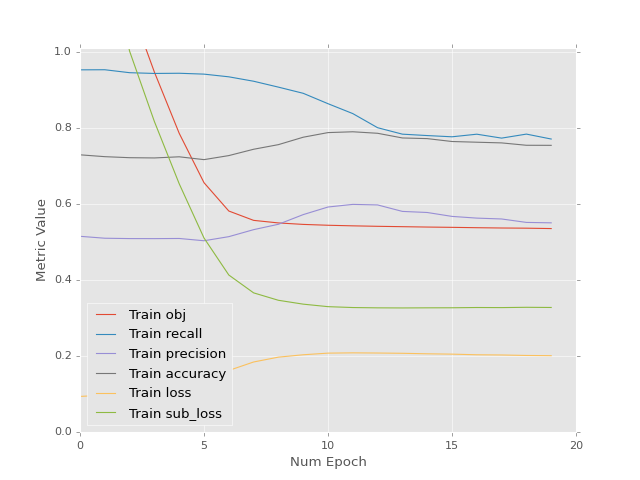

<IPython.core.display.Javascript object>


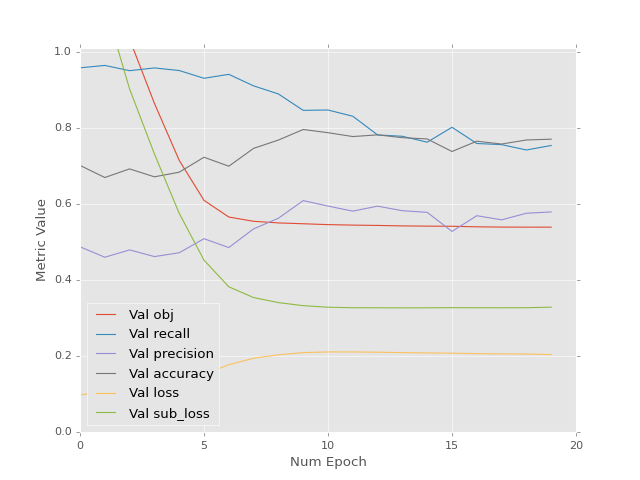

<IPython.core.display.Javascript object>


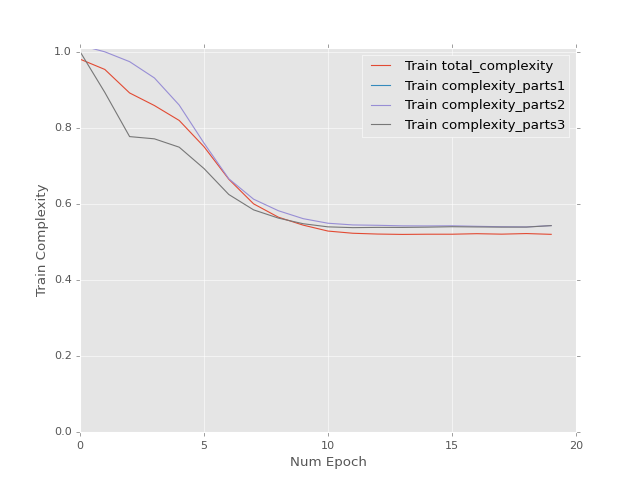

<IPython.core.display.Javascript object>


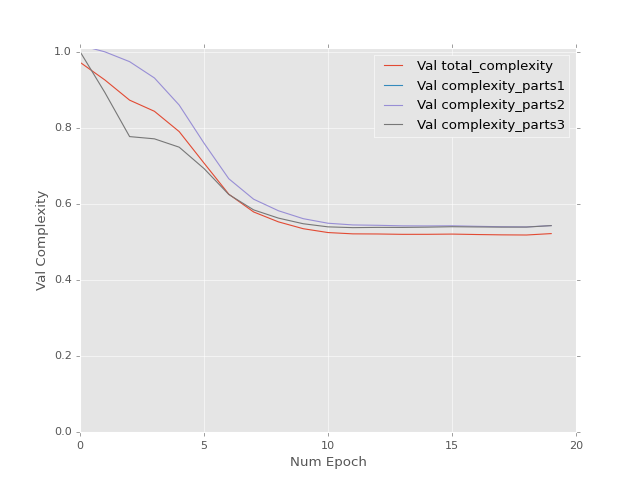

Epoch 1 of 20 took 5.961s
Epoch 2 of 20 took 6.138s
Epoch 3 of 20 took 6.152s
Epoch 4 of 20 took 6.084s
Epoch 5 of 20 took 6.111s
Epoch 6 of 20 took 6.001s
Epoch 7 of 20 took 6.006s
Epoch 8 of 20 took 6.066s
Epoch 9 of 20 took 5.998s
Epoch 10 of 20 took 6.088s
Epoch 11 of 20 took 6.003s
Epoch 12 of 20 took 5.936s
Epoch 13 of 20 took 6.033s
Epoch 14 of 20 took 6.060s
Epoch 15 of 20 took 6.001s
Epoch 16 of 20 took 5.983s
Epoch 17 of 20 took 6.007s
Epoch 18 of 20 took 5.943s
Epoch 19 of 20 took 5.845s
Epoch 20 of 20 took 5.990s


<IPython.core.display.Javascript object>


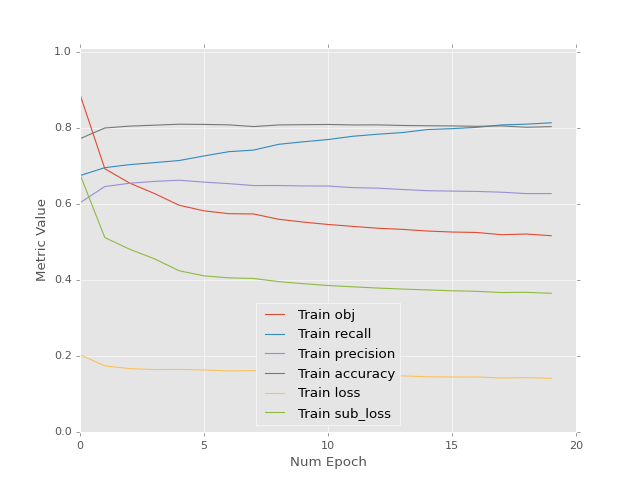

<IPython.core.display.Javascript object>


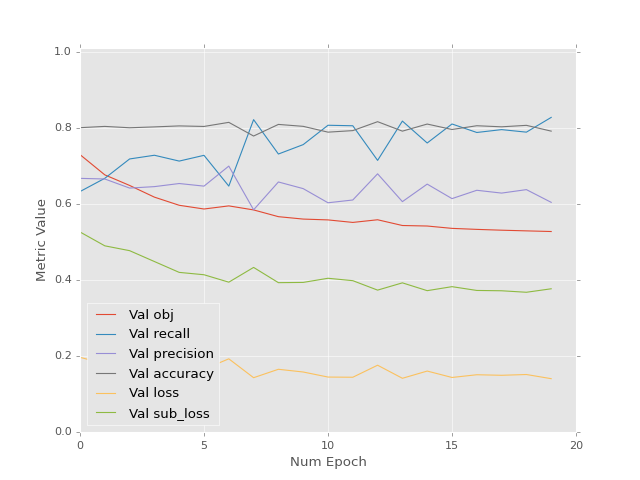

<IPython.core.display.Javascript object>


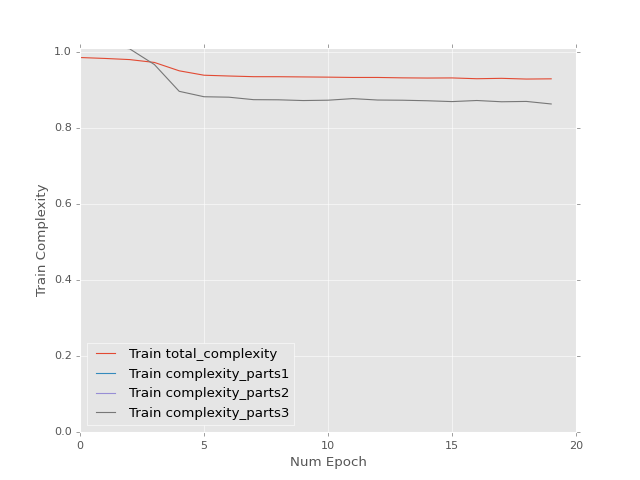

<IPython.core.display.Javascript object>


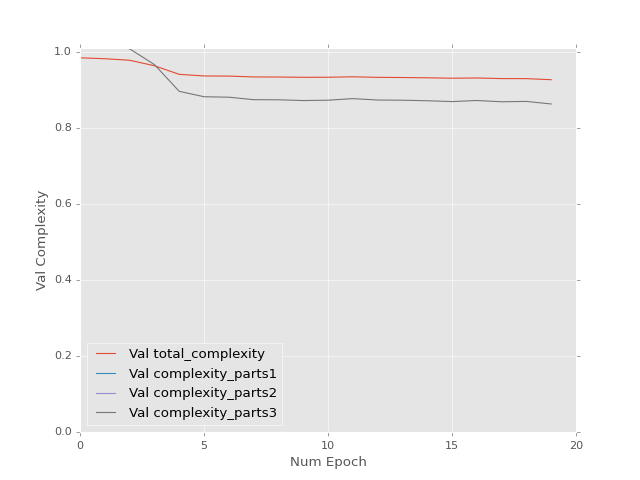

Epoch 1 of 20 took 5.988s
Epoch 2 of 20 took 5.921s
Epoch 3 of 20 took 6.019s
Epoch 4 of 20 took 6.012s
Epoch 5 of 20 took 6.041s
Epoch 6 of 20 took 5.840s
Epoch 7 of 20 took 5.937s
Epoch 8 of 20 took 6.185s
Epoch 9 of 20 took 6.110s
Epoch 10 of 20 took 5.956s
Epoch 11 of 20 took 6.161s
Epoch 12 of 20 took 5.867s
Epoch 13 of 20 took 6.111s
Epoch 14 of 20 took 6.029s
Epoch 15 of 20 took 6.140s
Epoch 16 of 20 took 6.333s
Epoch 17 of 20 took 6.015s
Epoch 18 of 20 took 6.023s
Epoch 19 of 20 took 6.074s
Epoch 20 of 20 took 6.122s


<IPython.core.display.Javascript object>


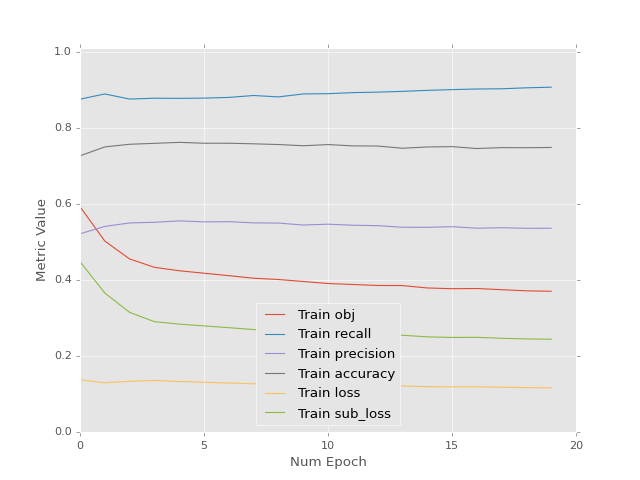

<IPython.core.display.Javascript object>


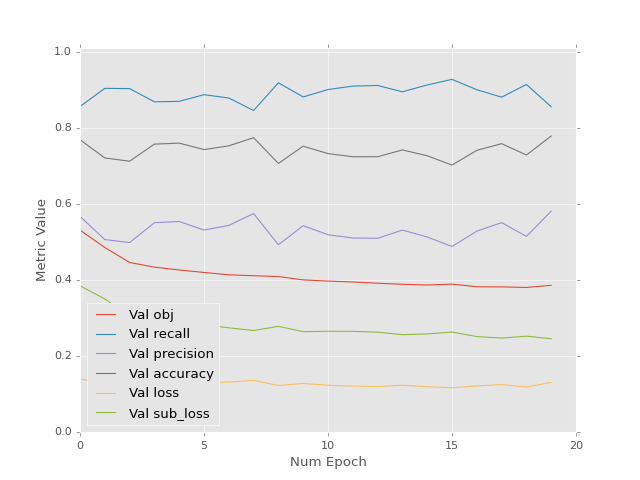

<IPython.core.display.Javascript object>


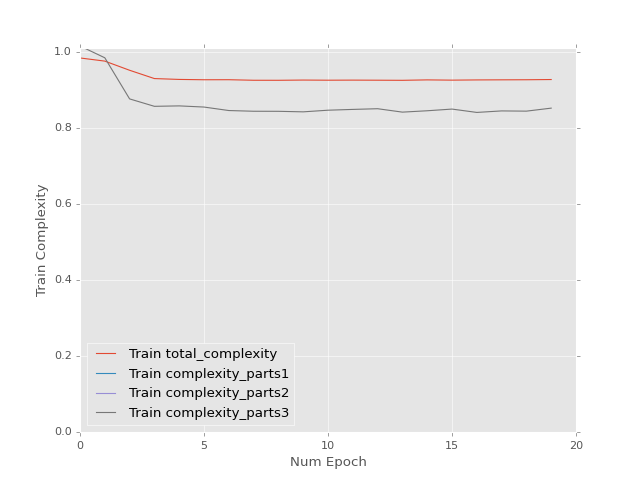

<IPython.core.display.Javascript object>


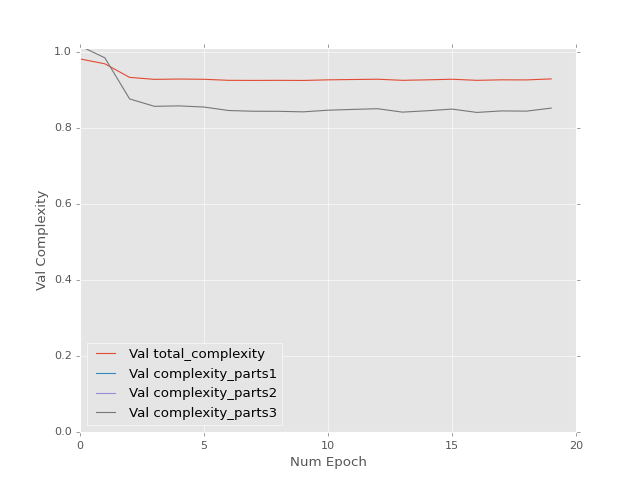

Epoch 1 of 20 took 5.692s
Epoch 2 of 20 took 6.061s
Epoch 3 of 20 took 6.098s
Epoch 4 of 20 took 6.120s
Epoch 5 of 20 took 6.064s
Epoch 6 of 20 took 6.112s
Epoch 7 of 20 took 6.068s
Epoch 8 of 20 took 6.062s
Epoch 9 of 20 took 5.955s
Epoch 10 of 20 took 5.823s
Epoch 11 of 20 took 5.937s
Epoch 12 of 20 took 6.133s
Epoch 13 of 20 took 6.425s
Epoch 14 of 20 took 6.086s
Epoch 15 of 20 took 5.979s
Epoch 16 of 20 took 6.097s
Epoch 17 of 20 took 5.971s
Epoch 18 of 20 took 5.917s
Epoch 19 of 20 took 5.884s
Epoch 20 of 20 took 5.848s


<IPython.core.display.Javascript object>


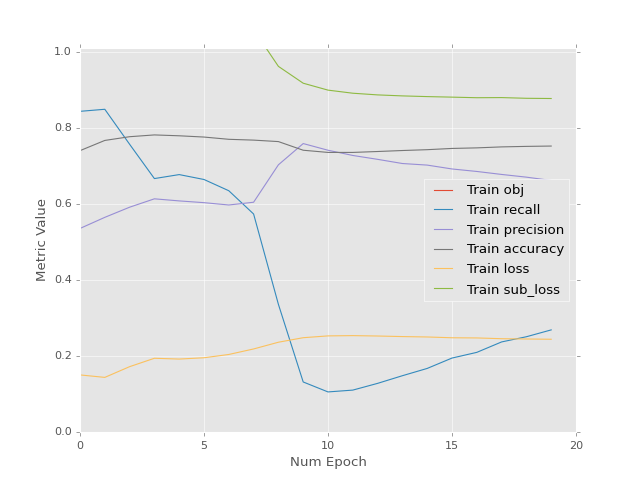

<IPython.core.display.Javascript object>


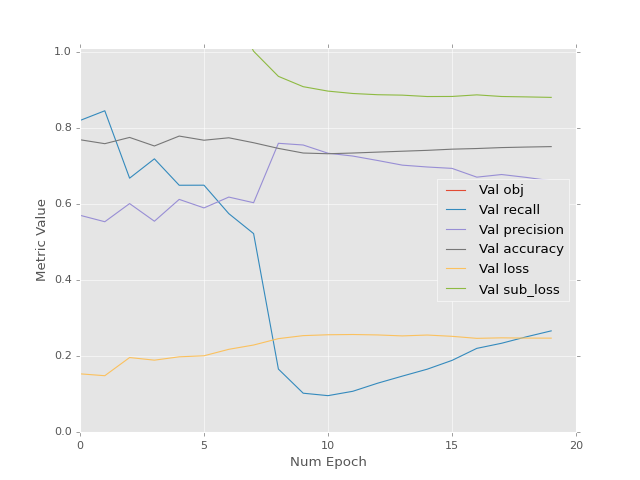

<IPython.core.display.Javascript object>


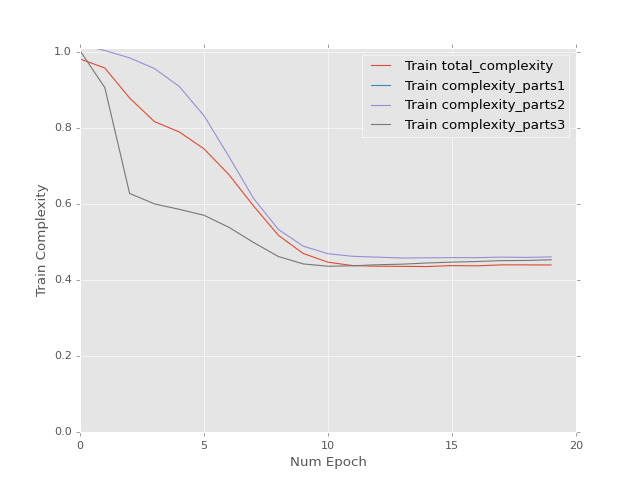

<IPython.core.display.Javascript object>


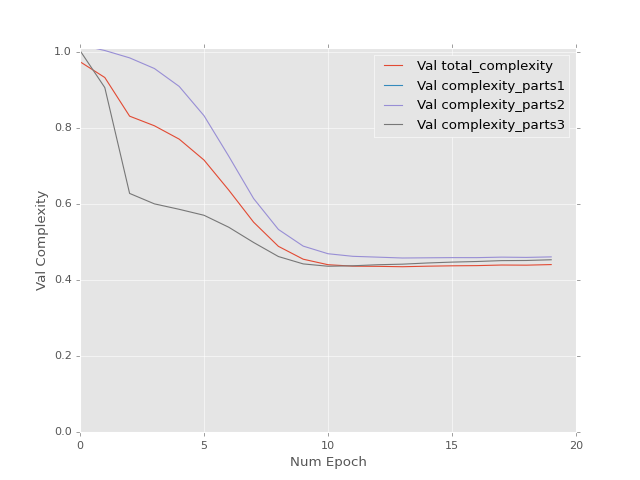

Epoch 1 of 20 took 5.950s
Epoch 2 of 20 took 5.952s
Epoch 3 of 20 took 5.931s
Epoch 4 of 20 took 5.999s
Epoch 5 of 20 took 5.983s
Epoch 6 of 20 took 5.847s
Epoch 7 of 20 took 6.087s
Epoch 8 of 20 took 5.956s
Epoch 9 of 20 took 6.082s
Epoch 10 of 20 took 6.047s
Epoch 11 of 20 took 6.091s
Epoch 12 of 20 took 5.938s
Epoch 13 of 20 took 6.013s
Epoch 14 of 20 took 6.005s
Epoch 15 of 20 took 6.001s
Epoch 16 of 20 took 6.000s
Epoch 17 of 20 took 6.038s
Epoch 18 of 20 took 6.254s
Epoch 19 of 20 took 6.093s
Epoch 20 of 20 took 6.138s


<IPython.core.display.Javascript object>


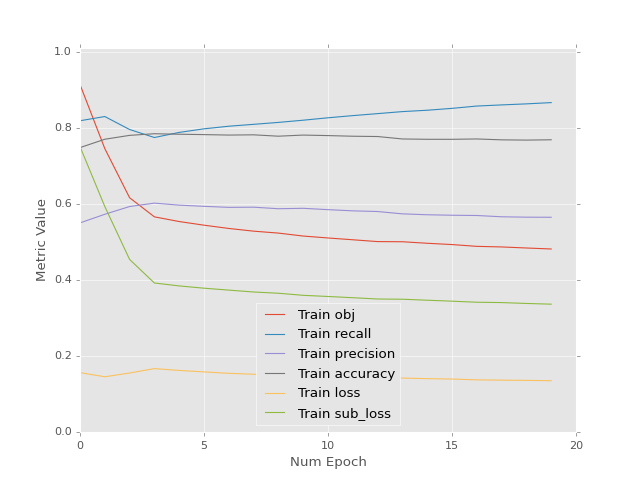

<IPython.core.display.Javascript object>


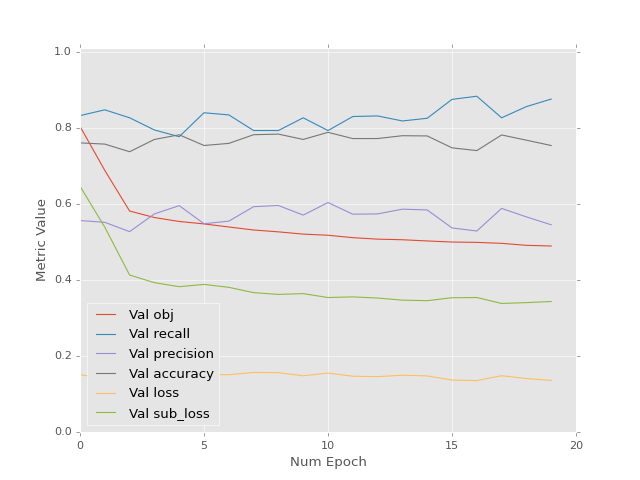

<IPython.core.display.Javascript object>


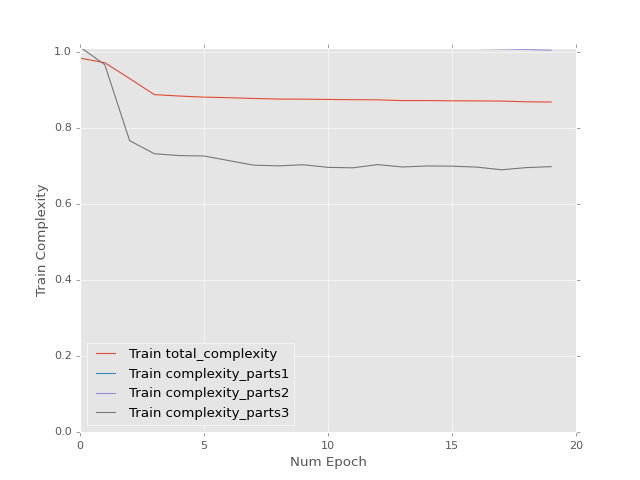

<IPython.core.display.Javascript object>


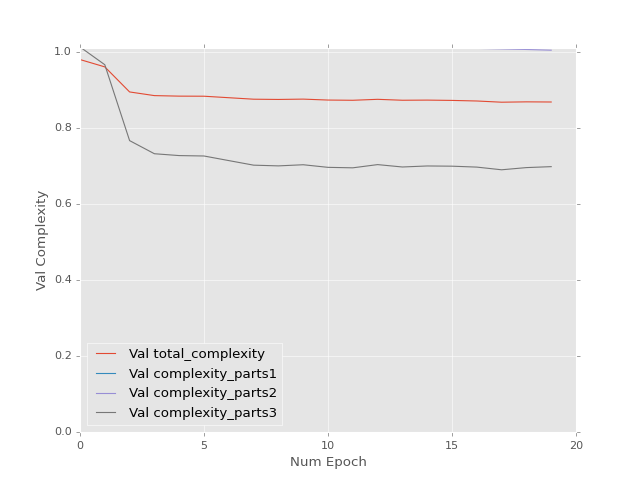

Epoch 1 of 20 took 6.071s
Epoch 2 of 20 took 5.922s
Epoch 3 of 20 took 6.059s
Epoch 4 of 20 took 5.909s
Epoch 5 of 20 took 6.044s
Epoch 6 of 20 took 6.033s
Epoch 7 of 20 took 5.951s
Epoch 8 of 20 took 5.913s
Epoch 9 of 20 took 5.849s
Epoch 10 of 20 took 5.849s
Epoch 11 of 20 took 5.955s
Epoch 12 of 20 took 6.199s
Epoch 13 of 20 took 5.864s
Epoch 14 of 20 took 6.127s
Epoch 15 of 20 took 5.859s
Epoch 16 of 20 took 6.130s
Epoch 17 of 20 took 5.983s
Epoch 18 of 20 took 5.933s
Epoch 19 of 20 took 5.959s
Epoch 20 of 20 took 6.028s


<IPython.core.display.Javascript object>


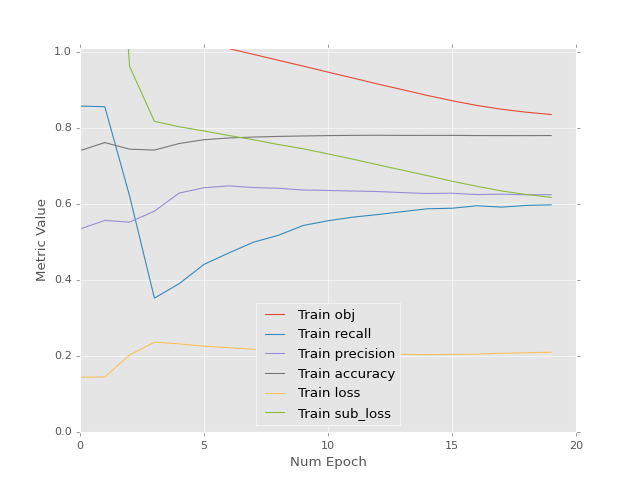

<IPython.core.display.Javascript object>


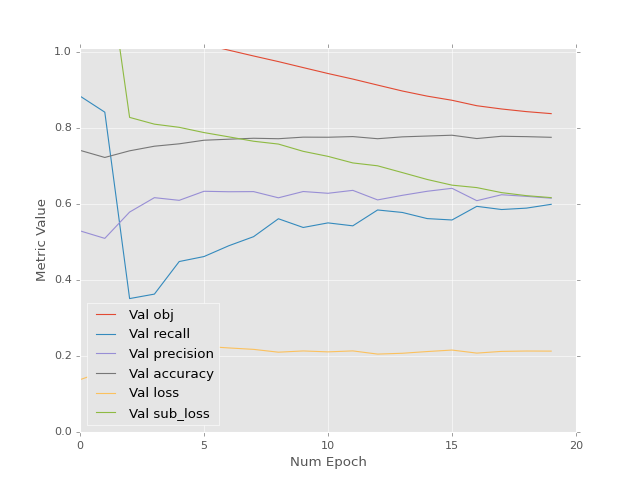

<IPython.core.display.Javascript object>


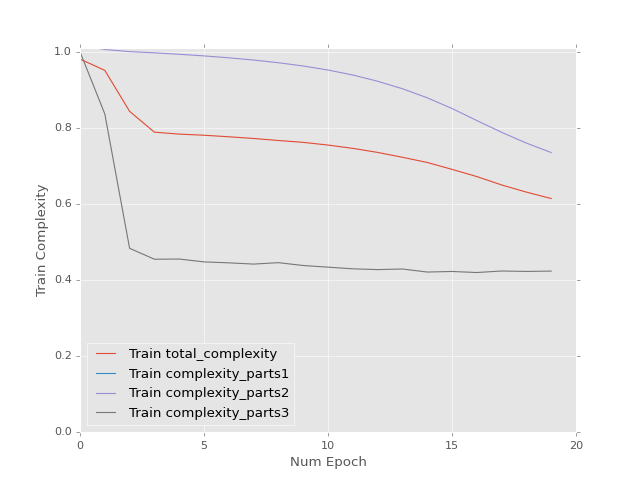

<IPython.core.display.Javascript object>


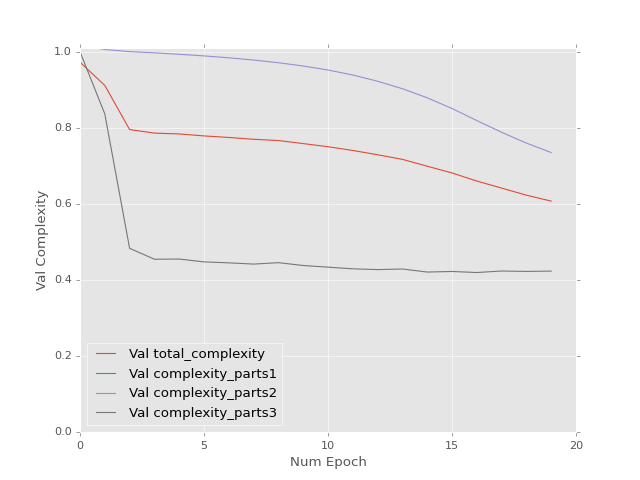

Epoch 1 of 20 took 5.949s
Epoch 2 of 20 took 6.365s
Epoch 3 of 20 took 6.211s
Epoch 4 of 20 took 6.011s
Epoch 5 of 20 took 6.100s
Epoch 6 of 20 took 6.072s
Epoch 7 of 20 took 5.843s
Epoch 8 of 20 took 5.974s
Epoch 9 of 20 took 6.223s
Epoch 10 of 20 took 6.024s
Epoch 11 of 20 took 6.000s
Epoch 12 of 20 took 5.943s
Epoch 13 of 20 took 5.967s
Epoch 14 of 20 took 6.034s
Epoch 15 of 20 took 5.936s
Epoch 16 of 20 took 6.001s
Epoch 17 of 20 took 5.849s
Epoch 18 of 20 took 5.849s
Epoch 19 of 20 took 5.858s
Epoch 20 of 20 took 6.125s


<IPython.core.display.Javascript object>


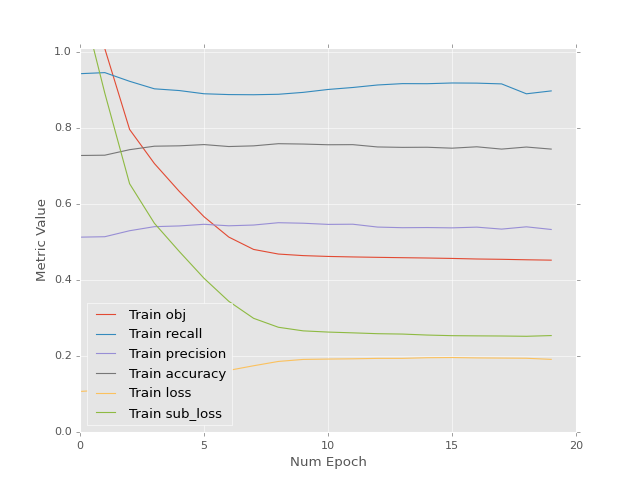

<IPython.core.display.Javascript object>


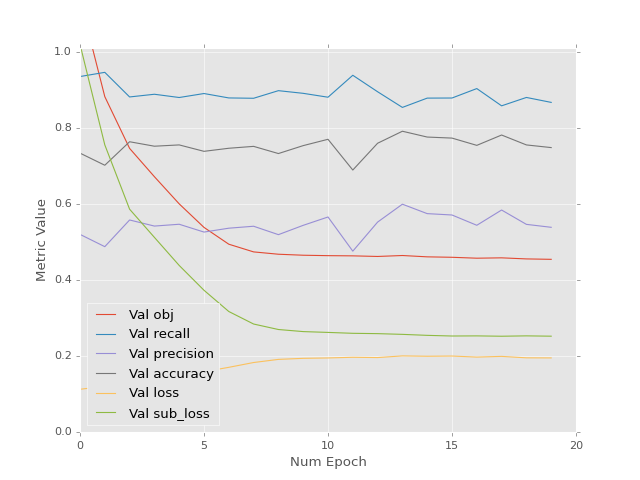

<IPython.core.display.Javascript object>


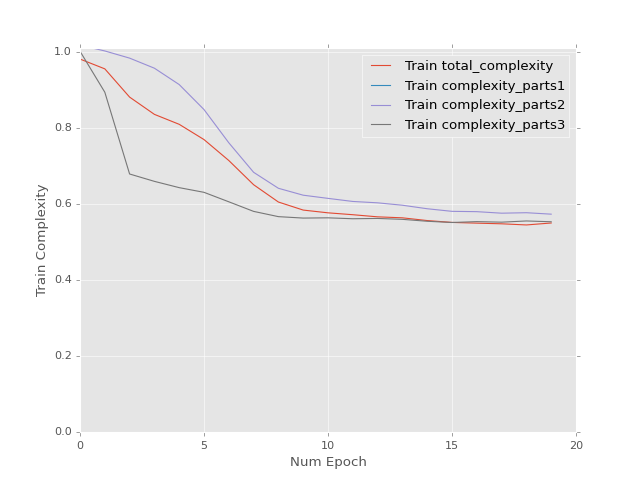

<IPython.core.display.Javascript object>


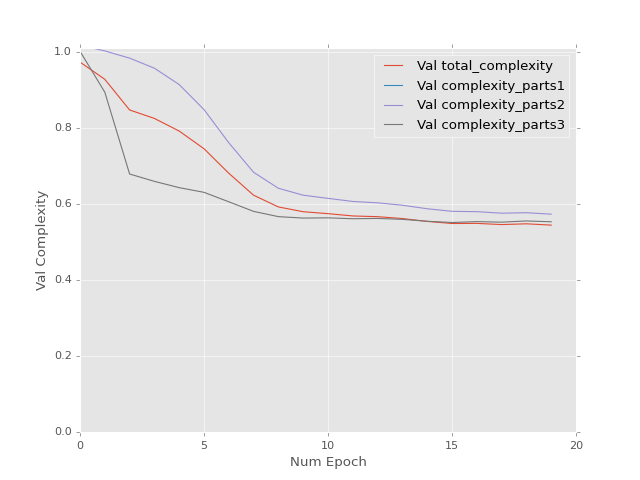

Epoch 1 of 20 took 5.961s
Epoch 2 of 20 took 5.936s
Epoch 3 of 20 took 6.009s
Epoch 4 of 20 took 6.015s
Epoch 5 of 20 took 6.141s
Epoch 6 of 20 took 6.011s
Epoch 7 of 20 took 6.004s
Epoch 8 of 20 took 6.011s
Epoch 9 of 20 took 5.898s
Epoch 10 of 20 took 5.850s
Epoch 11 of 20 took 5.856s
Epoch 12 of 20 took 5.956s
Epoch 13 of 20 took 5.979s
Epoch 14 of 20 took 5.953s
Epoch 15 of 20 took 5.988s
Epoch 16 of 20 took 5.889s
Epoch 17 of 20 took 6.256s
Epoch 18 of 20 took 6.196s
Epoch 19 of 20 took 5.851s
Epoch 20 of 20 took 5.968s


<IPython.core.display.Javascript object>


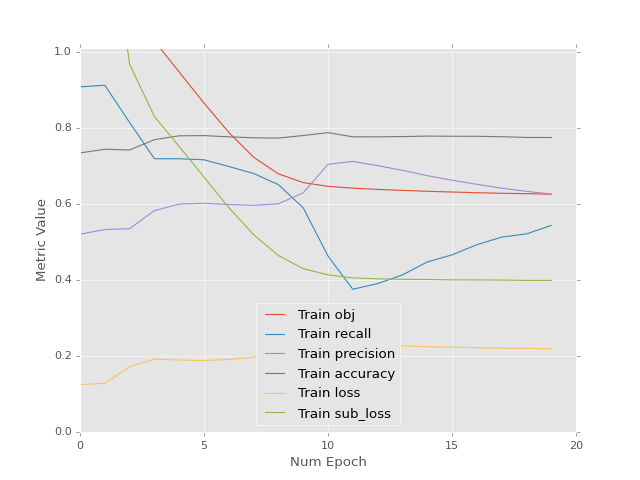

<IPython.core.display.Javascript object>


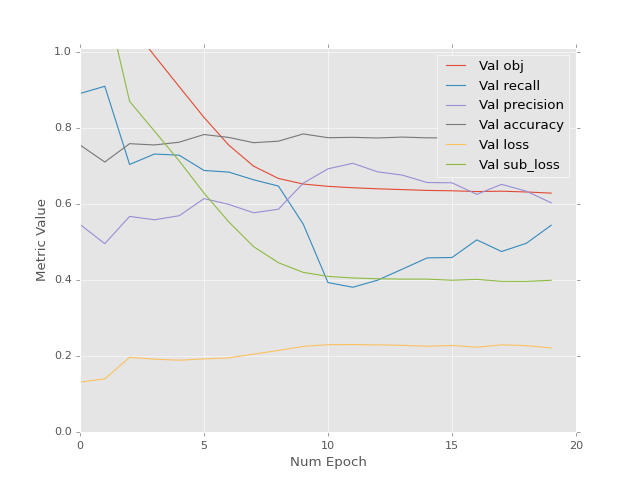

<IPython.core.display.Javascript object>


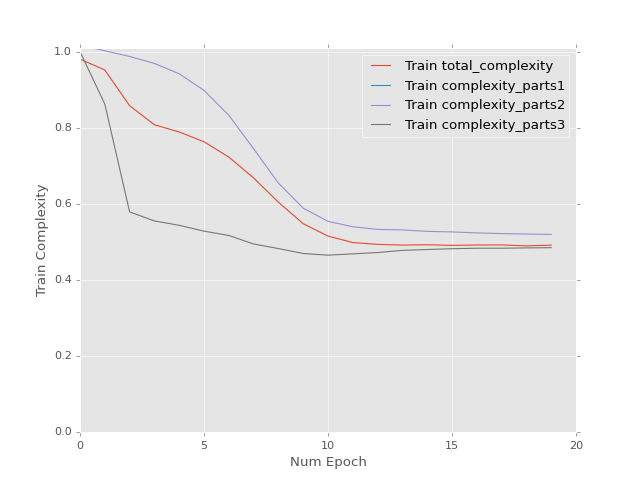

<IPython.core.display.Javascript object>


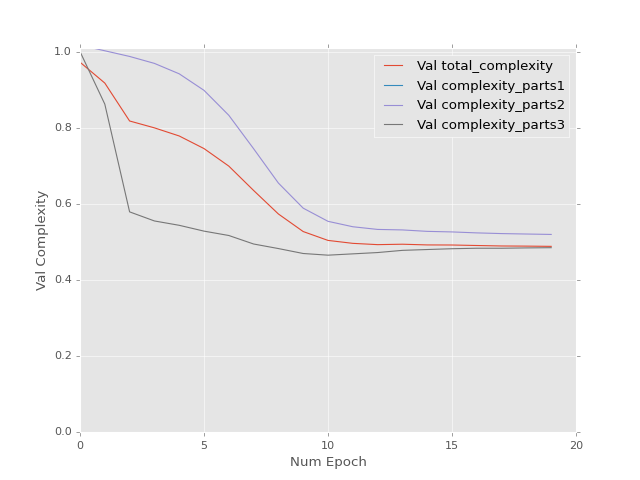

Epoch 1 of 20 took 6.078s
Epoch 2 of 20 took 5.926s
Epoch 3 of 20 took 5.979s
Epoch 4 of 20 took 5.981s
Epoch 5 of 20 took 6.038s
Epoch 6 of 20 took 6.062s
Epoch 7 of 20 took 6.153s
Epoch 8 of 20 took 6.193s
Epoch 9 of 20 took 6.066s
Epoch 10 of 20 took 6.478s
Epoch 11 of 20 took 5.967s
Epoch 12 of 20 took 5.893s
Epoch 13 of 20 took 5.864s
Epoch 14 of 20 took 6.235s
Epoch 15 of 20 took 5.925s
Epoch 16 of 20 took 6.023s
Epoch 17 of 20 took 6.048s
Epoch 18 of 20 took 6.070s
Epoch 19 of 20 took 5.920s
Epoch 20 of 20 took 5.881s


<IPython.core.display.Javascript object>


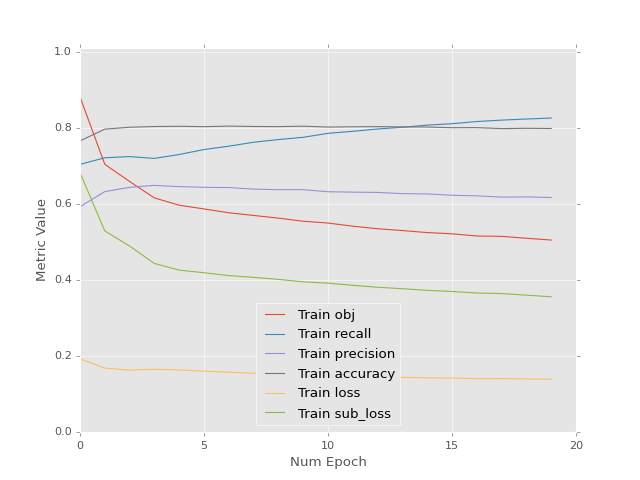

<IPython.core.display.Javascript object>


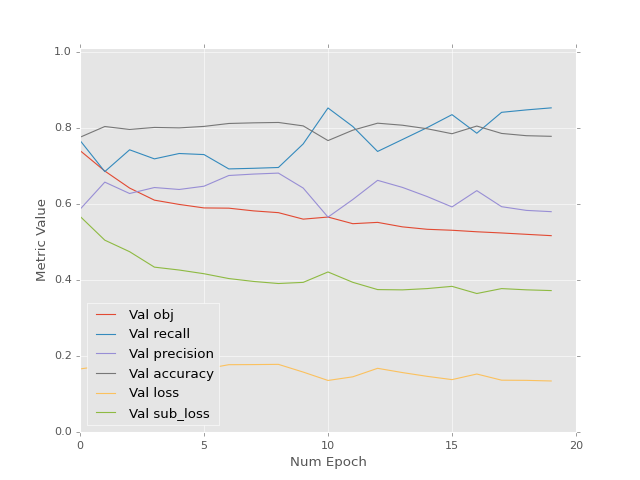

<IPython.core.display.Javascript object>


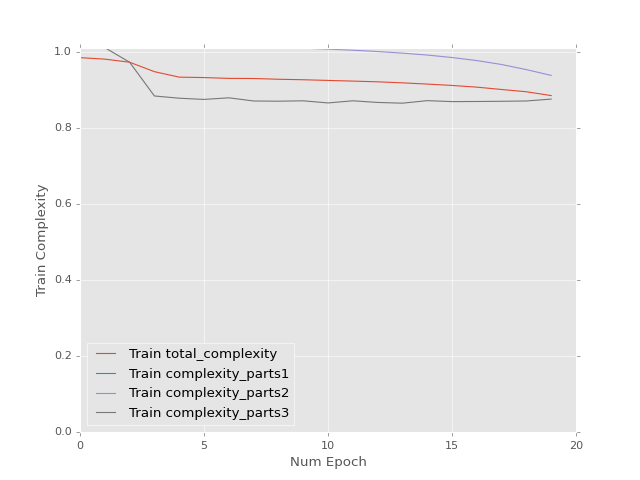

<IPython.core.display.Javascript object>


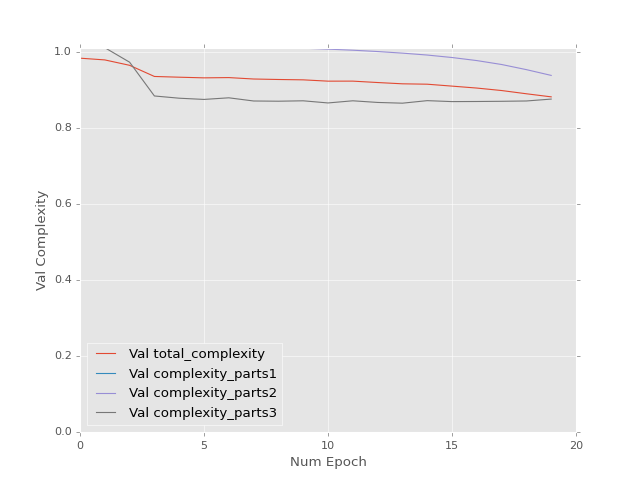

Epoch 1 of 20 took 6.095s
Epoch 2 of 20 took 5.923s
Epoch 3 of 20 took 6.178s
Epoch 4 of 20 took 6.090s
Epoch 5 of 20 took 6.035s
Epoch 6 of 20 took 6.163s
Epoch 7 of 20 took 5.756s
Epoch 8 of 20 took 6.264s
Epoch 9 of 20 took 5.953s
Epoch 10 of 20 took 6.041s
Epoch 11 of 20 took 6.227s
Epoch 12 of 20 took 6.102s
Epoch 13 of 20 took 6.118s
Epoch 14 of 20 took 6.221s
Epoch 15 of 20 took 6.213s
Epoch 16 of 20 took 6.048s
Epoch 17 of 20 took 6.274s
Epoch 18 of 20 took 6.089s
Epoch 19 of 20 took 6.128s
Epoch 20 of 20 took 6.113s


<IPython.core.display.Javascript object>


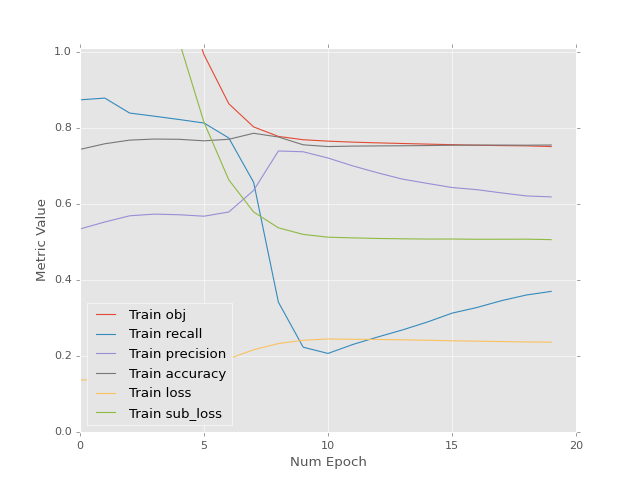

<IPython.core.display.Javascript object>


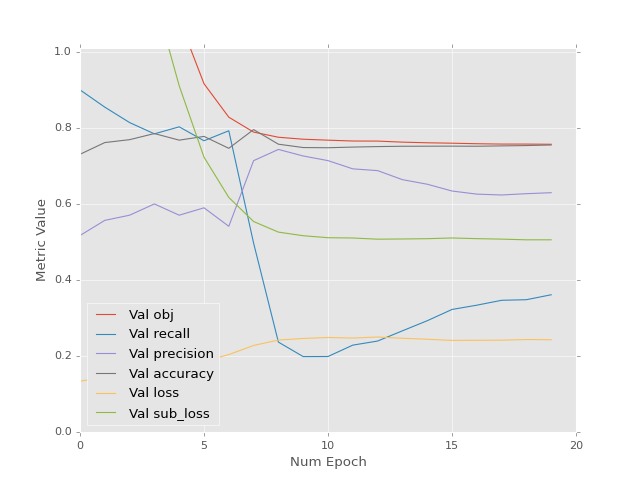

<IPython.core.display.Javascript object>


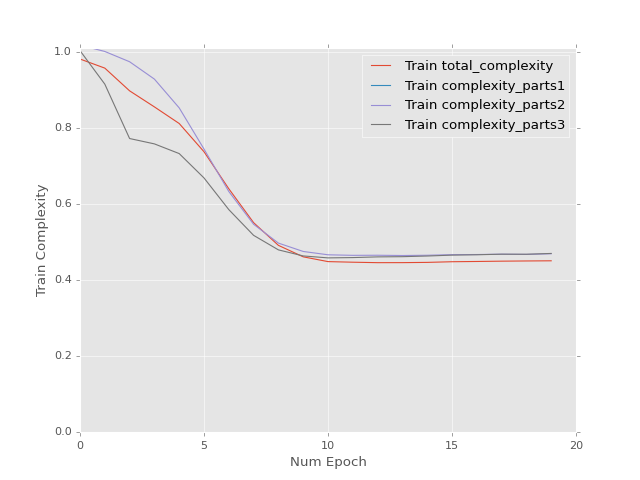

<IPython.core.display.Javascript object>


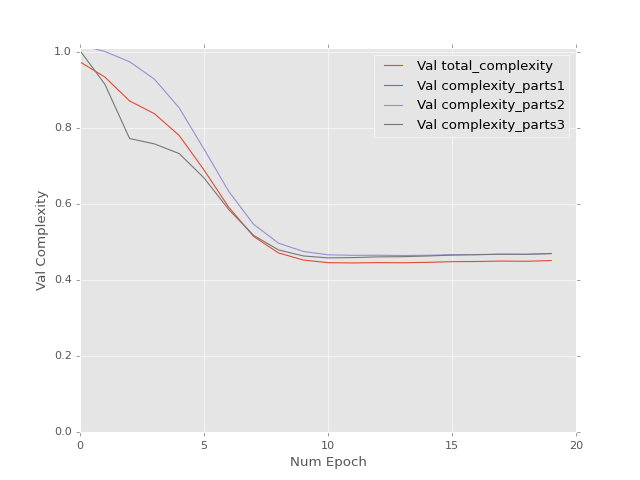

Epoch 1 of 20 took 5.868s
Epoch 2 of 20 took 5.944s
Epoch 3 of 20 took 6.172s
Epoch 4 of 20 took 6.146s
Epoch 5 of 20 took 6.057s
Epoch 6 of 20 took 6.164s
Epoch 7 of 20 took 6.219s
Epoch 8 of 20 took 5.969s
Epoch 9 of 20 took 6.022s
Epoch 10 of 20 took 6.119s
Epoch 11 of 20 took 6.114s
Epoch 12 of 20 took 5.962s
Epoch 13 of 20 took 6.126s
Epoch 14 of 20 took 6.112s
Epoch 15 of 20 took 5.950s
Epoch 16 of 20 took 6.079s
Epoch 17 of 20 took 6.151s
Epoch 18 of 20 took 6.233s
Epoch 19 of 20 took 6.211s
Epoch 20 of 20 took 5.951s


<IPython.core.display.Javascript object>


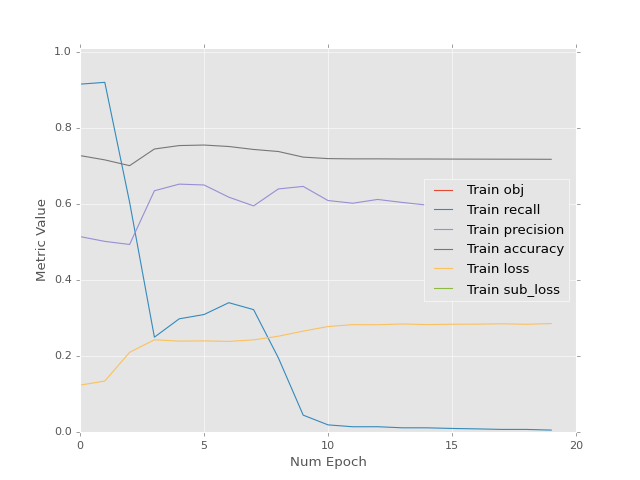

<IPython.core.display.Javascript object>


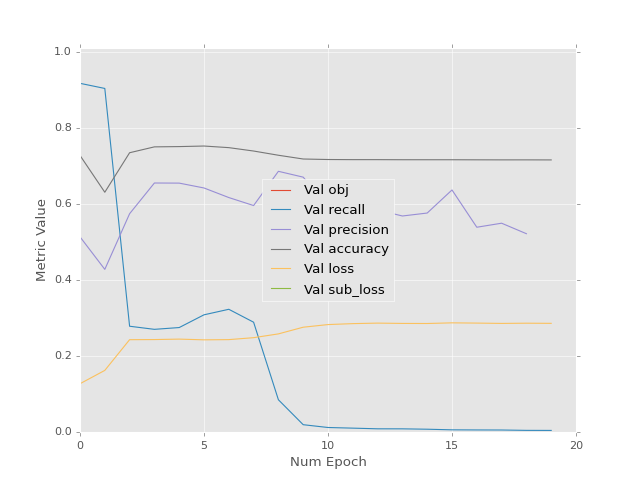

<IPython.core.display.Javascript object>


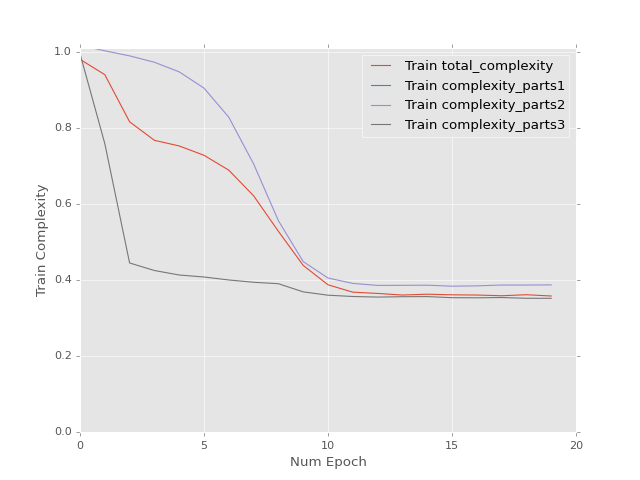

<IPython.core.display.Javascript object>


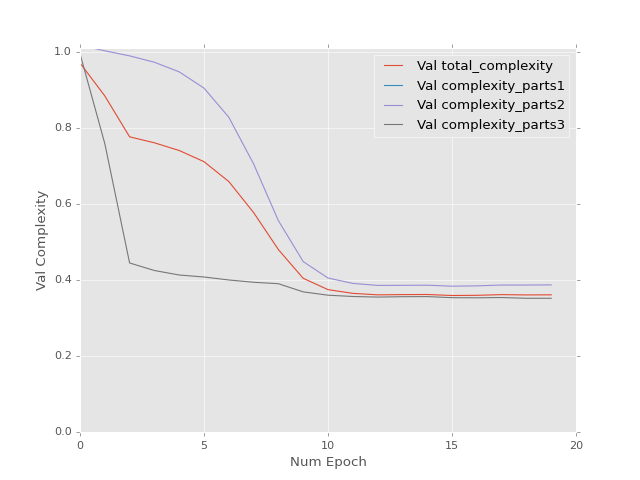

Epoch 1 of 20 took 5.611s
Epoch 2 of 20 took 6.119s
Epoch 3 of 20 took 6.214s
Epoch 4 of 20 took 5.748s
Epoch 5 of 20 took 6.133s
Epoch 6 of 20 took 6.021s
Epoch 7 of 20 took 6.070s
Epoch 8 of 20 took 6.095s
Epoch 9 of 20 took 6.142s
Epoch 10 of 20 took 6.035s
Epoch 11 of 20 took 6.039s
Epoch 12 of 20 took 6.033s
Epoch 13 of 20 took 5.947s
Epoch 14 of 20 took 5.849s
Epoch 15 of 20 took 5.853s
Epoch 16 of 20 took 5.966s
Epoch 17 of 20 took 6.104s
Epoch 18 of 20 took 5.922s
Epoch 19 of 20 took 5.992s
Epoch 20 of 20 took 5.960s


<IPython.core.display.Javascript object>


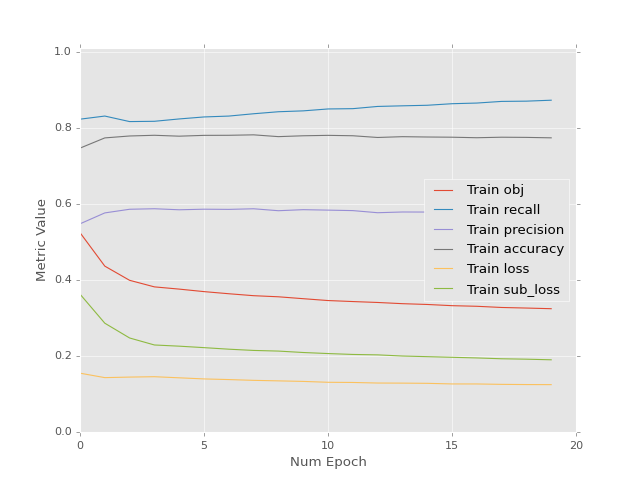

<IPython.core.display.Javascript object>


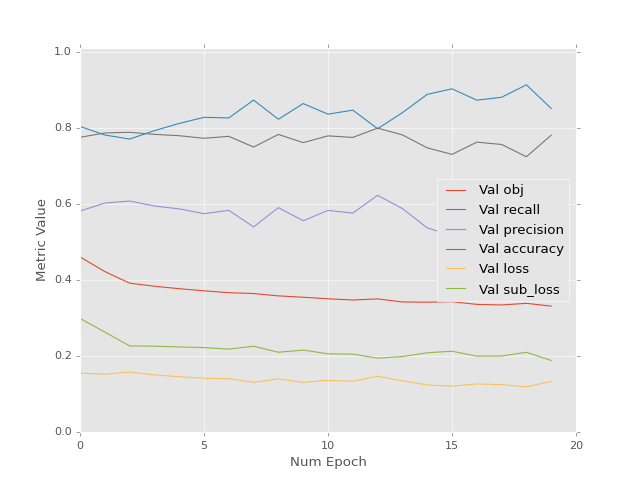

<IPython.core.display.Javascript object>


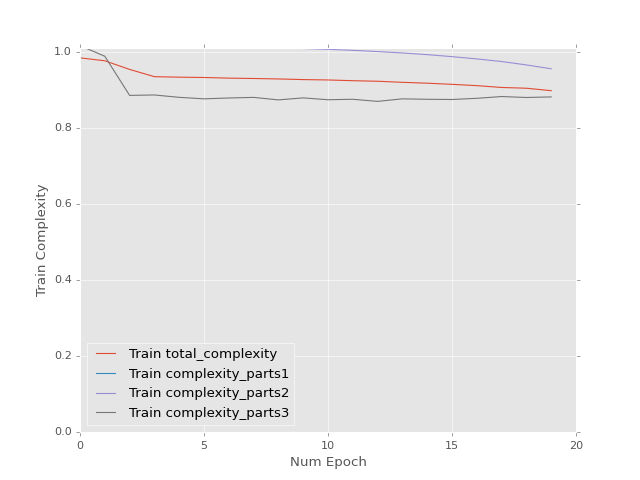

<IPython.core.display.Javascript object>


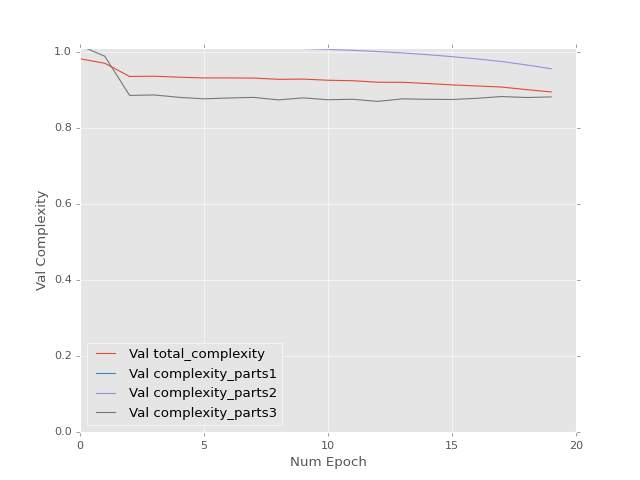

Epoch 1 of 20 took 6.017s
Epoch 2 of 20 took 6.040s
Epoch 3 of 20 took 5.889s
Epoch 4 of 20 took 6.050s
Epoch 5 of 20 took 6.016s
Epoch 6 of 20 took 6.161s
Epoch 7 of 20 took 5.763s
Epoch 8 of 20 took 6.210s
Epoch 9 of 20 took 6.177s
Epoch 10 of 20 took 6.115s
Epoch 11 of 20 took 6.149s
Epoch 12 of 20 took 5.866s
Epoch 13 of 20 took 5.959s
Epoch 14 of 20 took 6.132s
Epoch 15 of 20 took 5.923s
Epoch 16 of 20 took 6.035s
Epoch 17 of 20 took 5.957s
Epoch 18 of 20 took 6.296s
Epoch 19 of 20 took 5.945s
Epoch 20 of 20 took 5.851s


<IPython.core.display.Javascript object>


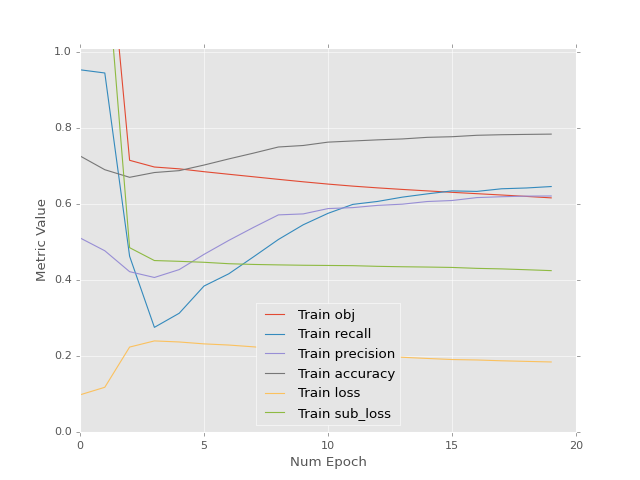

<IPython.core.display.Javascript object>


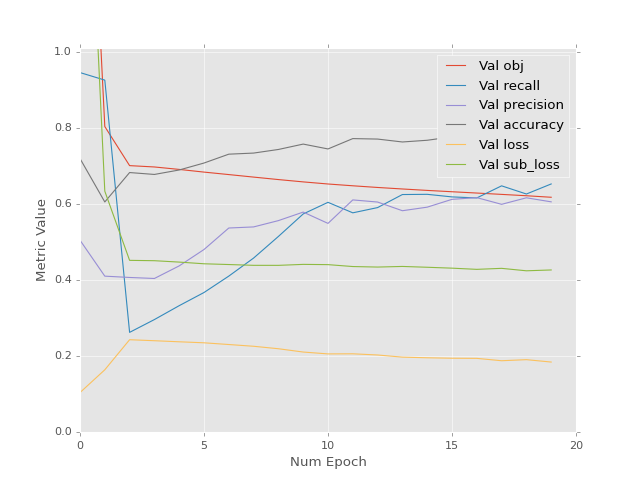

<IPython.core.display.Javascript object>


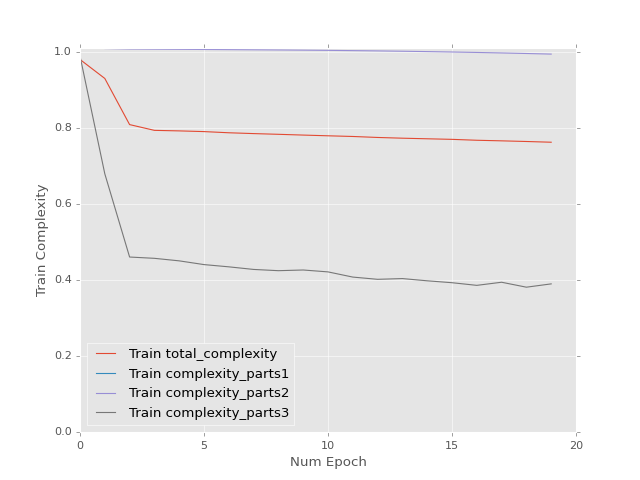

<IPython.core.display.Javascript object>


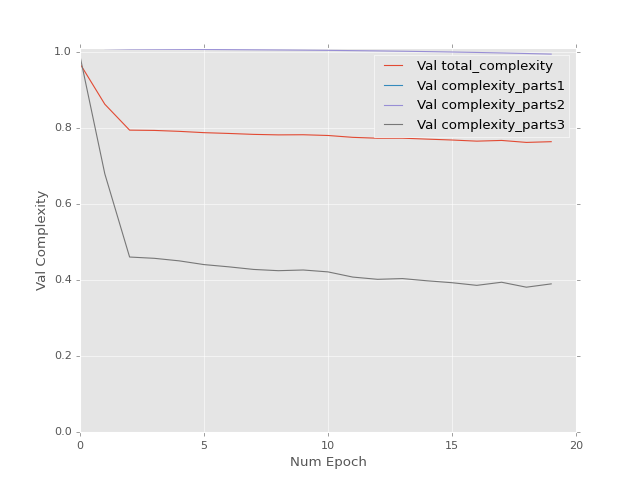

Epoch 1 of 20 took 6.319s
Epoch 2 of 20 took 5.726s
Epoch 3 of 20 took 6.007s
Epoch 4 of 20 took 6.013s
Epoch 5 of 20 took 6.152s
Epoch 6 of 20 took 5.786s
Epoch 7 of 20 took 5.813s
Epoch 8 of 20 took 6.057s
Epoch 9 of 20 took 6.313s
Epoch 10 of 20 took 6.205s
Epoch 11 of 20 took 5.773s
Epoch 12 of 20 took 5.764s
Epoch 13 of 20 took 5.855s
Epoch 14 of 20 took 5.746s
Epoch 15 of 20 took 5.961s
Epoch 16 of 20 took 5.818s
Epoch 17 of 20 took 6.373s
Epoch 18 of 20 took 6.021s
Epoch 19 of 20 took 6.344s
Epoch 20 of 20 took 6.507s


<IPython.core.display.Javascript object>


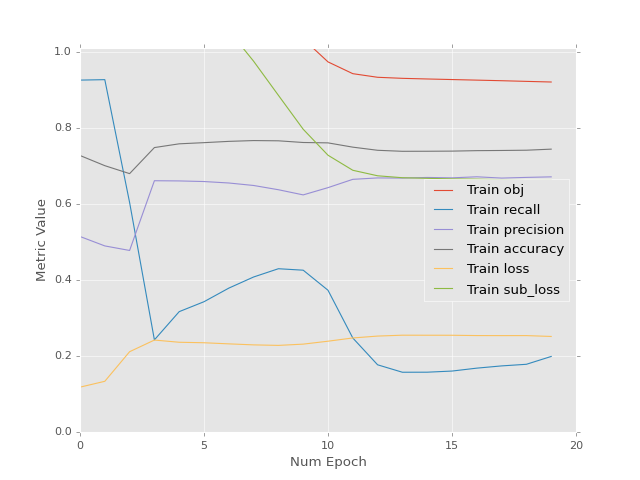

<IPython.core.display.Javascript object>


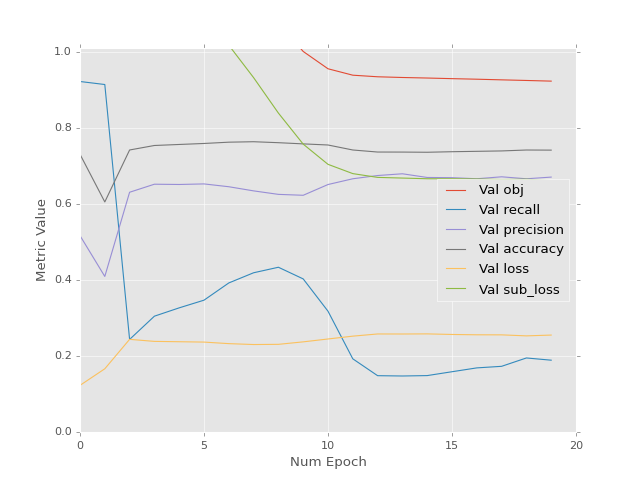

<IPython.core.display.Javascript object>


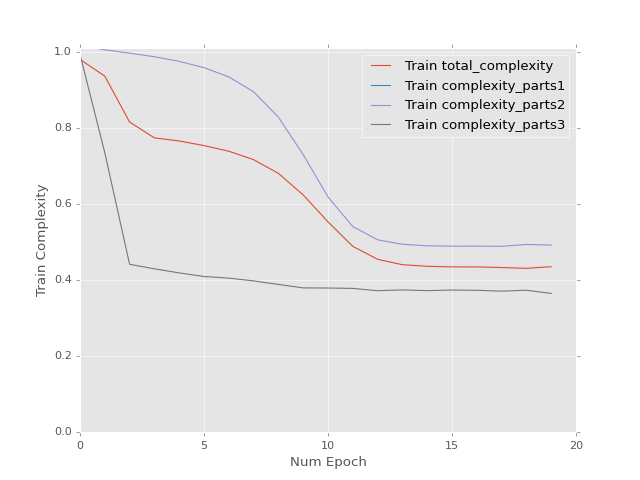

<IPython.core.display.Javascript object>


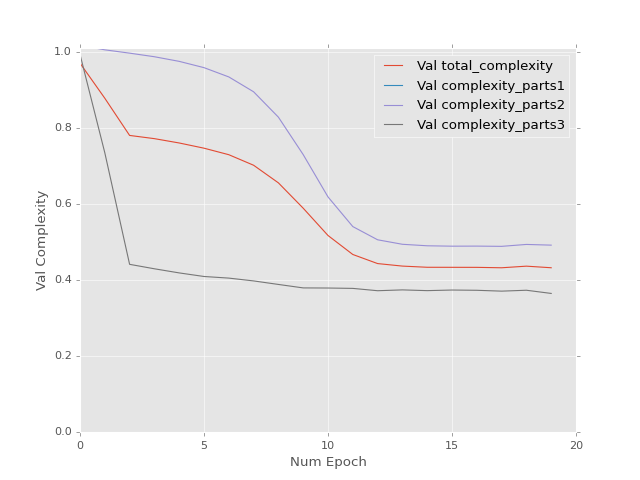

Epoch 1 of 20 took 6.124s
Epoch 2 of 20 took 6.021s
Epoch 3 of 20 took 6.099s
Epoch 4 of 20 took 5.971s
Epoch 5 of 20 took 5.817s
Epoch 6 of 20 took 5.812s
Epoch 7 of 20 took 5.771s
Epoch 8 of 20 took 6.104s
Epoch 9 of 20 took 6.082s
Epoch 10 of 20 took 5.958s
Epoch 11 of 20 took 6.103s
Epoch 12 of 20 took 5.630s
Epoch 13 of 20 took 5.826s
Epoch 14 of 20 took 6.200s
Epoch 15 of 20 took 5.817s
Epoch 16 of 20 took 5.775s
Epoch 17 of 20 took 5.917s
Epoch 18 of 20 took 5.882s
Epoch 19 of 20 took 5.889s
Epoch 20 of 20 took 5.601s


<IPython.core.display.Javascript object>


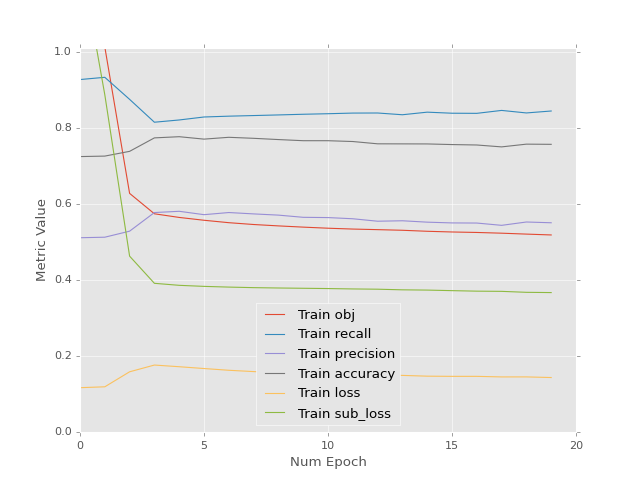

<IPython.core.display.Javascript object>


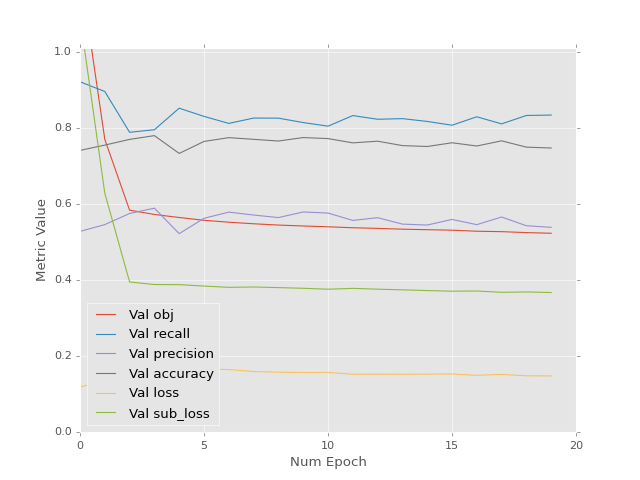

<IPython.core.display.Javascript object>


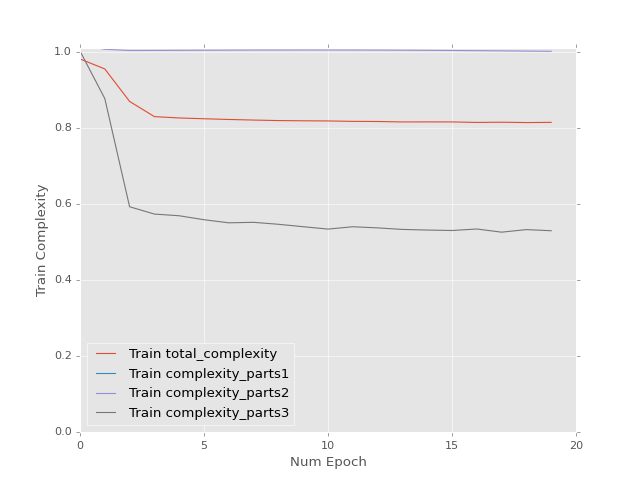

<IPython.core.display.Javascript object>


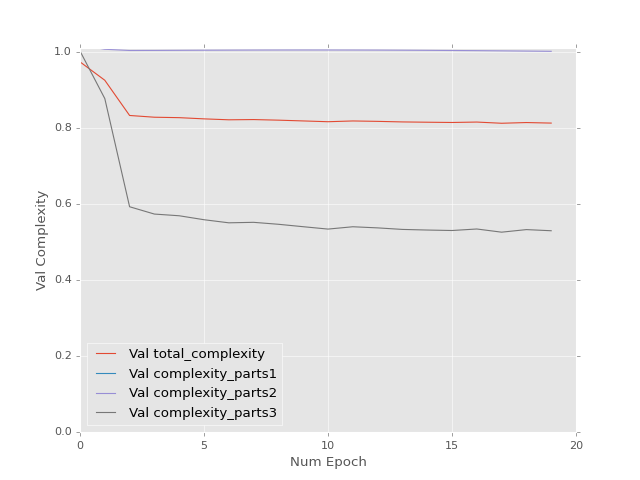

Epoch 1 of 20 took 5.944s
Epoch 2 of 20 took 5.923s
Epoch 3 of 20 took 5.585s
Epoch 4 of 20 took 6.229s
Epoch 5 of 20 took 6.006s
Epoch 6 of 20 took 6.109s
Epoch 7 of 20 took 5.951s
Epoch 8 of 20 took 6.050s
Epoch 9 of 20 took 5.803s
Epoch 10 of 20 took 6.087s
Epoch 11 of 20 took 6.158s
Epoch 12 of 20 took 6.332s
Epoch 13 of 20 took 6.225s
Epoch 14 of 20 took 6.167s
Epoch 15 of 20 took 6.264s
Epoch 16 of 20 took 5.850s
Epoch 17 of 20 took 6.058s
Epoch 18 of 20 took 6.027s
Epoch 19 of 20 took 5.882s
Epoch 20 of 20 took 6.339s


<IPython.core.display.Javascript object>


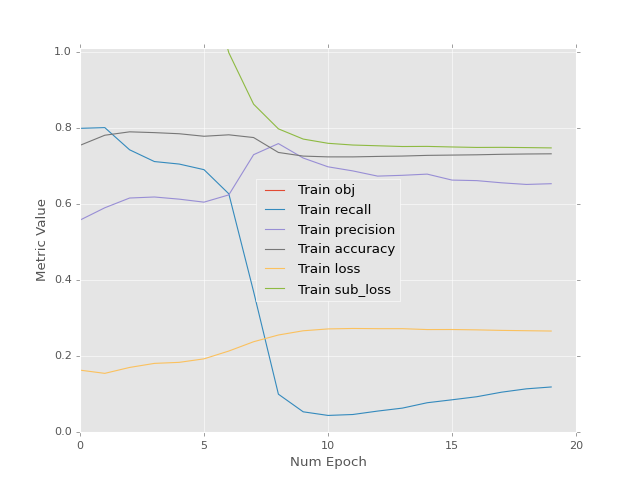

<IPython.core.display.Javascript object>


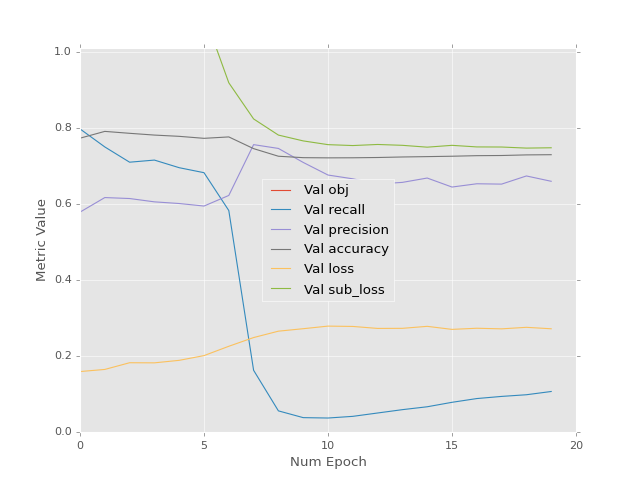

<IPython.core.display.Javascript object>


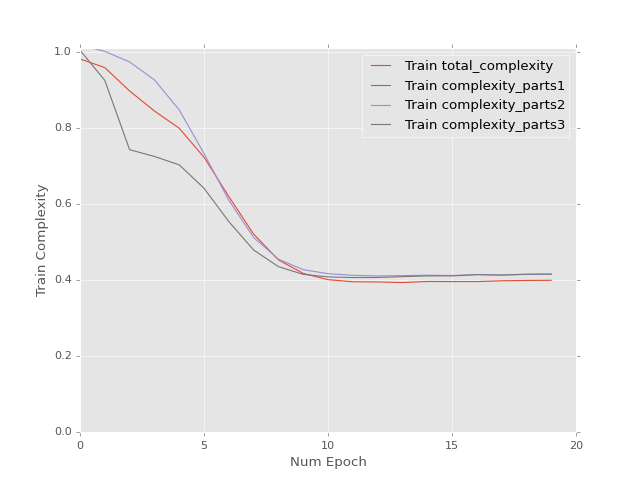

<IPython.core.display.Javascript object>


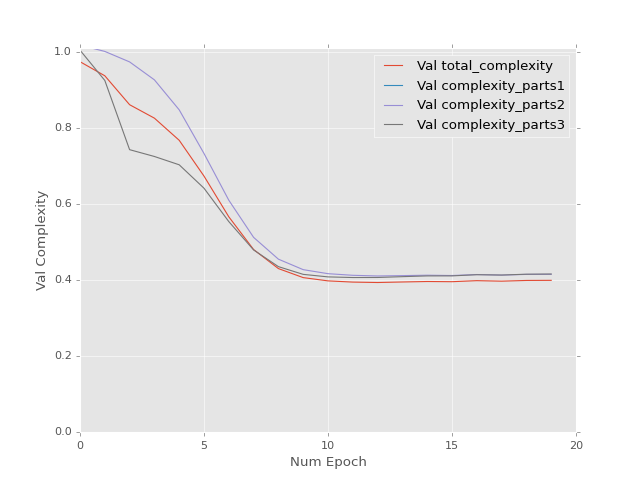

Epoch 1 of 20 took 5.814s
Epoch 2 of 20 took 6.231s
Epoch 3 of 20 took 5.726s
Epoch 4 of 20 took 6.222s
Epoch 5 of 20 took 6.232s
Epoch 6 of 20 took 5.956s
Epoch 7 of 20 took 5.853s
Epoch 8 of 20 took 6.131s
Epoch 9 of 20 took 6.225s
Epoch 10 of 20 took 5.740s
Epoch 11 of 20 took 5.766s
Epoch 12 of 20 took 5.998s
Epoch 13 of 20 took 6.085s
Epoch 14 of 20 took 6.003s
Epoch 15 of 20 took 5.951s
Epoch 16 of 20 took 5.849s
Epoch 17 of 20 took 5.943s
Epoch 18 of 20 took 5.868s
Epoch 19 of 20 took 6.266s
Epoch 20 of 20 took 5.878s


<IPython.core.display.Javascript object>


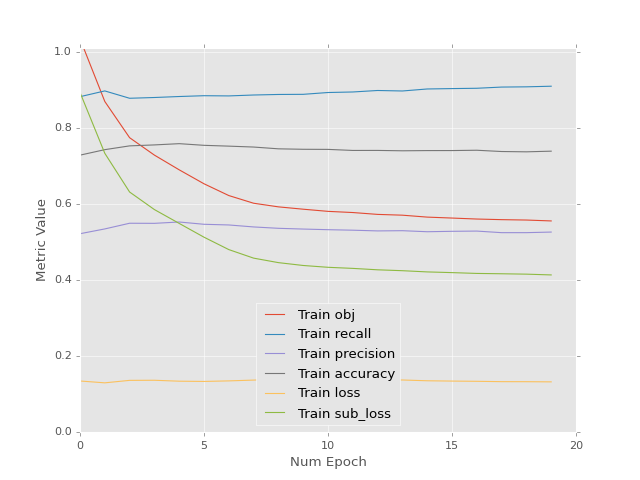

<IPython.core.display.Javascript object>


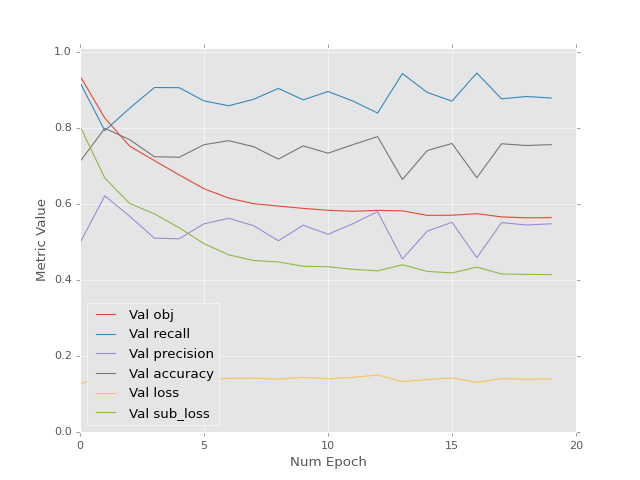

<IPython.core.display.Javascript object>


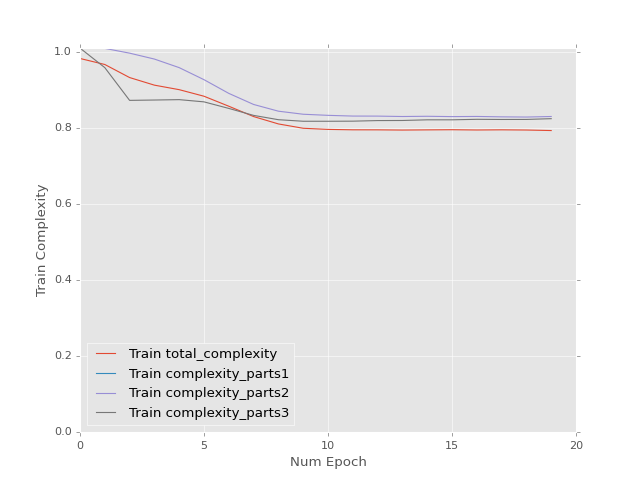

<IPython.core.display.Javascript object>


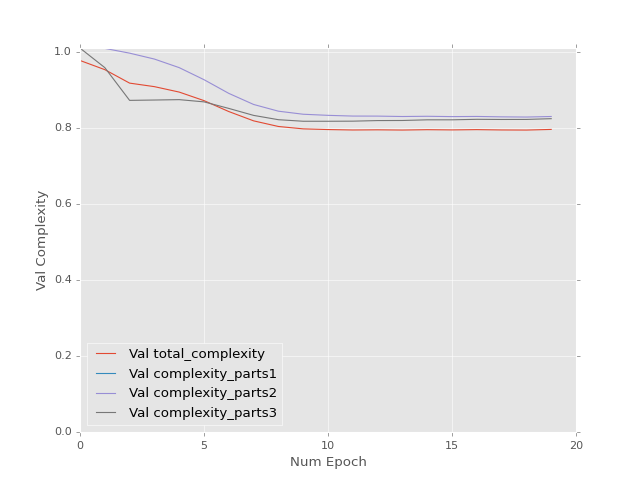

Epoch 1 of 20 took 5.975s
Epoch 2 of 20 took 5.983s
Epoch 3 of 20 took 5.893s
Epoch 4 of 20 took 5.860s
Epoch 5 of 20 took 5.864s
Epoch 6 of 20 took 5.834s
Epoch 7 of 20 took 6.066s
Epoch 8 of 20 took 5.806s
Epoch 9 of 20 took 6.218s
Epoch 10 of 20 took 6.213s
Epoch 11 of 20 took 6.285s
Epoch 12 of 20 took 5.716s
Epoch 13 of 20 took 5.921s
Epoch 14 of 20 took 5.925s
Epoch 15 of 20 took 5.819s
Epoch 16 of 20 took 6.188s
Epoch 17 of 20 took 6.192s
Epoch 18 of 20 took 5.614s
Epoch 19 of 20 took 5.940s
Epoch 20 of 20 took 6.056s


<IPython.core.display.Javascript object>


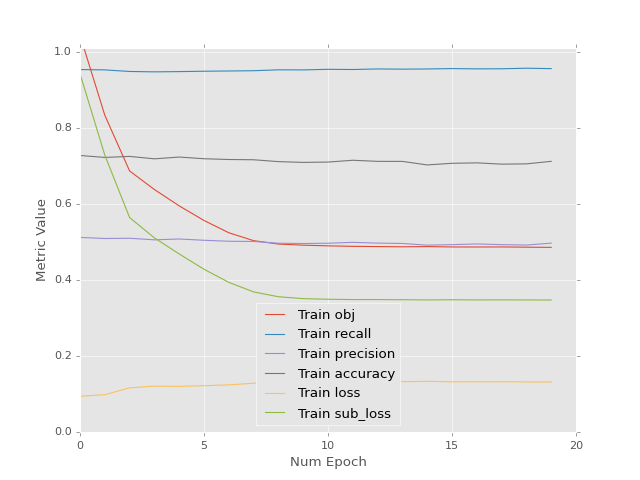

<IPython.core.display.Javascript object>


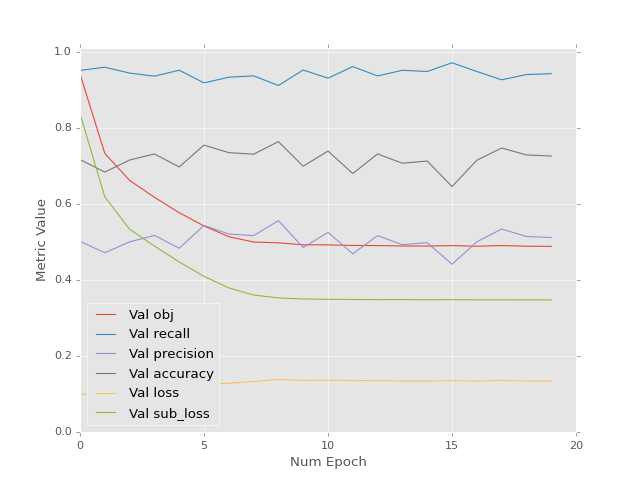

<IPython.core.display.Javascript object>


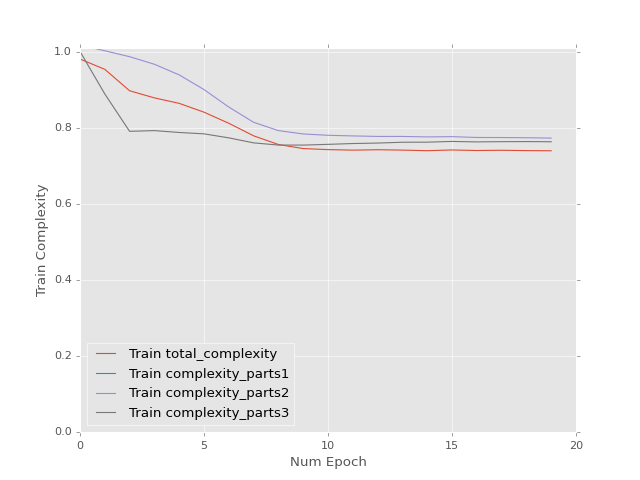

<IPython.core.display.Javascript object>


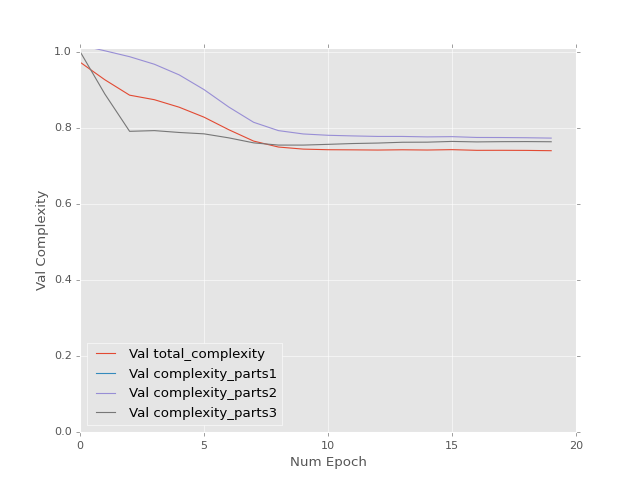

Epoch 1 of 20 took 5.827s
Epoch 2 of 20 took 5.658s
Epoch 3 of 20 took 5.601s
Epoch 4 of 20 took 6.148s
Epoch 5 of 20 took 6.096s
Epoch 6 of 20 took 5.782s
Epoch 7 of 20 took 5.894s
Epoch 8 of 20 took 6.101s
Epoch 9 of 20 took 5.788s
Epoch 10 of 20 took 5.928s
Epoch 11 of 20 took 5.759s
Epoch 12 of 20 took 5.911s
Epoch 13 of 20 took 5.834s
Epoch 14 of 20 took 5.962s
Epoch 15 of 20 took 6.001s
Epoch 16 of 20 took 6.244s
Epoch 17 of 20 took 6.235s
Epoch 18 of 20 took 6.000s
Epoch 19 of 20 took 6.221s
Epoch 20 of 20 took 6.261s


<IPython.core.display.Javascript object>


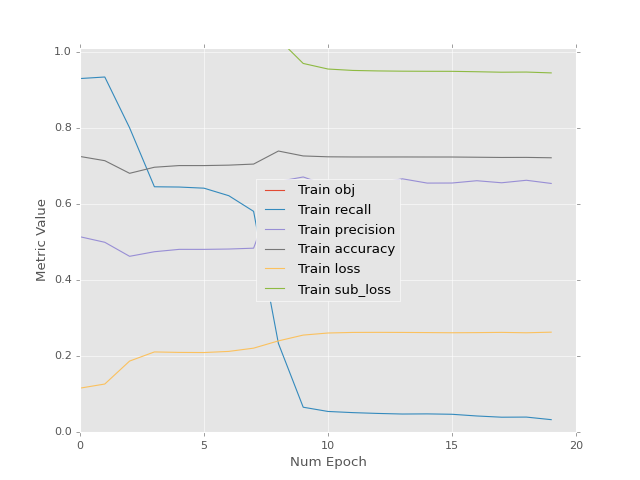

<IPython.core.display.Javascript object>


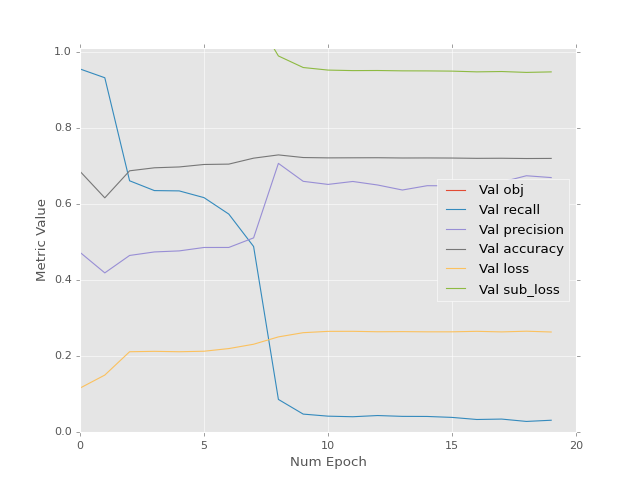

<IPython.core.display.Javascript object>


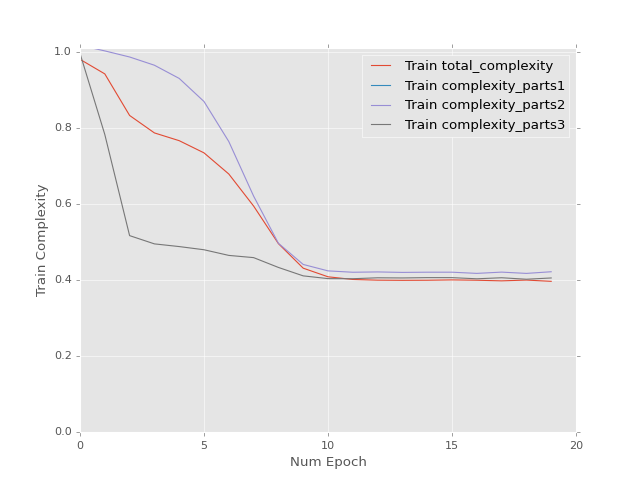

<IPython.core.display.Javascript object>


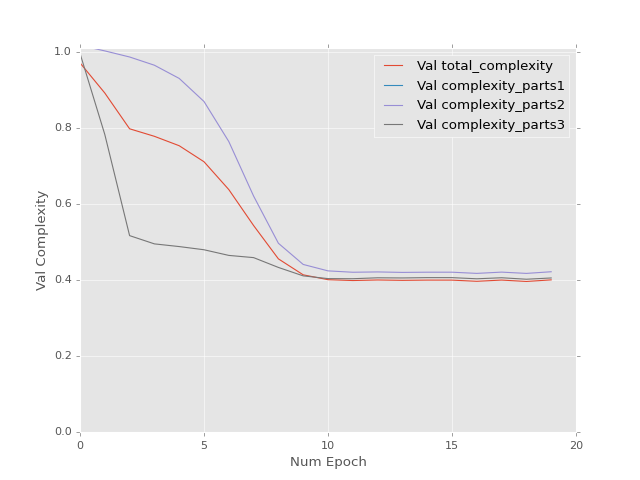

Epoch 1 of 20 took 5.816s
Epoch 2 of 20 took 6.067s
Epoch 3 of 20 took 5.997s
Epoch 4 of 20 took 5.990s
Epoch 5 of 20 took 6.150s
Epoch 6 of 20 took 5.957s
Epoch 7 of 20 took 5.680s
Epoch 8 of 20 took 6.031s
Epoch 9 of 20 took 5.880s
Epoch 10 of 20 took 5.678s
Epoch 11 of 20 took 6.211s
Epoch 12 of 20 took 5.899s
Epoch 13 of 20 took 5.739s
Epoch 14 of 20 took 5.898s
Epoch 15 of 20 took 6.176s
Epoch 16 of 20 took 6.079s
Epoch 17 of 20 took 6.033s
Epoch 18 of 20 took 6.040s
Epoch 19 of 20 took 6.187s
Epoch 20 of 20 took 5.853s


<IPython.core.display.Javascript object>


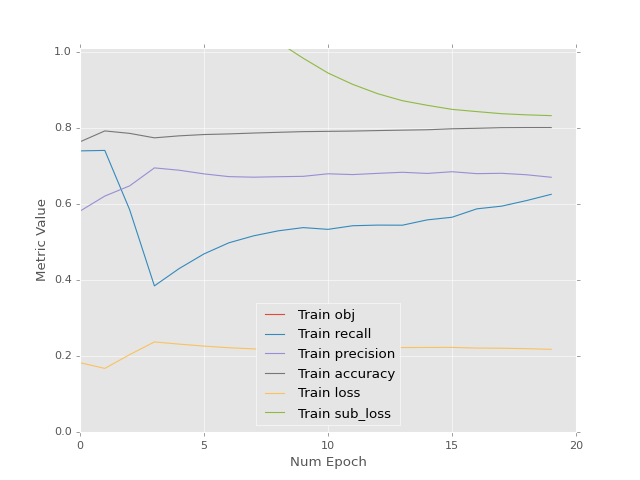

<IPython.core.display.Javascript object>


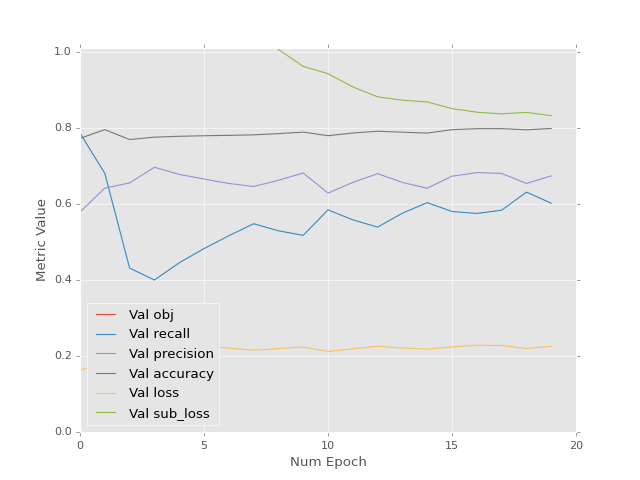

<IPython.core.display.Javascript object>


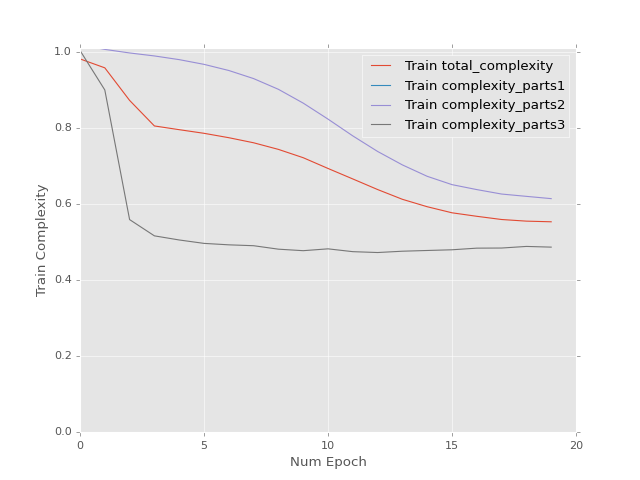

<IPython.core.display.Javascript object>


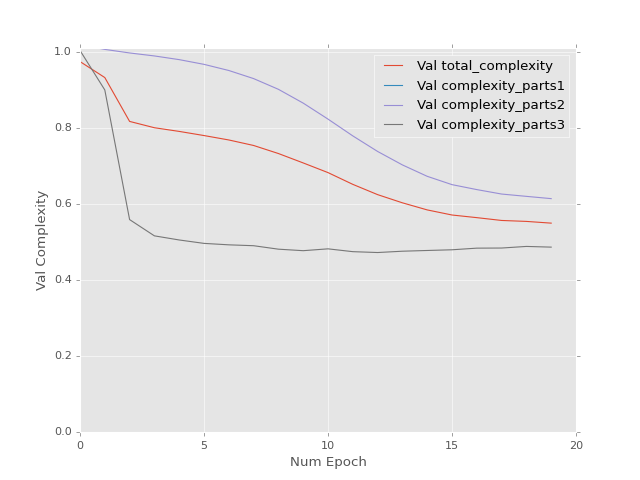

Epoch 1 of 20 took 5.972s
Epoch 2 of 20 took 6.012s
Epoch 3 of 20 took 6.006s
Epoch 4 of 20 took 6.058s
Epoch 5 of 20 took 6.103s
Epoch 6 of 20 took 6.206s
Epoch 7 of 20 took 6.383s
Epoch 8 of 20 took 5.917s
Epoch 9 of 20 took 5.698s
Epoch 10 of 20 took 5.985s
Epoch 11 of 20 took 6.024s
Epoch 12 of 20 took 5.996s
Epoch 13 of 20 took 6.055s
Epoch 14 of 20 took 5.849s
Epoch 15 of 20 took 5.990s
Epoch 16 of 20 took 6.045s
Epoch 17 of 20 took 6.125s
Epoch 18 of 20 took 6.187s
Epoch 19 of 20 took 6.102s
Epoch 20 of 20 took 5.971s


<IPython.core.display.Javascript object>


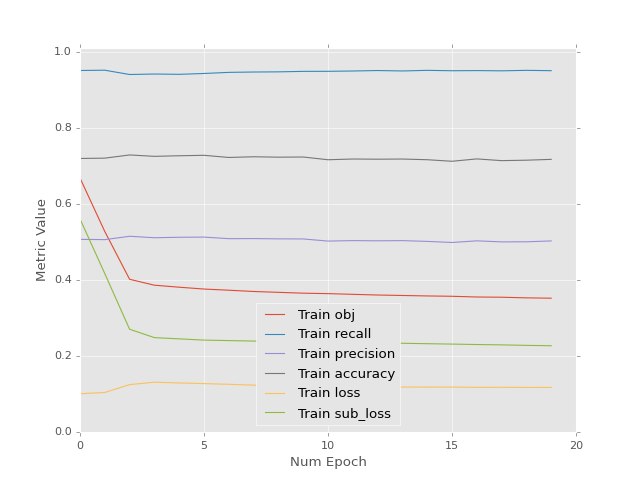

<IPython.core.display.Javascript object>


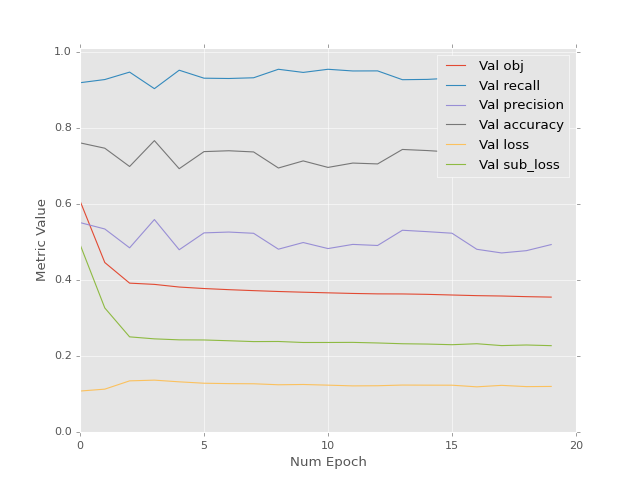

<IPython.core.display.Javascript object>


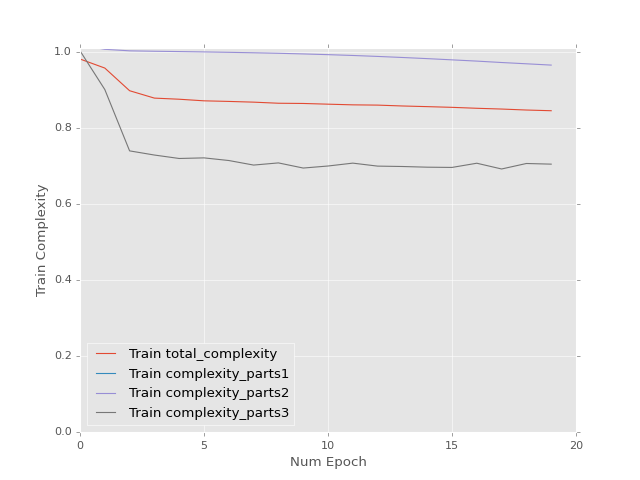

<IPython.core.display.Javascript object>


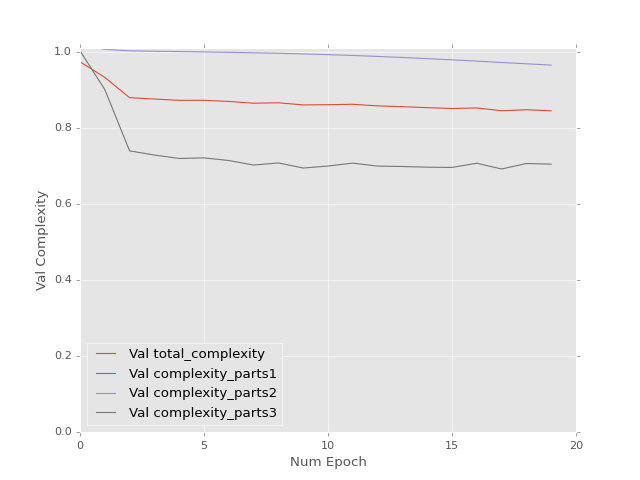

Epoch 1 of 20 took 6.388s
Epoch 2 of 20 took 6.114s
Epoch 3 of 20 took 6.031s
Epoch 4 of 20 took 6.077s
Epoch 5 of 20 took 5.838s
Epoch 6 of 20 took 5.811s
Epoch 7 of 20 took 5.974s
Epoch 8 of 20 took 6.095s
Epoch 9 of 20 took 6.262s
Epoch 10 of 20 took 6.172s
Epoch 11 of 20 took 6.017s
Epoch 12 of 20 took 6.132s
Epoch 13 of 20 took 6.083s
Epoch 14 of 20 took 6.031s
Epoch 15 of 20 took 6.021s
Epoch 16 of 20 took 5.969s
Epoch 17 of 20 took 5.781s
Epoch 18 of 20 took 5.919s
Epoch 19 of 20 took 5.964s
Epoch 20 of 20 took 6.093s


<IPython.core.display.Javascript object>


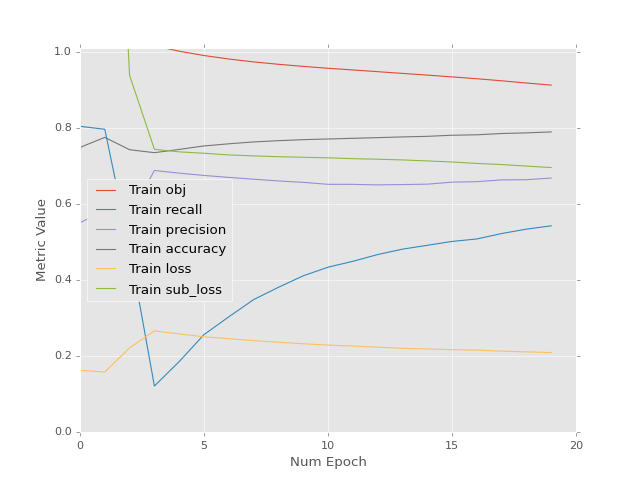

<IPython.core.display.Javascript object>


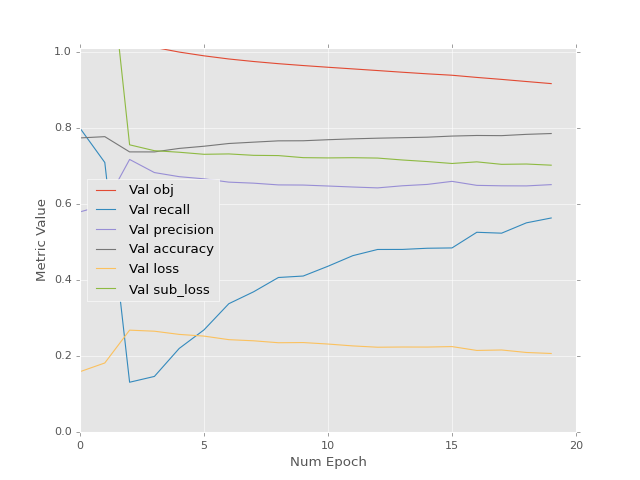

<IPython.core.display.Javascript object>


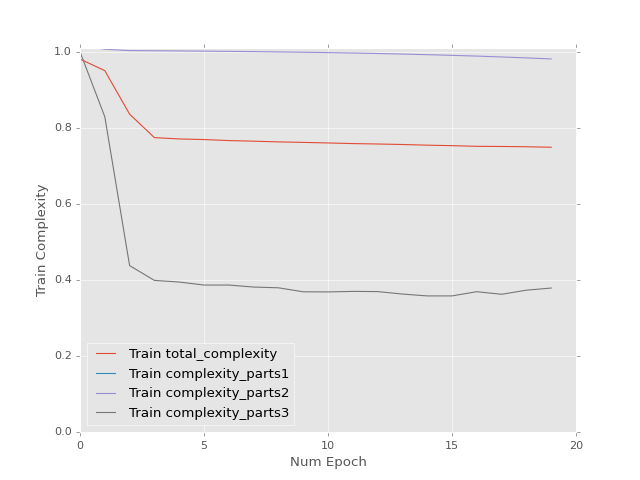

<IPython.core.display.Javascript object>


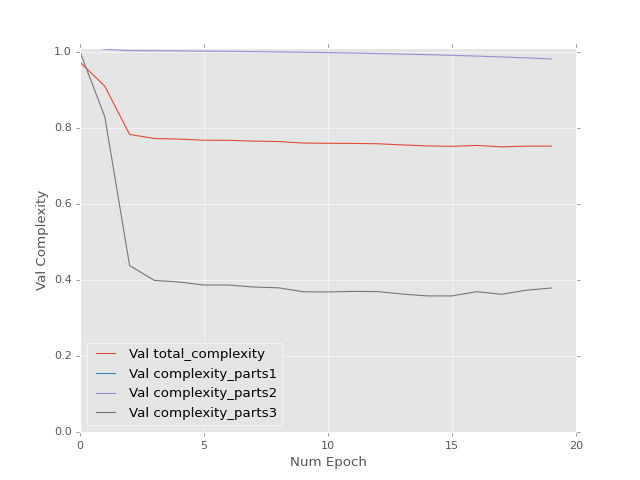

Epoch 1 of 20 took 6.281s
Epoch 2 of 20 took 6.163s
Epoch 3 of 20 took 5.890s
Epoch 4 of 20 took 5.835s
Epoch 5 of 20 took 5.846s
Epoch 6 of 20 took 6.048s
Epoch 7 of 20 took 5.777s
Epoch 8 of 20 took 6.243s
Epoch 9 of 20 took 5.974s
Epoch 10 of 20 took 5.757s
Epoch 11 of 20 took 5.888s
Epoch 12 of 20 took 6.135s
Epoch 13 of 20 took 6.148s
Epoch 14 of 20 took 6.346s
Epoch 15 of 20 took 5.703s
Epoch 16 of 20 took 6.143s
Epoch 17 of 20 took 6.001s
Epoch 18 of 20 took 6.251s
Epoch 19 of 20 took 6.255s
Epoch 20 of 20 took 6.110s


<IPython.core.display.Javascript object>


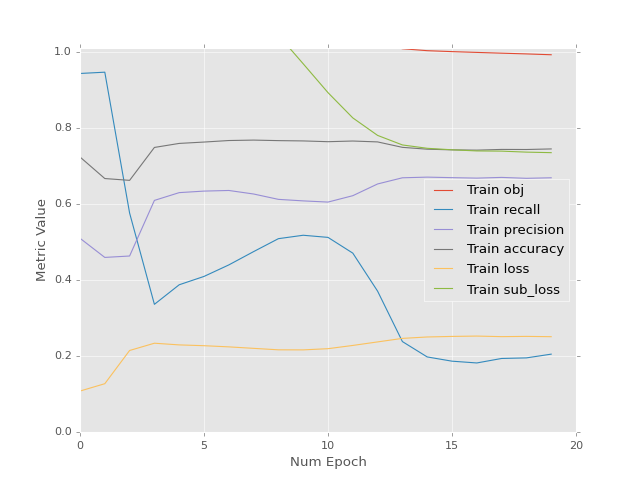

<IPython.core.display.Javascript object>


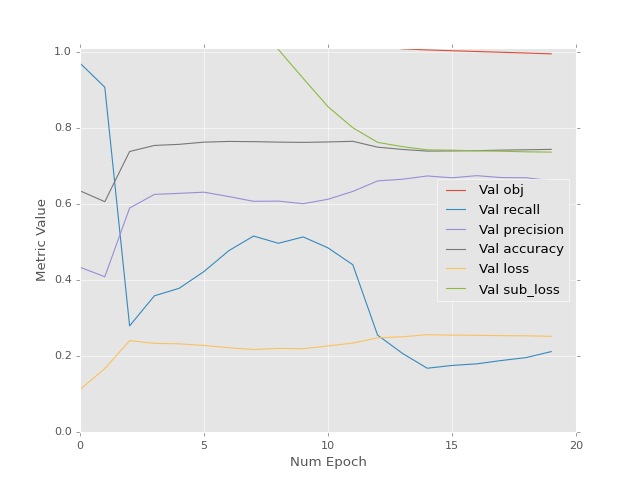

<IPython.core.display.Javascript object>


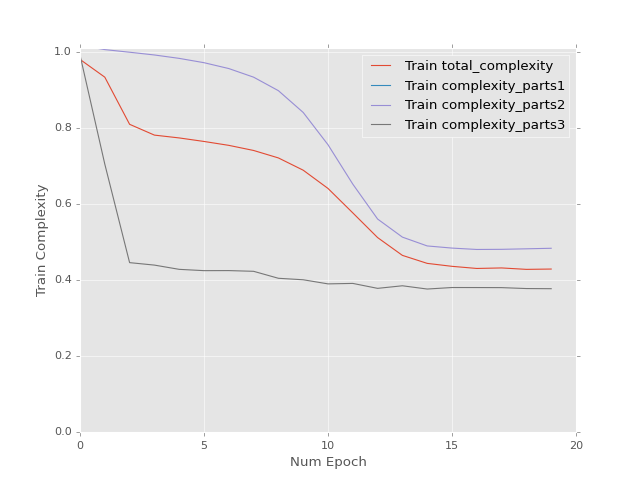

<IPython.core.display.Javascript object>


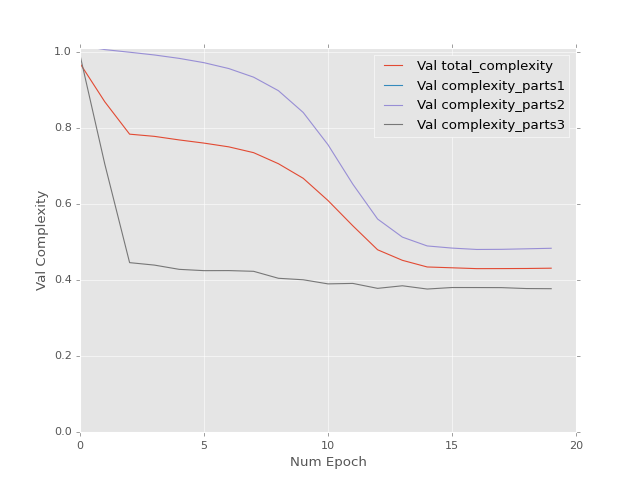

Epoch 1 of 20 took 5.724s
Epoch 2 of 20 took 5.832s
Epoch 3 of 20 took 6.077s
Epoch 4 of 20 took 5.660s
Epoch 5 of 20 took 5.989s
Epoch 6 of 20 took 6.225s
Epoch 7 of 20 took 6.365s
Epoch 8 of 20 took 5.972s
Epoch 9 of 20 took 6.170s
Epoch 10 of 20 took 5.764s
Epoch 11 of 20 took 5.855s
Epoch 12 of 20 took 6.068s
Epoch 13 of 20 took 5.571s
Epoch 14 of 20 took 5.841s
Epoch 15 of 20 took 6.098s
Epoch 16 of 20 took 5.827s
Epoch 17 of 20 took 6.112s
Epoch 18 of 20 took 6.194s
Epoch 19 of 20 took 6.003s
Epoch 20 of 20 took 5.830s


<IPython.core.display.Javascript object>


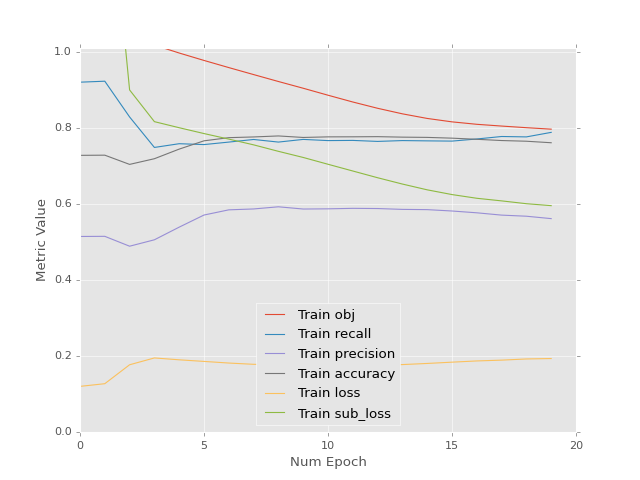

<IPython.core.display.Javascript object>


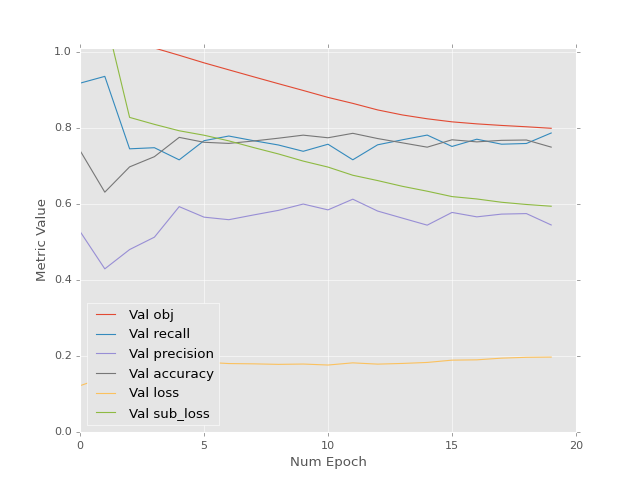

<IPython.core.display.Javascript object>


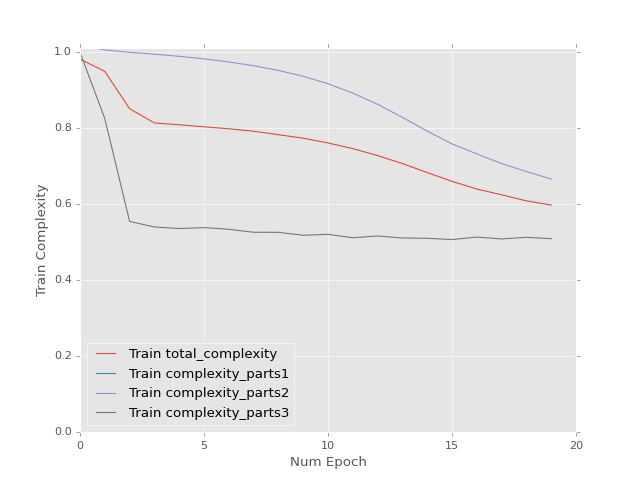

<IPython.core.display.Javascript object>


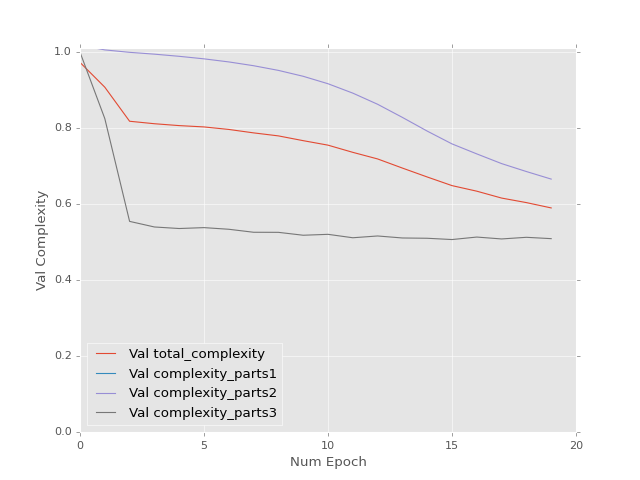

Epoch 1 of 20 took 5.837s
Epoch 2 of 20 took 5.864s
Epoch 3 of 20 took 6.103s
Epoch 4 of 20 took 5.914s
Epoch 5 of 20 took 6.214s
Epoch 6 of 20 took 5.801s
Epoch 7 of 20 took 5.767s
Epoch 8 of 20 took 5.658s
Epoch 9 of 20 took 5.912s
Epoch 10 of 20 took 5.827s
Epoch 11 of 20 took 6.100s
Epoch 12 of 20 took 6.183s
Epoch 13 of 20 took 5.581s
Epoch 14 of 20 took 5.784s
Epoch 15 of 20 took 5.871s
Epoch 16 of 20 took 6.234s
Epoch 17 of 20 took 6.257s
Epoch 18 of 20 took 5.741s
Epoch 19 of 20 took 6.076s
Epoch 20 of 20 took 6.114s


<IPython.core.display.Javascript object>


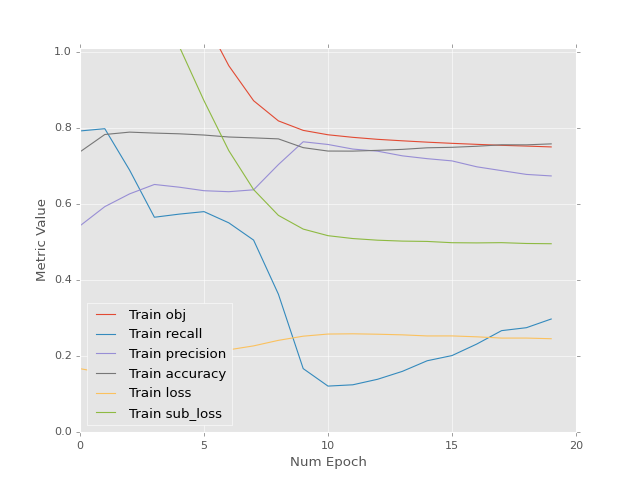

<IPython.core.display.Javascript object>


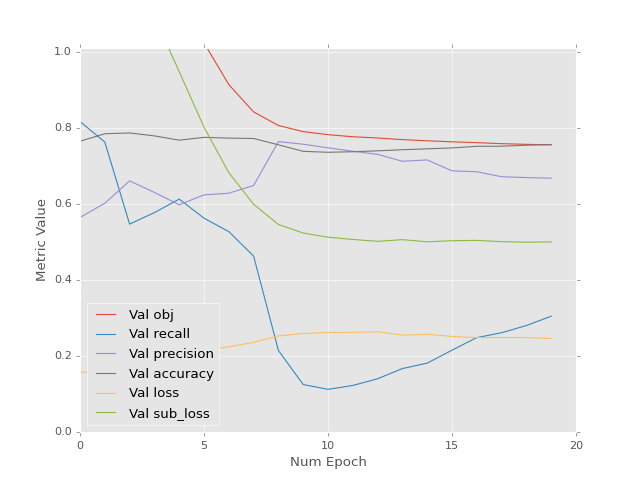

<IPython.core.display.Javascript object>


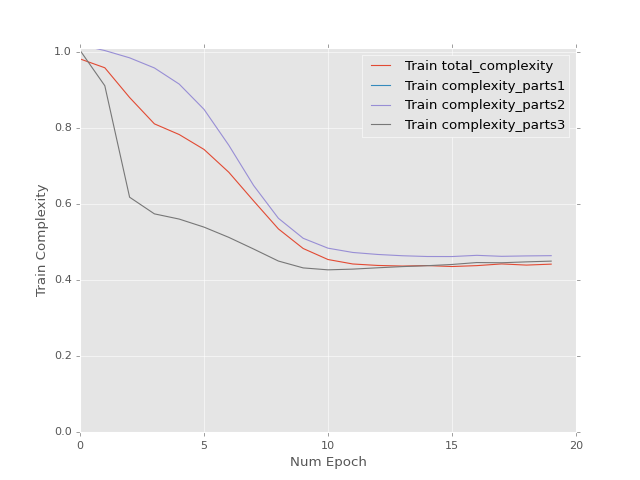

<IPython.core.display.Javascript object>


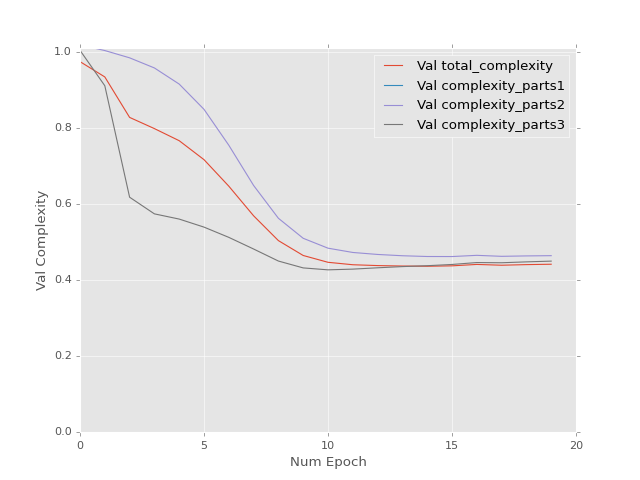

Epoch 1 of 20 took 5.807s
Epoch 2 of 20 took 5.758s
Epoch 3 of 20 took 5.594s
Epoch 4 of 20 took 5.975s
Epoch 5 of 20 took 5.774s
Epoch 6 of 20 took 5.593s
Epoch 7 of 20 took 5.876s
Epoch 8 of 20 took 5.798s
Epoch 9 of 20 took 5.800s
Epoch 10 of 20 took 5.884s
Epoch 11 of 20 took 5.592s
Epoch 12 of 20 took 5.944s
Epoch 13 of 20 took 6.063s
Epoch 14 of 20 took 5.614s
Epoch 15 of 20 took 6.017s
Epoch 16 of 20 took 6.198s
Epoch 17 of 20 took 6.134s
Epoch 18 of 20 took 5.673s
Epoch 19 of 20 took 5.913s
Epoch 20 of 20 took 6.335s


<IPython.core.display.Javascript object>


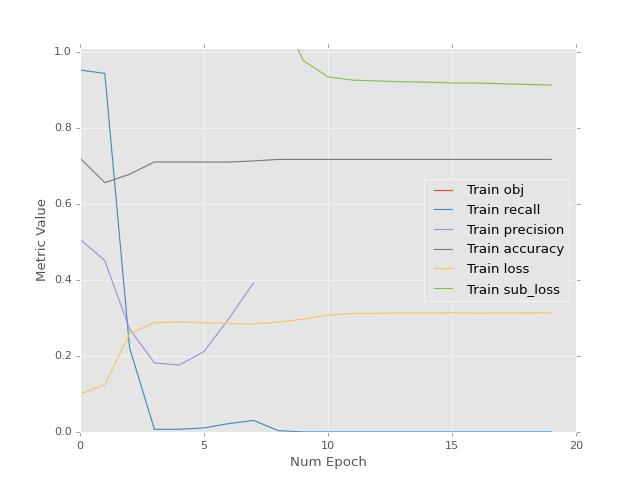

<IPython.core.display.Javascript object>


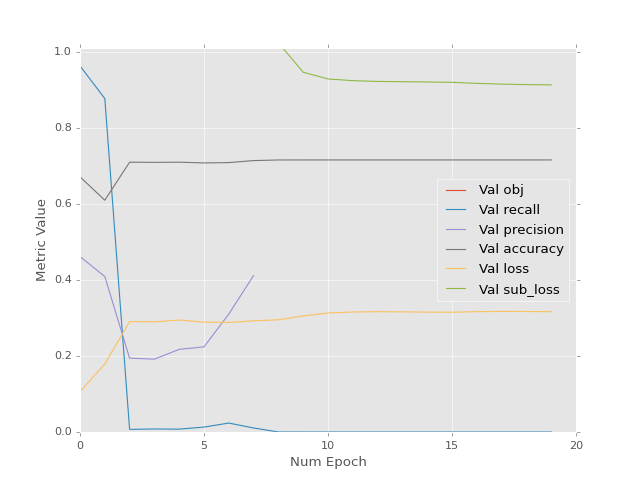

<IPython.core.display.Javascript object>


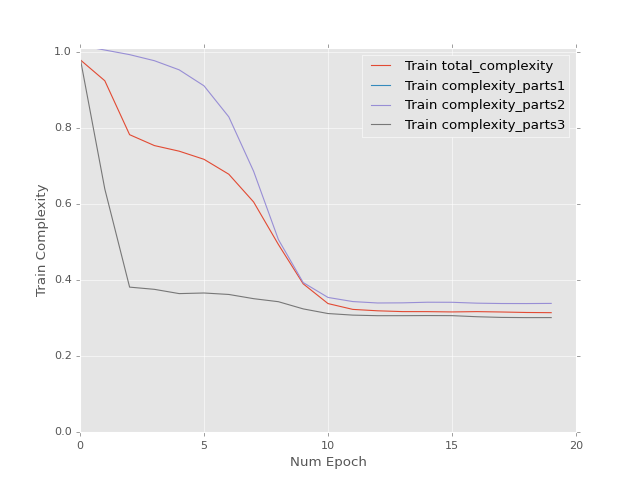

<IPython.core.display.Javascript object>


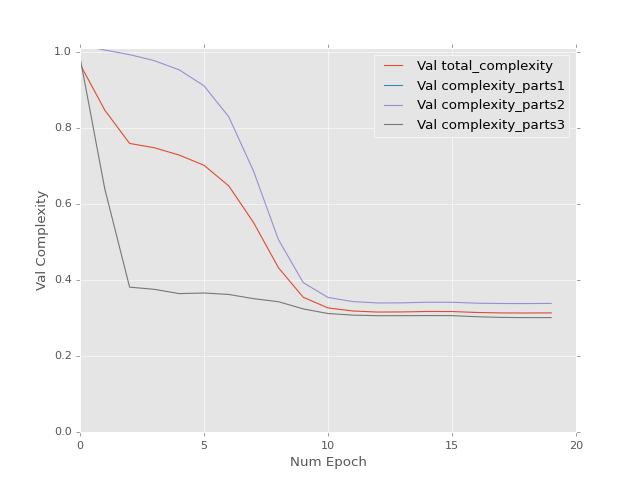

Epoch 1 of 20 took 5.904s
Epoch 2 of 20 took 5.680s
Epoch 3 of 20 took 5.610s
Epoch 4 of 20 took 6.112s
Epoch 5 of 20 took 6.104s
Epoch 6 of 20 took 5.993s
Epoch 7 of 20 took 6.386s
Epoch 8 of 20 took 5.820s
Epoch 9 of 20 took 6.110s
Epoch 10 of 20 took 5.590s
Epoch 11 of 20 took 6.106s
Epoch 12 of 20 took 6.218s
Epoch 13 of 20 took 5.954s
Epoch 14 of 20 took 6.272s
Epoch 15 of 20 took 6.190s
Epoch 16 of 20 took 5.865s
Epoch 17 of 20 took 5.667s
Epoch 18 of 20 took 5.857s
Epoch 19 of 20 took 5.597s
Epoch 20 of 20 took 5.853s


<IPython.core.display.Javascript object>


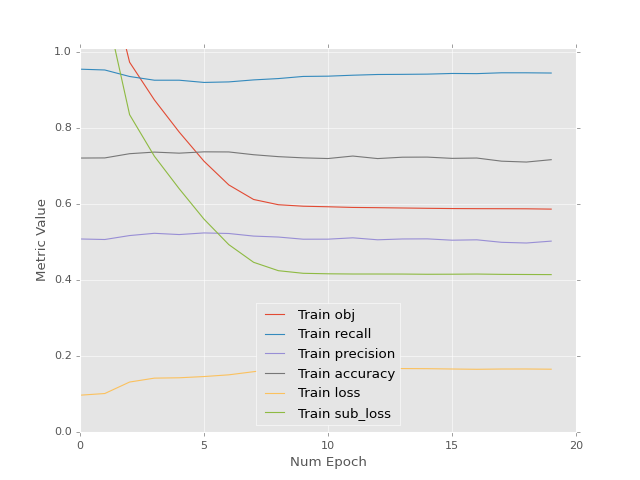

<IPython.core.display.Javascript object>


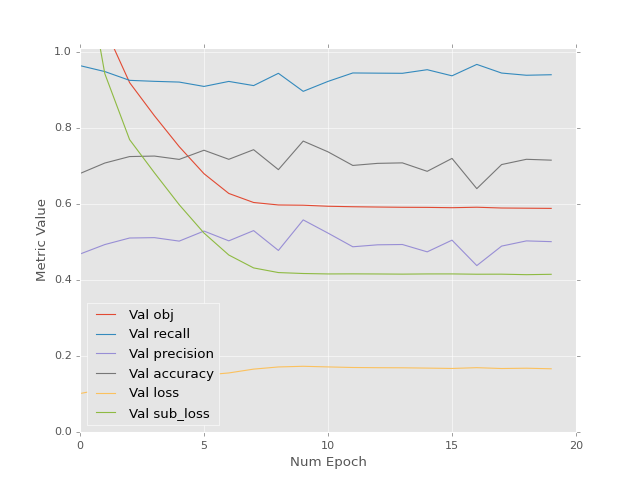

<IPython.core.display.Javascript object>


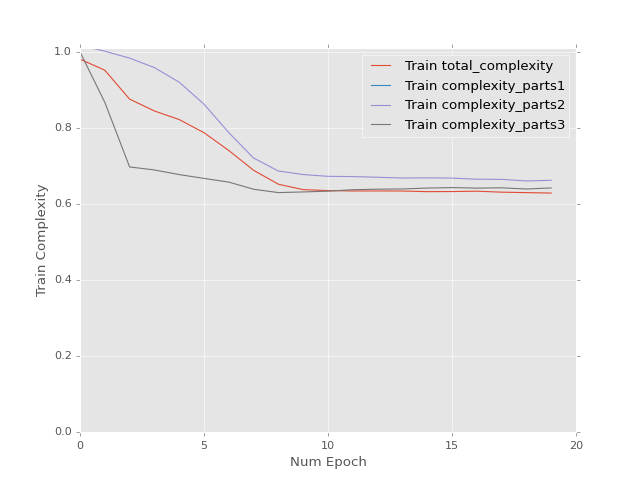

<IPython.core.display.Javascript object>


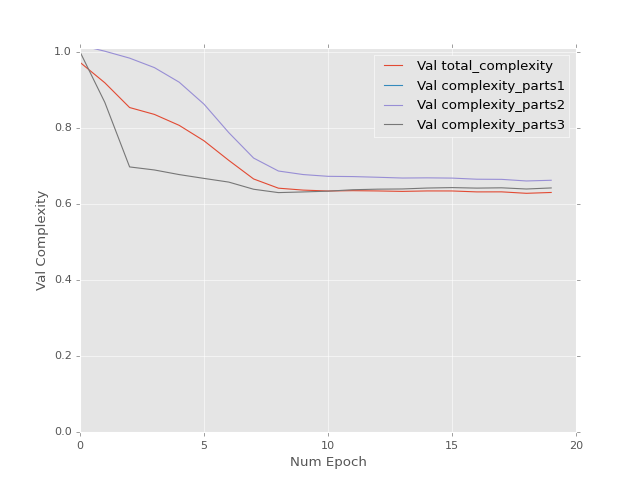

Epoch 1 of 20 took 5.960s
Epoch 2 of 20 took 5.897s
Epoch 3 of 20 took 6.068s
Epoch 4 of 20 took 6.370s
Epoch 5 of 20 took 5.674s
Epoch 6 of 20 took 5.815s
Epoch 7 of 20 took 5.849s
Epoch 8 of 20 took 6.184s
Epoch 9 of 20 took 5.599s
Epoch 10 of 20 took 5.885s
Epoch 11 of 20 took 5.780s
Epoch 12 of 20 took 5.600s
Epoch 13 of 20 took 5.811s
Epoch 14 of 20 took 6.084s
Epoch 15 of 20 took 5.884s
Epoch 16 of 20 took 6.271s
Epoch 17 of 20 took 5.894s
Epoch 18 of 20 took 6.114s
Epoch 19 of 20 took 5.708s
Epoch 20 of 20 took 6.010s


<IPython.core.display.Javascript object>


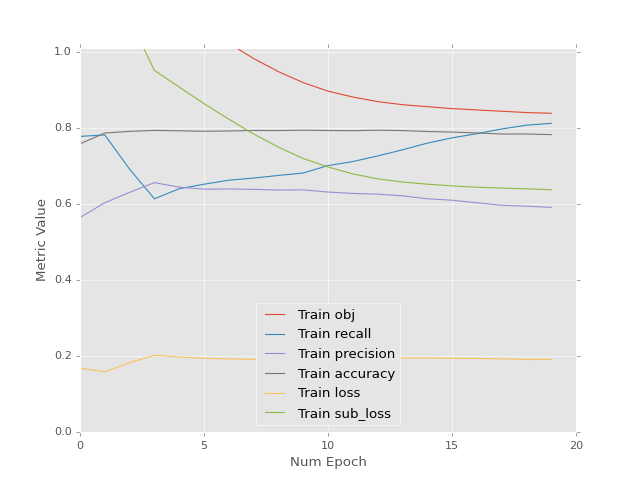

<IPython.core.display.Javascript object>


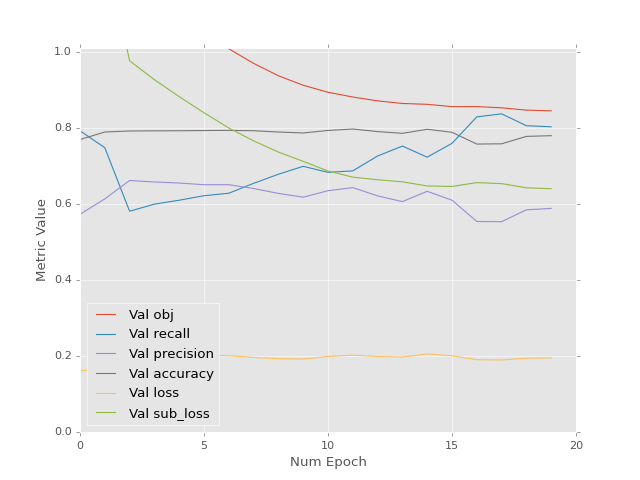

<IPython.core.display.Javascript object>


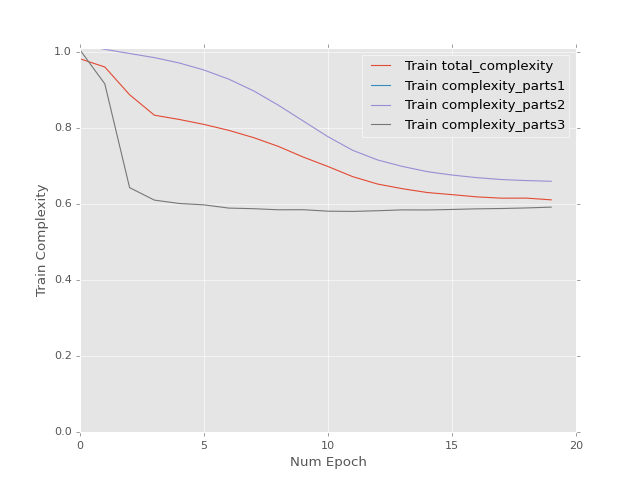

<IPython.core.display.Javascript object>


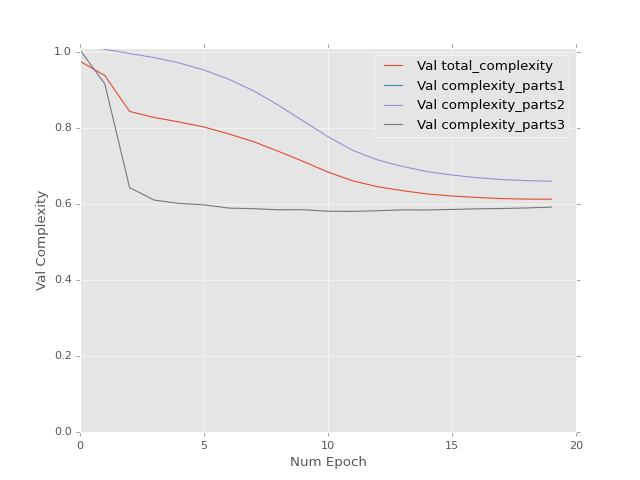

Epoch 1 of 20 took 5.846s
Epoch 2 of 20 took 5.874s
Epoch 3 of 20 took 6.195s
Epoch 4 of 20 took 6.046s
Epoch 5 of 20 took 6.150s
Epoch 6 of 20 took 5.750s
Epoch 7 of 20 took 6.089s
Epoch 8 of 20 took 6.127s
Epoch 9 of 20 took 5.826s
Epoch 10 of 20 took 5.708s
Epoch 11 of 20 took 6.014s
Epoch 12 of 20 took 5.673s
Epoch 13 of 20 took 6.346s
Epoch 14 of 20 took 6.237s
Epoch 15 of 20 took 6.320s
Epoch 16 of 20 took 6.567s
Epoch 17 of 20 took 5.909s
Epoch 18 of 20 took 6.156s
Epoch 19 of 20 took 6.041s
Epoch 20 of 20 took 5.799s


<IPython.core.display.Javascript object>


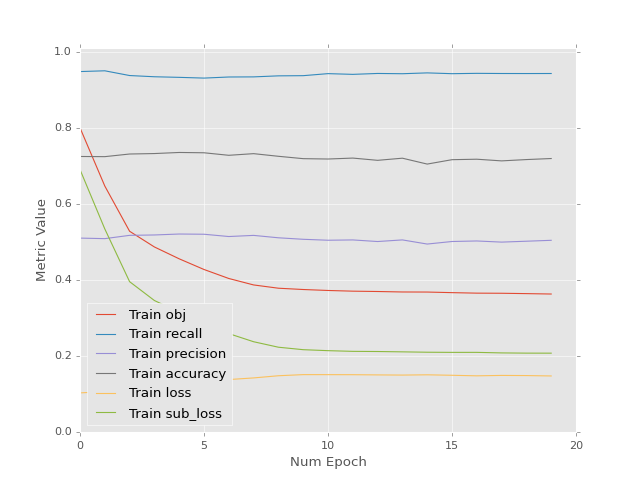

<IPython.core.display.Javascript object>


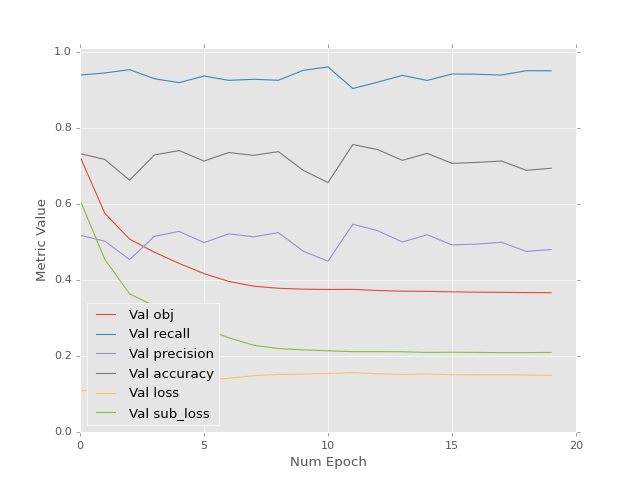

<IPython.core.display.Javascript object>


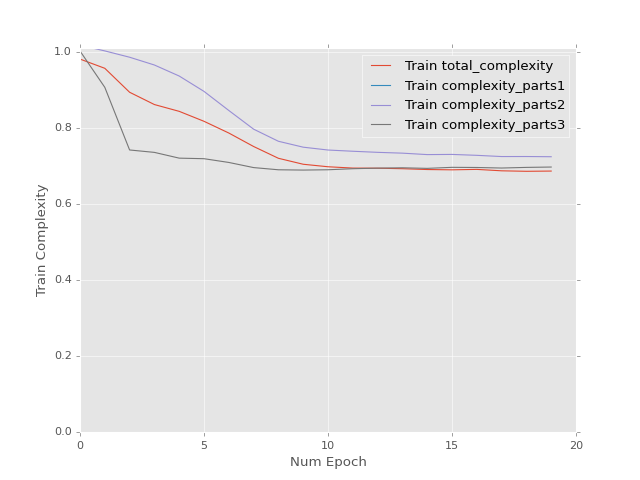

<IPython.core.display.Javascript object>


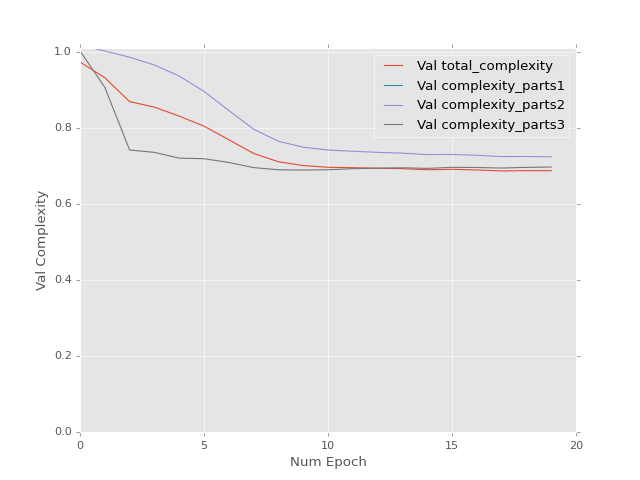

Epoch 1 of 20 took 6.207s
Epoch 2 of 20 took 5.861s
Epoch 3 of 20 took 5.820s
Epoch 4 of 20 took 5.842s
Epoch 5 of 20 took 5.897s
Epoch 6 of 20 took 6.046s
Epoch 7 of 20 took 5.628s
Epoch 8 of 20 took 5.811s
Epoch 9 of 20 took 5.830s
Epoch 10 of 20 took 6.079s
Epoch 11 of 20 took 6.107s
Epoch 12 of 20 took 5.843s
Epoch 13 of 20 took 6.216s
Epoch 14 of 20 took 5.929s
Epoch 15 of 20 took 6.063s
Epoch 16 of 20 took 5.867s
Epoch 17 of 20 took 6.066s
Epoch 18 of 20 took 5.810s
Epoch 19 of 20 took 5.826s
Epoch 20 of 20 took 5.913s


<IPython.core.display.Javascript object>


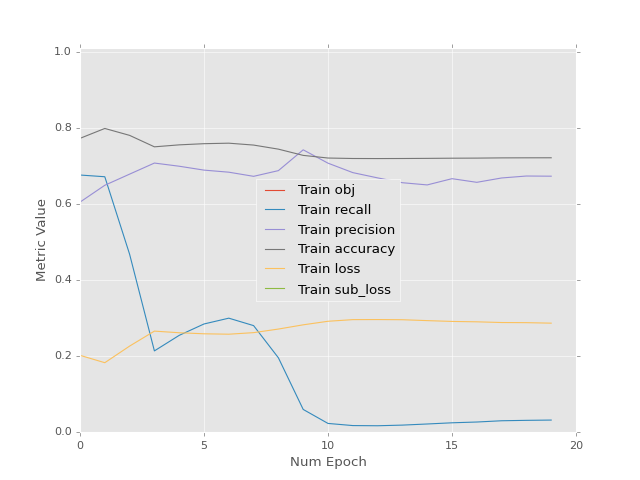

<IPython.core.display.Javascript object>


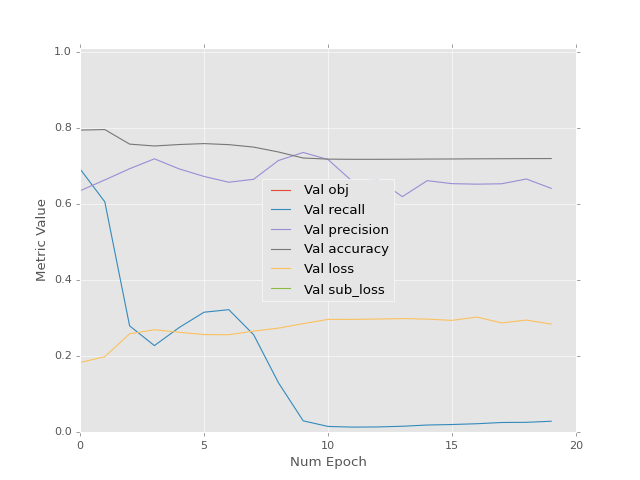

<IPython.core.display.Javascript object>


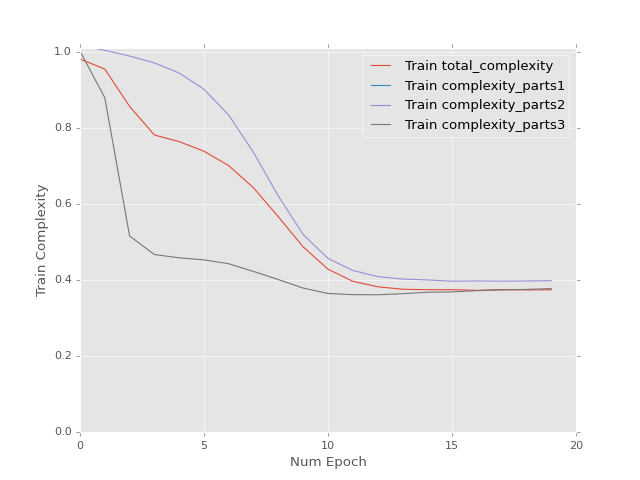

<IPython.core.display.Javascript object>


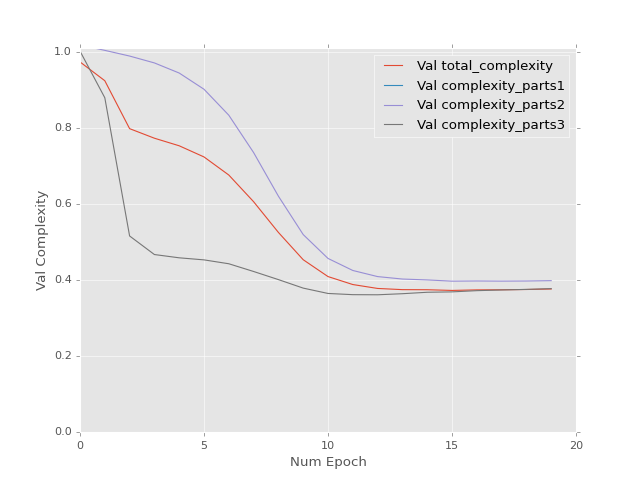

Epoch 1 of 20 took 5.916s
Epoch 2 of 20 took 5.617s
Epoch 3 of 20 took 6.175s
Epoch 4 of 20 took 6.135s
Epoch 5 of 20 took 5.962s
Epoch 6 of 20 took 6.195s
Epoch 7 of 20 took 6.028s
Epoch 8 of 20 took 6.104s
Epoch 9 of 20 took 6.101s
Epoch 10 of 20 took 6.059s
Epoch 11 of 20 took 5.922s
Epoch 12 of 20 took 6.141s
Epoch 13 of 20 took 6.089s
Epoch 14 of 20 took 6.167s
Epoch 15 of 20 took 5.964s
Epoch 16 of 20 took 6.277s
Epoch 17 of 20 took 6.217s
Epoch 18 of 20 took 6.005s
Epoch 19 of 20 took 6.233s
Epoch 20 of 20 took 5.813s


<IPython.core.display.Javascript object>


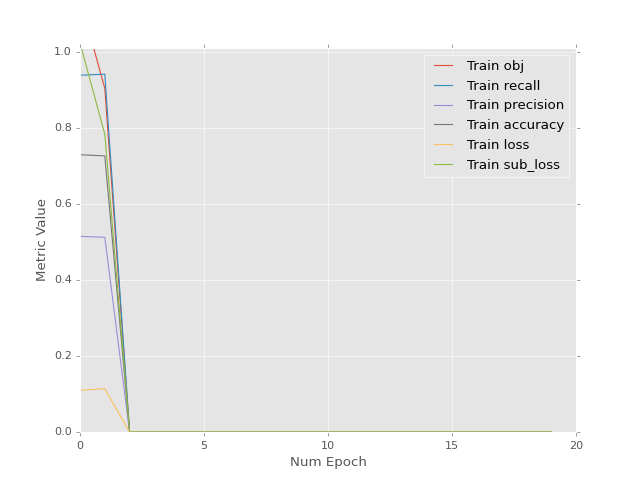

<IPython.core.display.Javascript object>


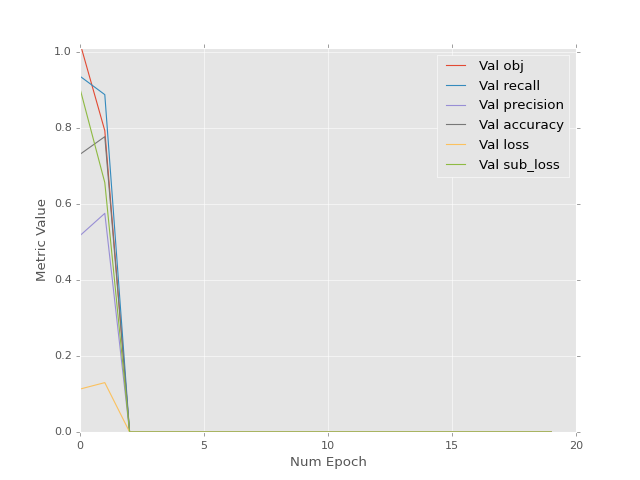

<IPython.core.display.Javascript object>


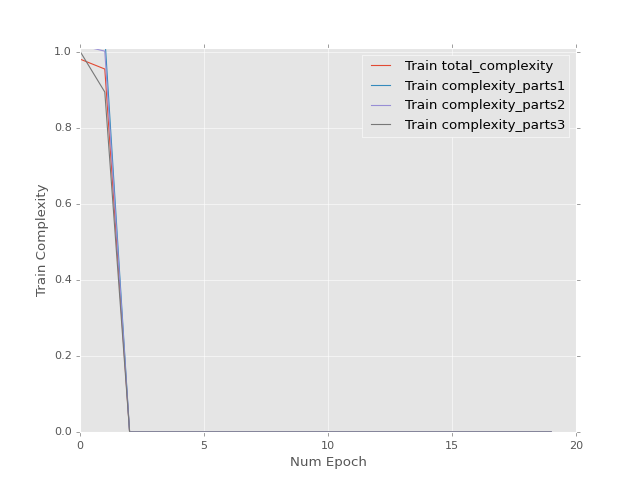

<IPython.core.display.Javascript object>


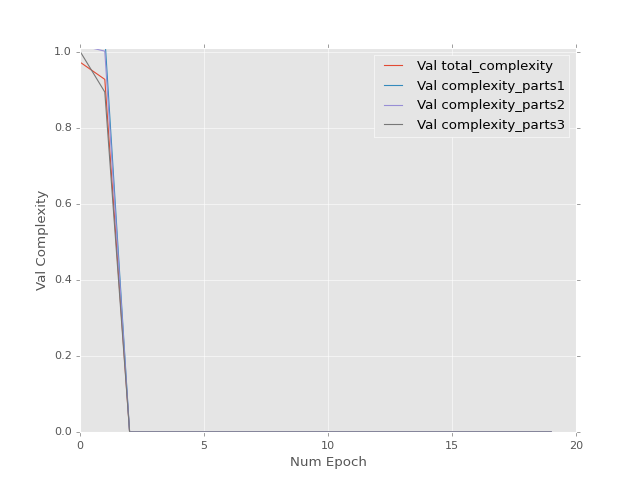

Epoch 1 of 20 took 6.186s
Epoch 2 of 20 took 6.223s


In [ ]:
while True:
    network.load('../weights', 'digits_pretrained')
    
    for j in range(len(shareds)):
        network.opt_shareds[j].set_value(shareds[j])
    
    point = np.random.random(6)
    network.c_sub_objs.set_value(point[:3])
    network.c_sub_obj_cs.set_value(point[3:])

    learn(network,
          X_y,
          watches=['obj',
                   'recall',
                   'precision',
                   'accuracy',
                   'loss',
                   'sub_loss',
                   'total_complexity',
                   'complexity_parts'],
          num_epochs=20,
          batch_size=50)

    network.save('../weights/digits', ','.join([str(i) for i in point]))

In [ ]:
dataset.shape